<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_7_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(7):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 32.7964 - IoU: 0.0670
Epoch 1: val_IoU improved from -inf to 0.00000, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 45ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


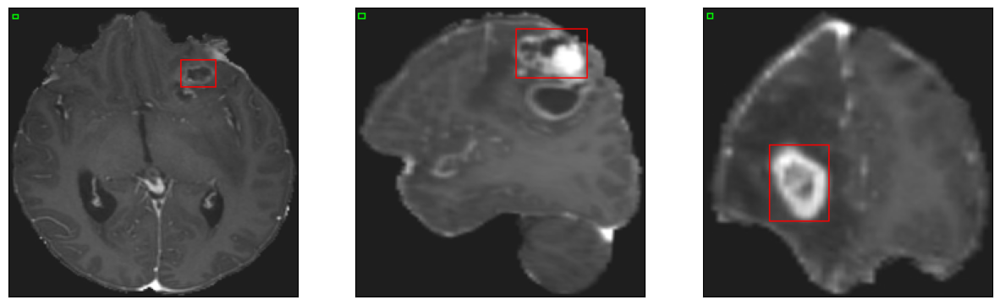

26/26 [==============================] - 21s 248ms/step - loss: 32.7964 - IoU: 0.0670 - val_loss: 70.8175 - val_IoU: 0.0000e+00
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 23.0207 - IoU: 0.1012
Epoch 2: val_IoU did not improve from 0.00000
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


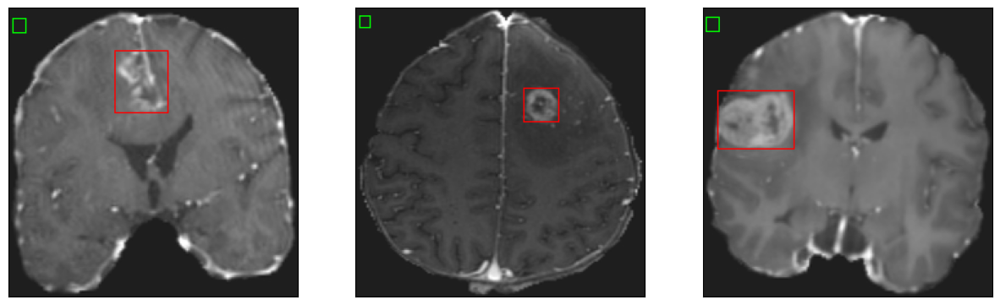

26/26 [==============================] - 2s 87ms/step - loss: 22.9569 - IoU: 0.1001 - val_loss: 66.5613 - val_IoU: 0.0000e+00
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 18.0827 - IoU: 0.1918
Epoch 3: val_IoU did not improve from 0.00000
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


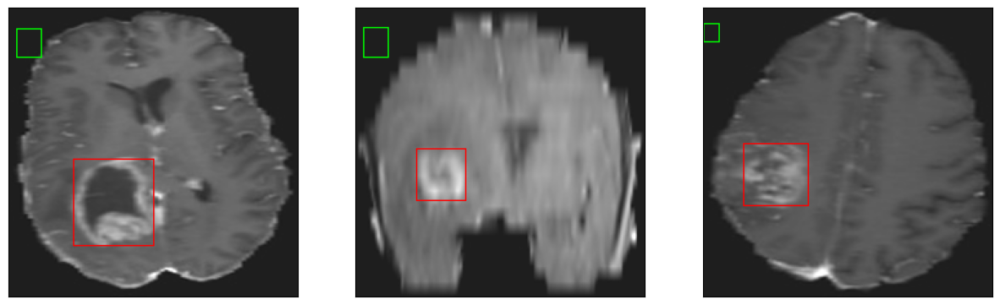

26/26 [==============================] - 2s 86ms/step - loss: 18.0298 - IoU: 0.1945 - val_loss: 57.1231 - val_IoU: 0.0000e+00
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 14.9566 - IoU: 0.2708
Epoch 4: val_IoU did not improve from 0.00000
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4


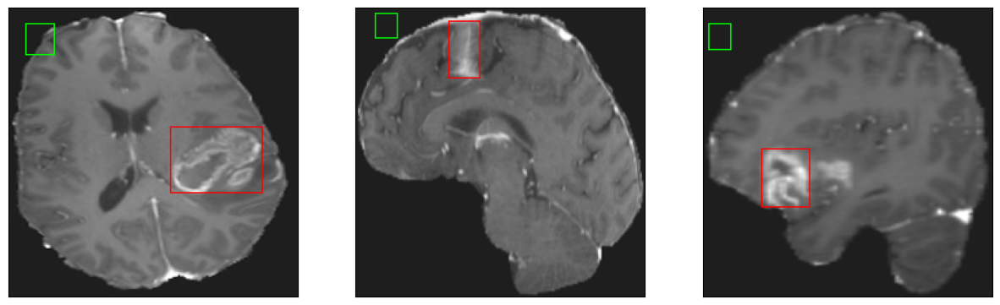

26/26 [==============================] - 2s 97ms/step - loss: 14.8604 - IoU: 0.2722 - val_loss: 56.4117 - val_IoU: 0.0000e+00
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 13.1272 - IoU: 0.3262
Epoch 5: val_IoU improved from 0.00000 to 0.00160, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


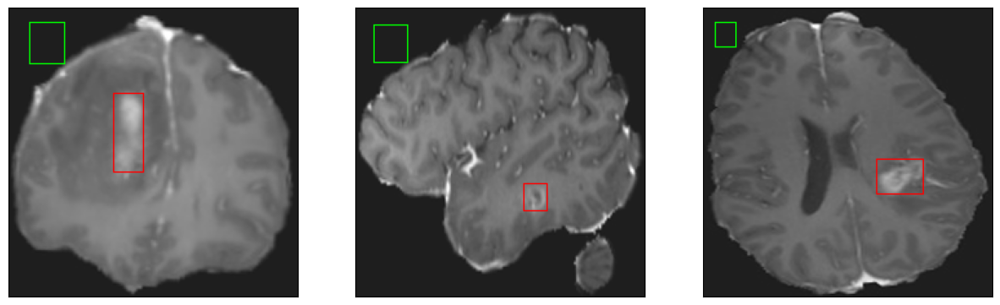

26/26 [==============================] - 5s 180ms/step - loss: 13.1272 - IoU: 0.3262 - val_loss: 48.0024 - val_IoU: 0.0016
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 11.9959 - IoU: 0.3473
Epoch 6: val_IoU did not improve from 0.00160
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


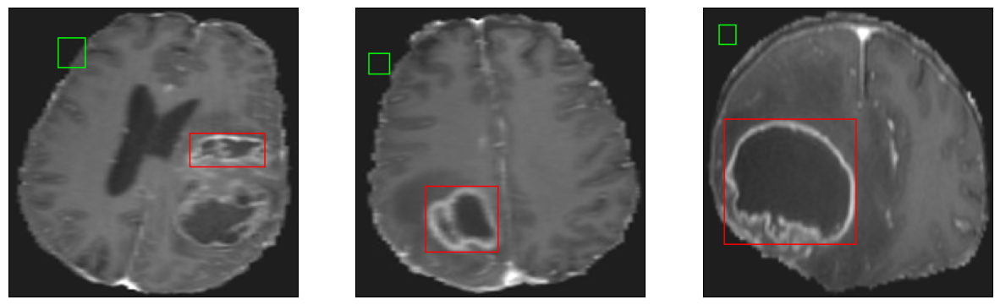

26/26 [==============================] - 2s 88ms/step - loss: 12.1069 - IoU: 0.3452 - val_loss: 51.7686 - val_IoU: 2.2232e-07
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 11.5016 - IoU: 0.3742
Epoch 7: val_IoU improved from 0.00160 to 0.00428, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


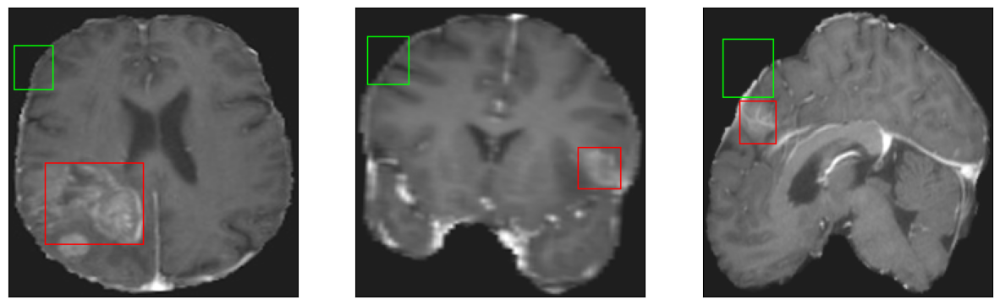

26/26 [==============================] - 3s 103ms/step - loss: 11.5016 - IoU: 0.3742 - val_loss: 42.4481 - val_IoU: 0.0043
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 11.2161 - IoU: 0.3763
Epoch 8: val_IoU improved from 0.00428 to 0.00435, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


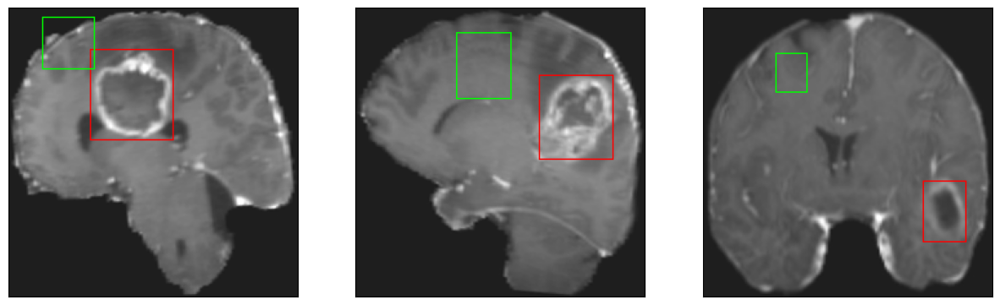

26/26 [==============================] - 3s 122ms/step - loss: 11.2161 - IoU: 0.3763 - val_loss: 43.1956 - val_IoU: 0.0043
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 10.6149 - IoU: 0.3888
Epoch 9: val_IoU improved from 0.00435 to 0.02598, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


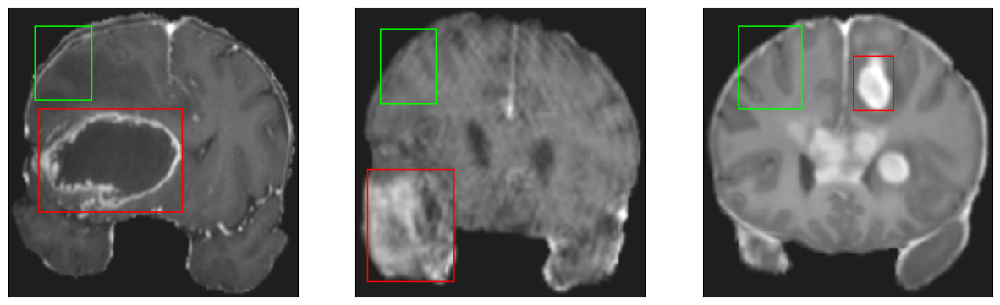

26/26 [==============================] - 3s 113ms/step - loss: 10.5846 - IoU: 0.3906 - val_loss: 38.5137 - val_IoU: 0.0260
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 9.7807 - IoU: 0.4232
Epoch 10: val_IoU did not improve from 0.02598
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


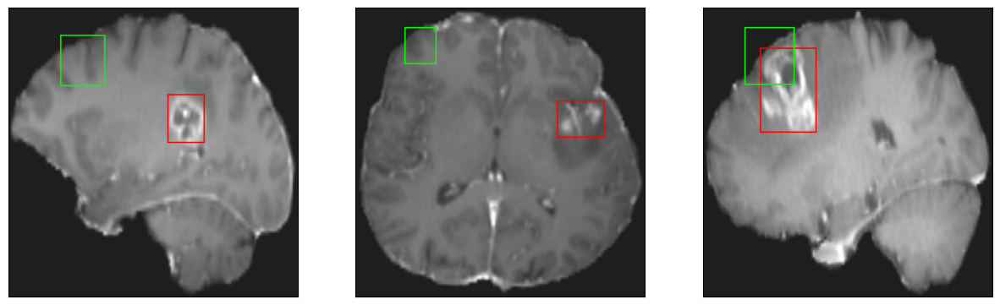

26/26 [==============================] - 2s 93ms/step - loss: 9.7080 - IoU: 0.4251 - val_loss: 38.9546 - val_IoU: 0.0127
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 9.3234 - IoU: 0.4378
Epoch 11: val_IoU did not improve from 0.02598
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


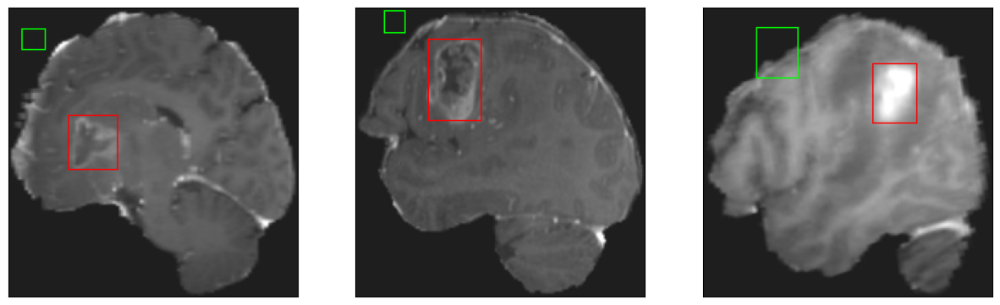

26/26 [==============================] - 2s 92ms/step - loss: 9.2471 - IoU: 0.4406 - val_loss: 41.1240 - val_IoU: 0.0039
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 9.7143 - IoU: 0.4143
Epoch 12: val_IoU did not improve from 0.02598
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


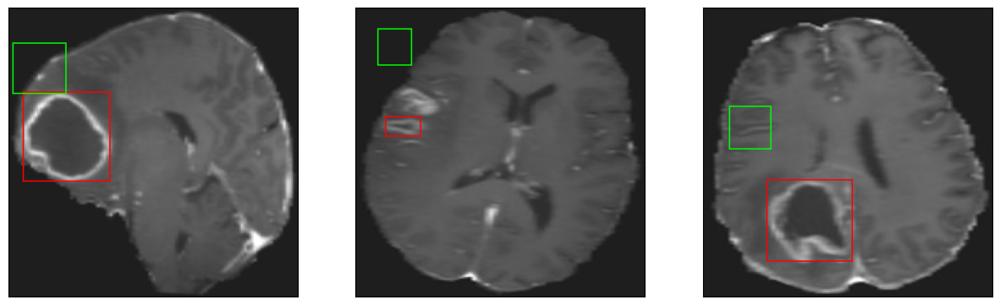

26/26 [==============================] - 3s 98ms/step - loss: 9.7143 - IoU: 0.4143 - val_loss: 35.3196 - val_IoU: 0.0214
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 9.7520 - IoU: 0.4091
Epoch 13: val_IoU improved from 0.02598 to 0.02860, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 22ms/step
4


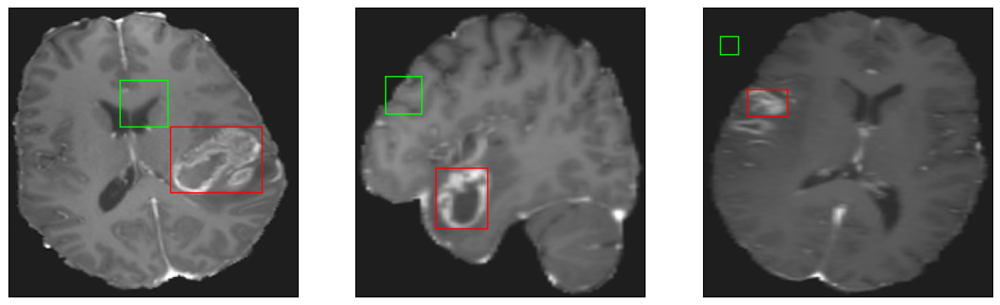

26/26 [==============================] - 4s 157ms/step - loss: 9.6766 - IoU: 0.4120 - val_loss: 33.3611 - val_IoU: 0.0286
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 8.8476 - IoU: 0.4504
Epoch 14: val_IoU improved from 0.02860 to 0.07948, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


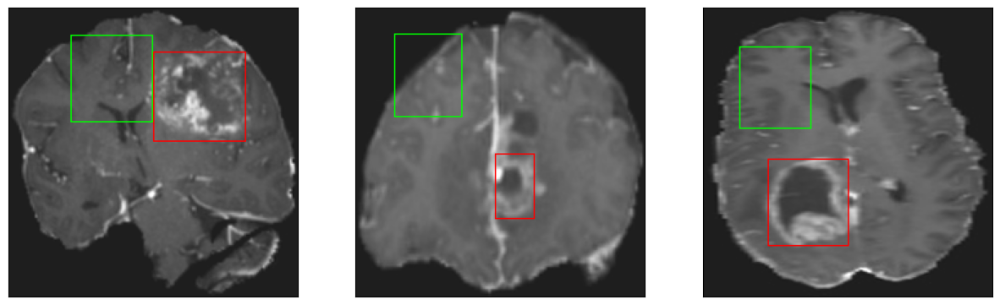

26/26 [==============================] - 3s 112ms/step - loss: 8.8476 - IoU: 0.4504 - val_loss: 32.5002 - val_IoU: 0.0795
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 8.7592 - IoU: 0.4489
Epoch 15: val_IoU did not improve from 0.07948
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


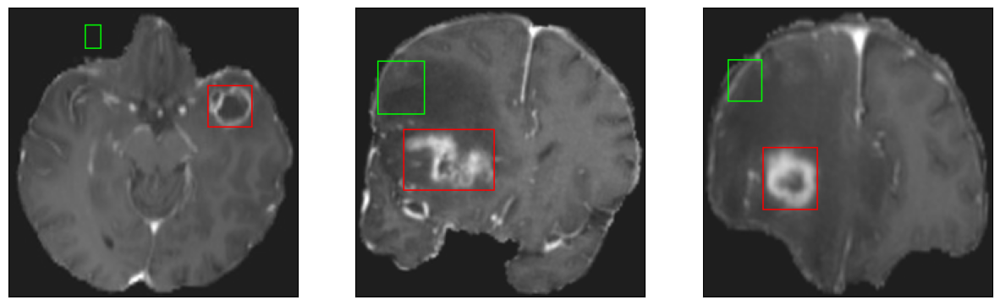

26/26 [==============================] - 3s 96ms/step - loss: 8.7475 - IoU: 0.4472 - val_loss: 37.7241 - val_IoU: 0.0159
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 8.4221 - IoU: 0.4582
Epoch 16: val_IoU did not improve from 0.07948
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


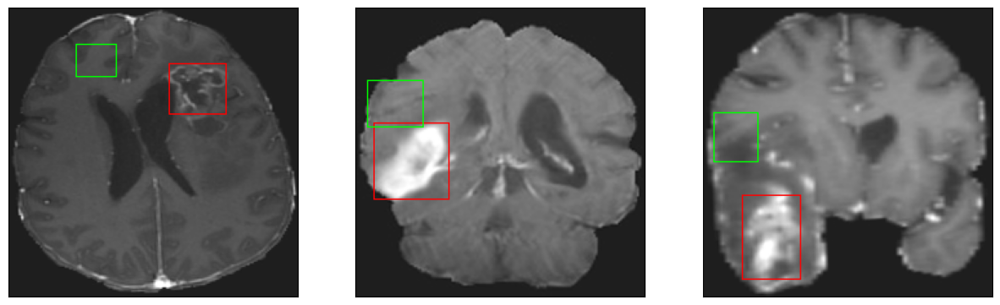

26/26 [==============================] - 3s 98ms/step - loss: 8.4498 - IoU: 0.4569 - val_loss: 33.9915 - val_IoU: 0.0210
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 8.0173 - IoU: 0.4885
Epoch 17: val_IoU did not improve from 0.07948
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


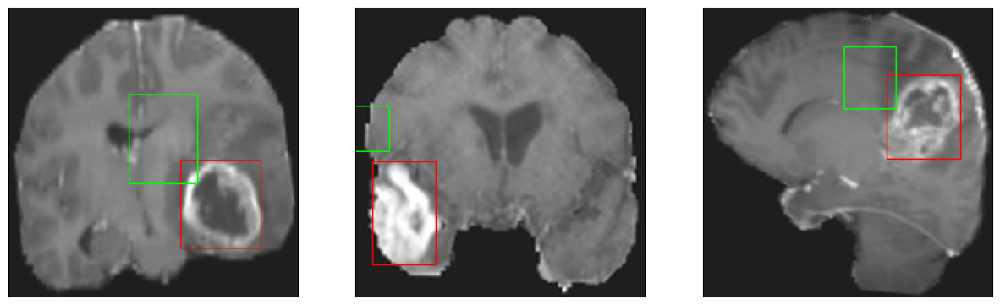

26/26 [==============================] - 3s 125ms/step - loss: 8.0173 - IoU: 0.4885 - val_loss: 29.5394 - val_IoU: 0.0323
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 7.5994 - IoU: 0.4988
Epoch 18: val_IoU improved from 0.07948 to 0.08200, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


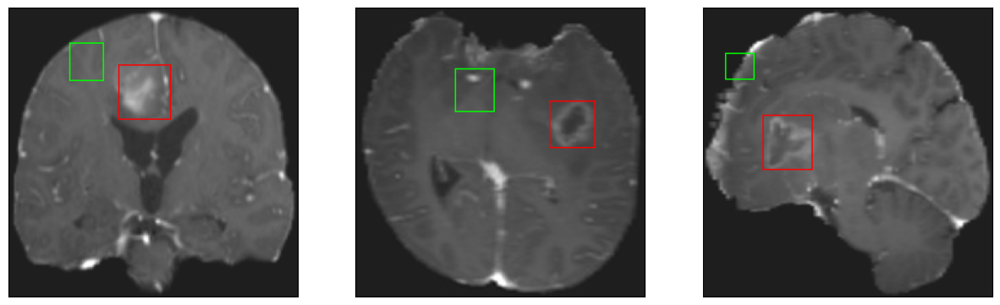

26/26 [==============================] - 4s 158ms/step - loss: 7.5559 - IoU: 0.4983 - val_loss: 24.1809 - val_IoU: 0.0820
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 7.9966 - IoU: 0.4862
Epoch 19: val_IoU improved from 0.08200 to 0.09458, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


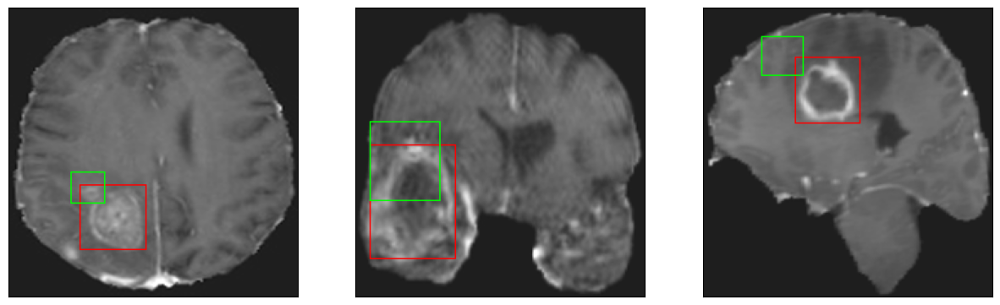

26/26 [==============================] - 3s 100ms/step - loss: 8.0057 - IoU: 0.4857 - val_loss: 22.0878 - val_IoU: 0.0946
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0740 - IoU: 0.4764
Epoch 20: val_IoU did not improve from 0.09458
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


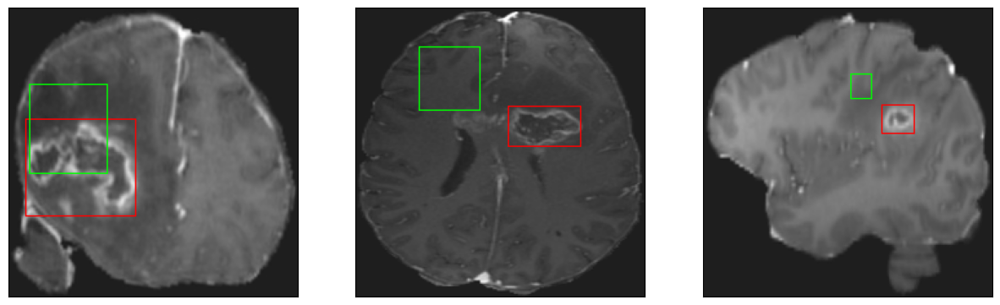

26/26 [==============================] - 3s 100ms/step - loss: 8.1101 - IoU: 0.4768 - val_loss: 22.5066 - val_IoU: 0.0834
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 7.5823 - IoU: 0.4945
Epoch 21: val_IoU did not improve from 0.09458
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


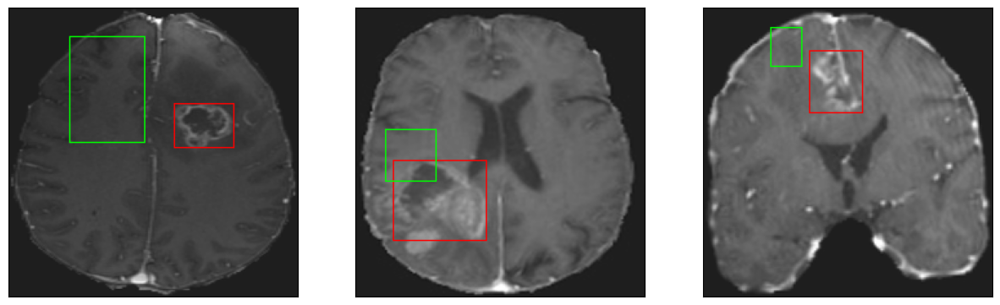

26/26 [==============================] - 3s 128ms/step - loss: 7.5823 - IoU: 0.4945 - val_loss: 24.3691 - val_IoU: 0.0795
Epoch 22/200
25/26 [===========================>..] - ETA: 0s - loss: 7.2956 - IoU: 0.5133
Epoch 22: val_IoU did not improve from 0.09458
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


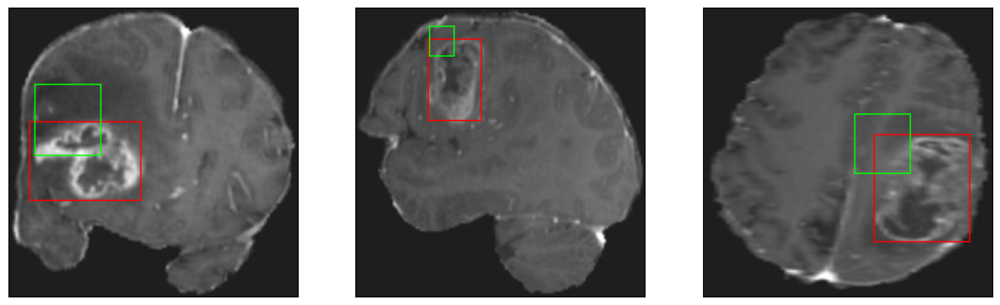

26/26 [==============================] - 3s 110ms/step - loss: 7.2996 - IoU: 0.5112 - val_loss: 22.2556 - val_IoU: 0.0814
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4065 - IoU: 0.5013
Epoch 23: val_IoU improved from 0.09458 to 0.19785, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


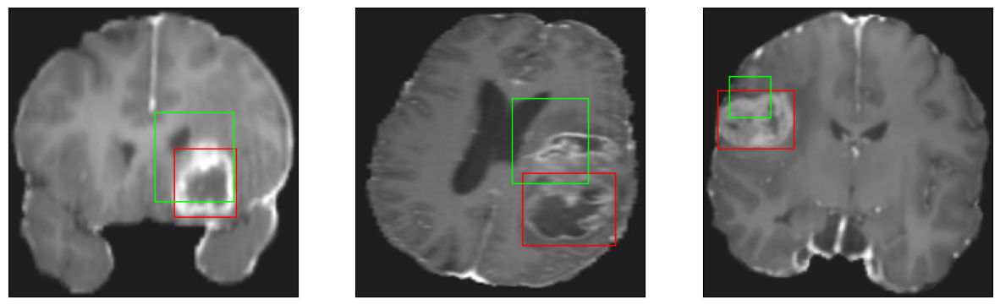

26/26 [==============================] - 4s 146ms/step - loss: 7.4636 - IoU: 0.5010 - val_loss: 16.1159 - val_IoU: 0.1978
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 7.3114 - IoU: 0.5113
Epoch 24: val_IoU improved from 0.19785 to 0.31820, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


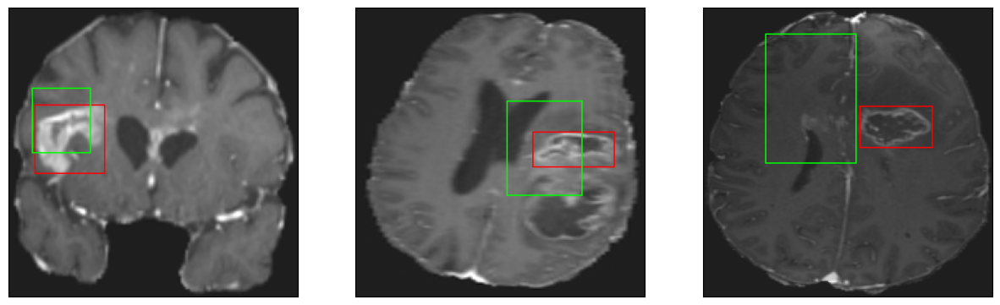

26/26 [==============================] - 3s 111ms/step - loss: 7.3010 - IoU: 0.5116 - val_loss: 13.3614 - val_IoU: 0.3182
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 7.0488 - IoU: 0.5117
Epoch 25: val_IoU improved from 0.31820 to 0.38796, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


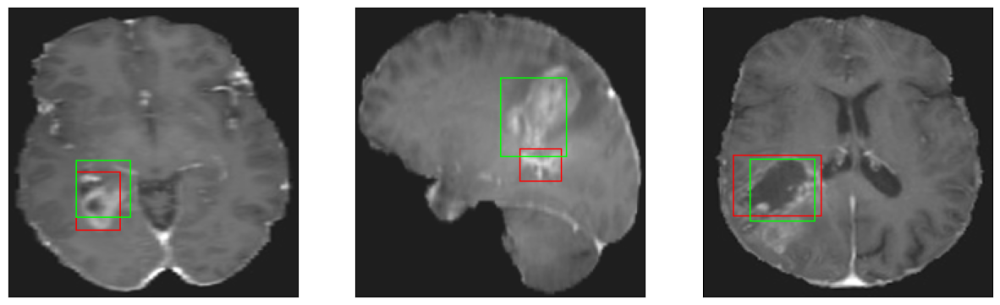

26/26 [==============================] - 3s 135ms/step - loss: 7.0488 - IoU: 0.5117 - val_loss: 12.4344 - val_IoU: 0.3880
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8977 - IoU: 0.5337
Epoch 26: val_IoU improved from 0.38796 to 0.46477, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


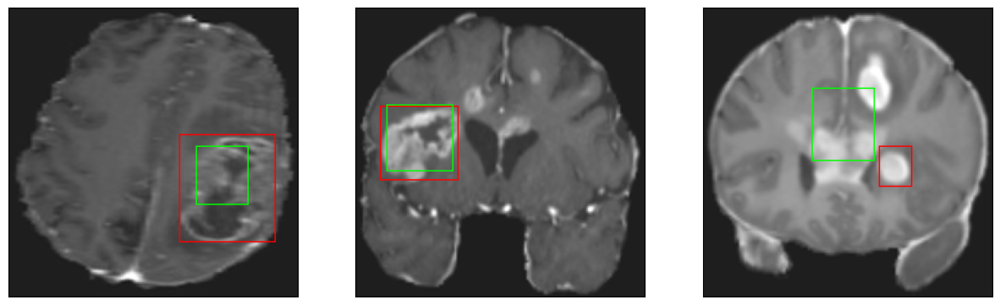

26/26 [==============================] - 3s 105ms/step - loss: 6.8820 - IoU: 0.5333 - val_loss: 10.3457 - val_IoU: 0.4648
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8943 - IoU: 0.5325
Epoch 27: val_IoU did not improve from 0.46477
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


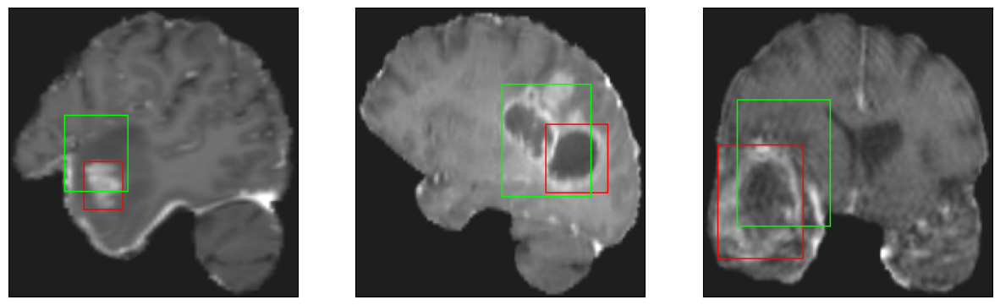

26/26 [==============================] - 3s 103ms/step - loss: 6.9082 - IoU: 0.5304 - val_loss: 22.4388 - val_IoU: 0.2501
Epoch 28/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8568 - IoU: 0.5332
Epoch 28: val_IoU did not improve from 0.46477
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


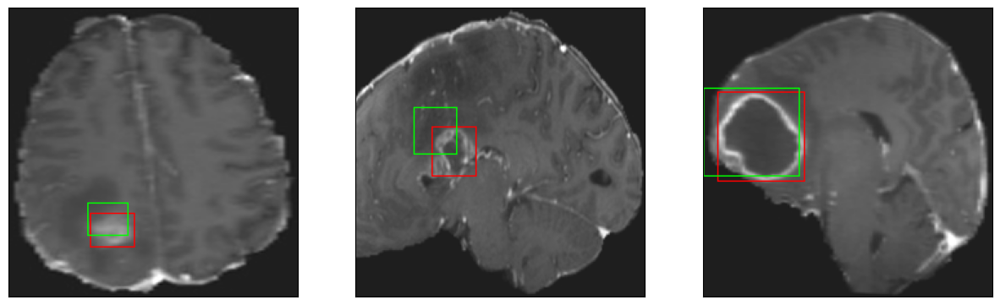

26/26 [==============================] - 3s 108ms/step - loss: 6.8343 - IoU: 0.5340 - val_loss: 12.6789 - val_IoU: 0.3342
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4246 - IoU: 0.5489
Epoch 29: val_IoU did not improve from 0.46477
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


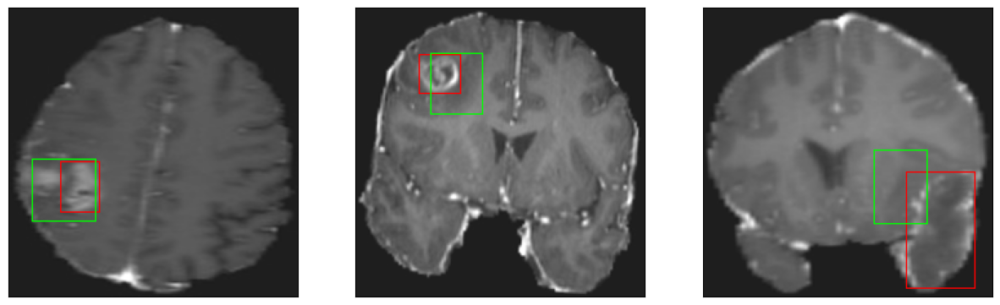

26/26 [==============================] - 3s 102ms/step - loss: 6.4422 - IoU: 0.5507 - val_loss: 12.8198 - val_IoU: 0.4003
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5854 - IoU: 0.5449
Epoch 30: val_IoU improved from 0.46477 to 0.46542, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


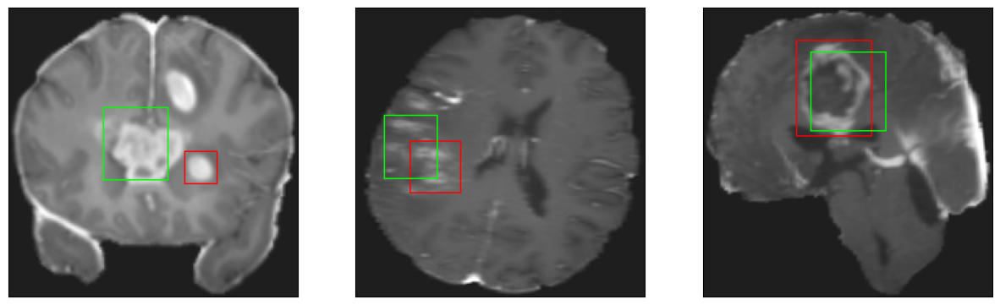

26/26 [==============================] - 4s 157ms/step - loss: 6.6275 - IoU: 0.5438 - val_loss: 10.0300 - val_IoU: 0.4654
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8390 - IoU: 0.5248
Epoch 31: val_IoU improved from 0.46542 to 0.46553, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


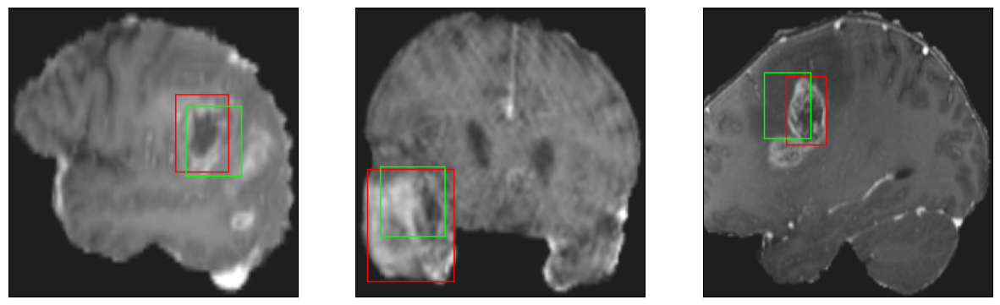

26/26 [==============================] - 4s 142ms/step - loss: 6.8992 - IoU: 0.5236 - val_loss: 10.5348 - val_IoU: 0.4655
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 6.3645 - IoU: 0.5512
Epoch 32: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


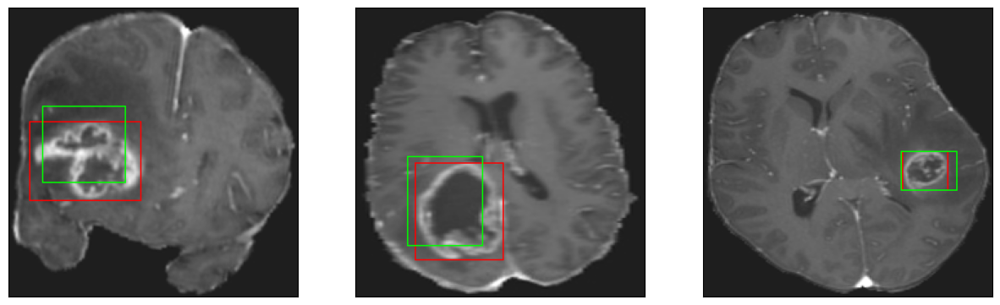

26/26 [==============================] - 3s 122ms/step - loss: 6.3645 - IoU: 0.5512 - val_loss: 12.2129 - val_IoU: 0.3677
Epoch 33/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0537 - IoU: 0.5702
Epoch 33: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


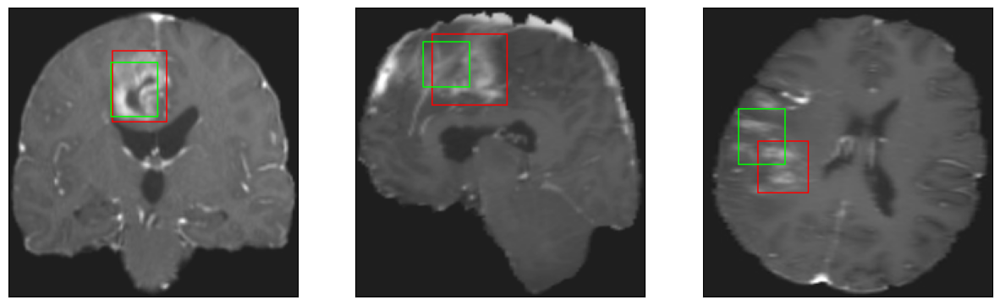

26/26 [==============================] - 3s 101ms/step - loss: 6.1087 - IoU: 0.5677 - val_loss: 12.3623 - val_IoU: 0.3673
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.2564 - IoU: 0.5505
Epoch 34: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


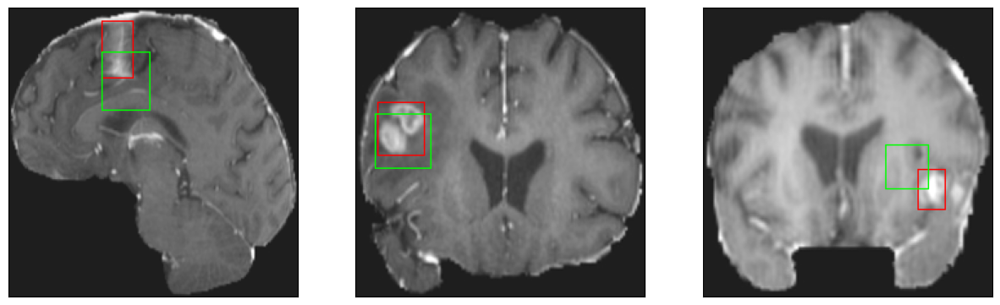

26/26 [==============================] - 3s 102ms/step - loss: 6.2564 - IoU: 0.5505 - val_loss: 11.1086 - val_IoU: 0.4133
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2813 - IoU: 0.5500
Epoch 35: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


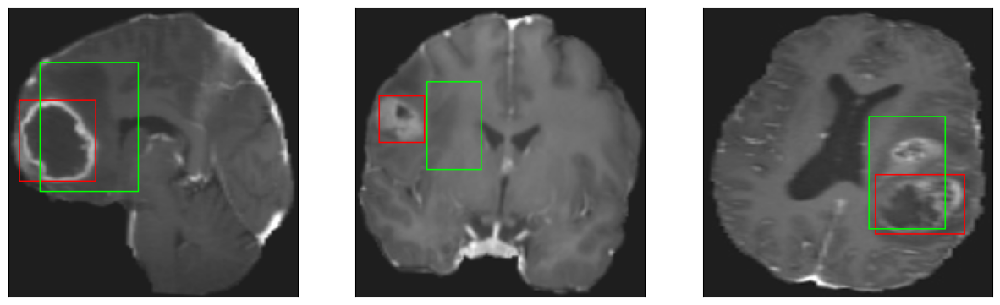

26/26 [==============================] - 3s 108ms/step - loss: 6.2226 - IoU: 0.5532 - val_loss: 24.0193 - val_IoU: 0.2724
Epoch 36/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1263 - IoU: 0.5629
Epoch 36: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


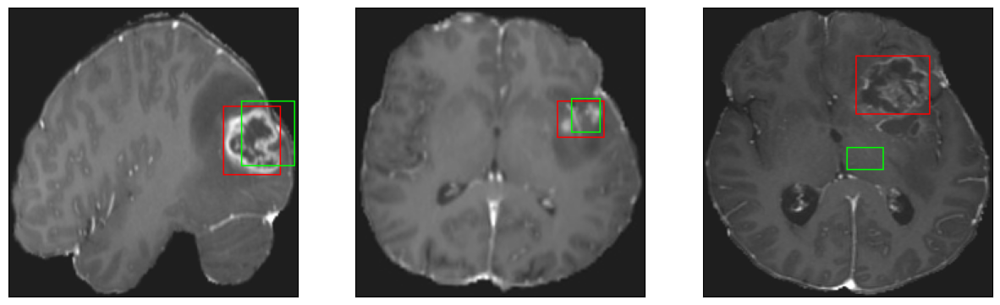

26/26 [==============================] - 3s 99ms/step - loss: 6.1274 - IoU: 0.5608 - val_loss: 10.4939 - val_IoU: 0.4491
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6911 - IoU: 0.5296
Epoch 37: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


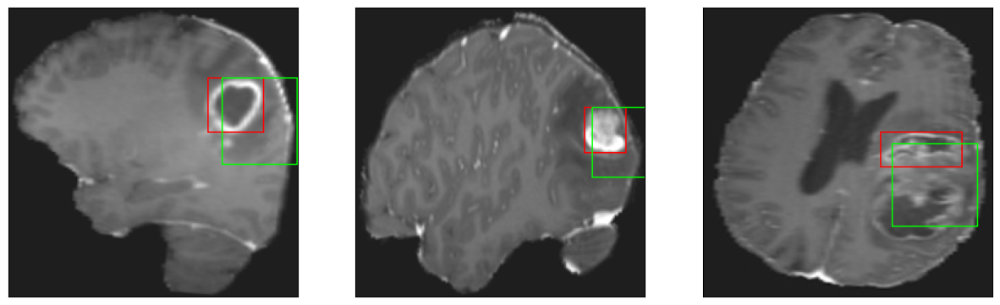

26/26 [==============================] - 3s 102ms/step - loss: 6.6952 - IoU: 0.5305 - val_loss: 15.3131 - val_IoU: 0.2707
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3242 - IoU: 0.5518
Epoch 38: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


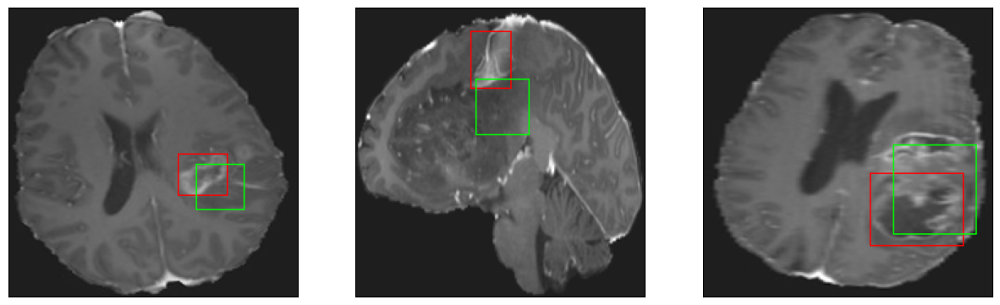

26/26 [==============================] - 3s 124ms/step - loss: 6.2598 - IoU: 0.5552 - val_loss: 12.5878 - val_IoU: 0.3534
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1009 - IoU: 0.5671
Epoch 39: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


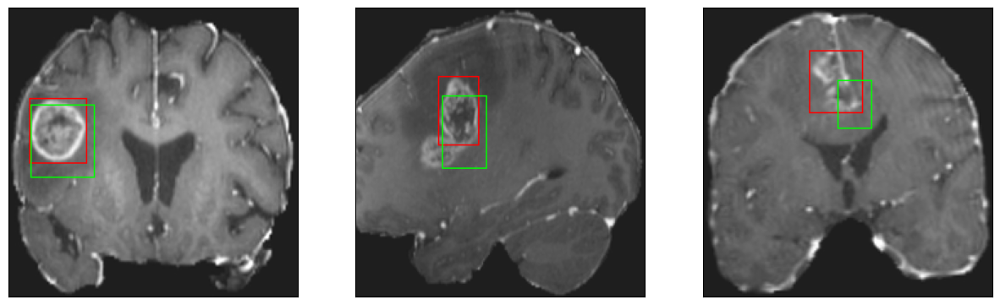

26/26 [==============================] - 3s 110ms/step - loss: 6.1172 - IoU: 0.5636 - val_loss: 12.3706 - val_IoU: 0.3607
Epoch 40/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0228 - IoU: 0.5742
Epoch 40: val_IoU did not improve from 0.46553
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


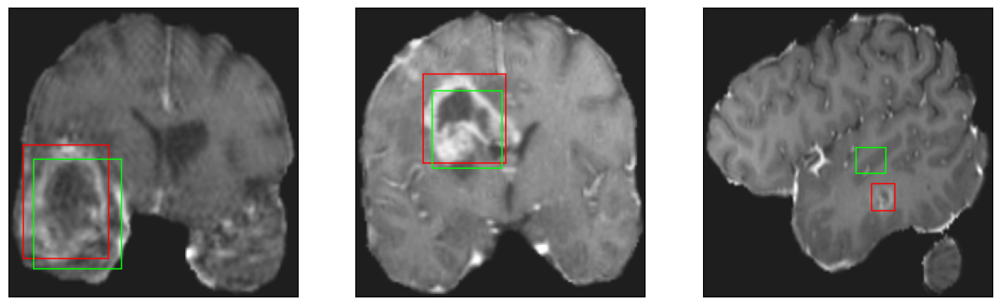

26/26 [==============================] - 3s 124ms/step - loss: 6.0007 - IoU: 0.5749 - val_loss: 10.1362 - val_IoU: 0.4458
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8742 - IoU: 0.5761
Epoch 41: val_IoU improved from 0.46553 to 0.49074, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


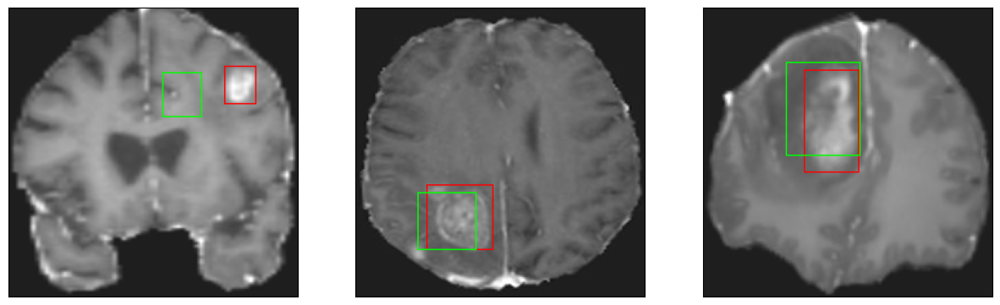

26/26 [==============================] - 4s 162ms/step - loss: 5.8525 - IoU: 0.5779 - val_loss: 9.9736 - val_IoU: 0.4907
Epoch 42/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1860 - IoU: 0.5564
Epoch 42: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


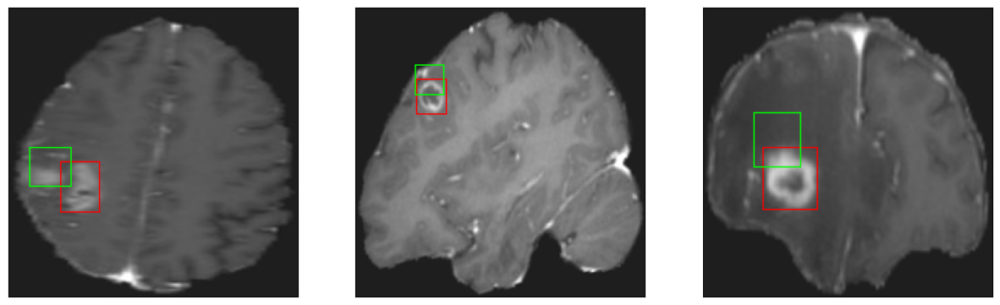

26/26 [==============================] - 3s 102ms/step - loss: 6.1612 - IoU: 0.5576 - val_loss: 16.9740 - val_IoU: 0.1805
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8205 - IoU: 0.5790
Epoch 43: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


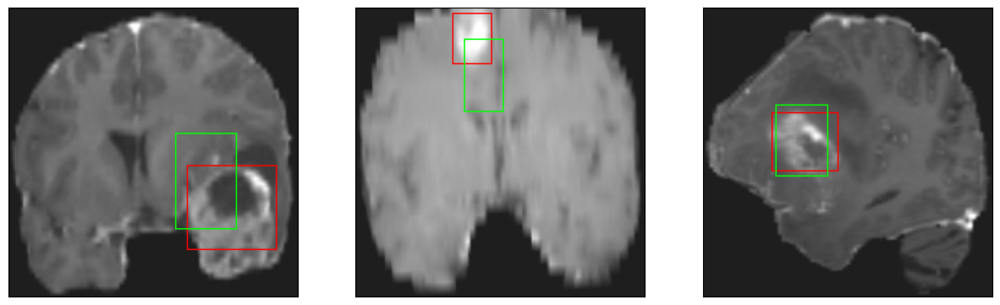

26/26 [==============================] - 3s 108ms/step - loss: 5.7974 - IoU: 0.5797 - val_loss: 12.4846 - val_IoU: 0.4179
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7959 - IoU: 0.5758
Epoch 44: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


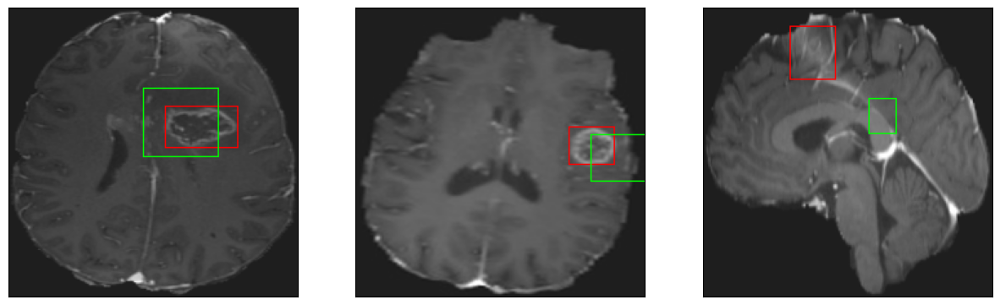

26/26 [==============================] - 3s 111ms/step - loss: 5.7998 - IoU: 0.5734 - val_loss: 13.3964 - val_IoU: 0.3025
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 5.7540 - IoU: 0.5740
Epoch 45: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


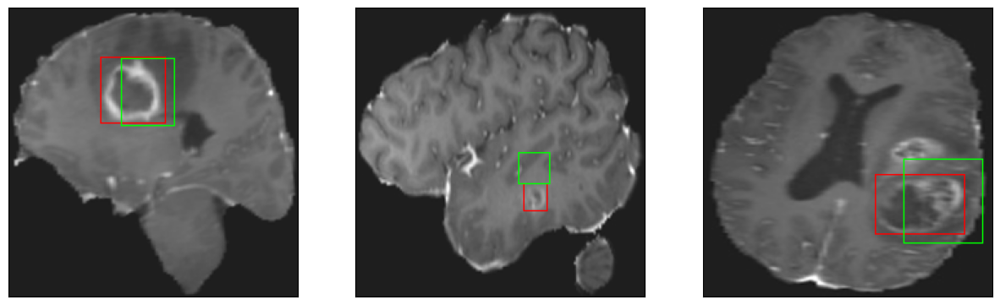

26/26 [==============================] - 3s 104ms/step - loss: 5.7540 - IoU: 0.5740 - val_loss: 12.4782 - val_IoU: 0.3400
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 5.8195 - IoU: 0.5780
Epoch 46: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


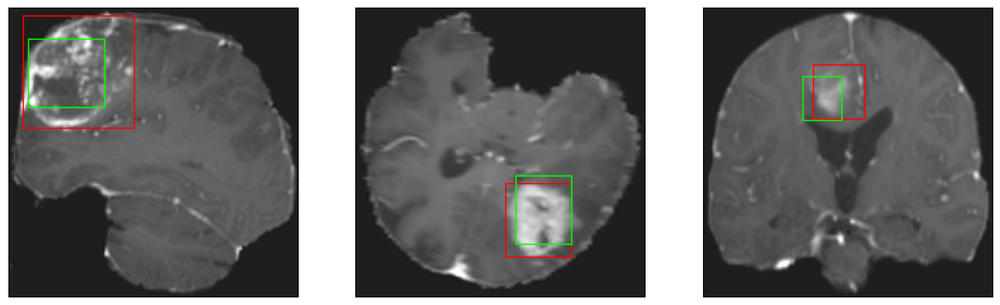

26/26 [==============================] - 3s 109ms/step - loss: 5.8195 - IoU: 0.5780 - val_loss: 11.4249 - val_IoU: 0.3984
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5993 - IoU: 0.5751
Epoch 47: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


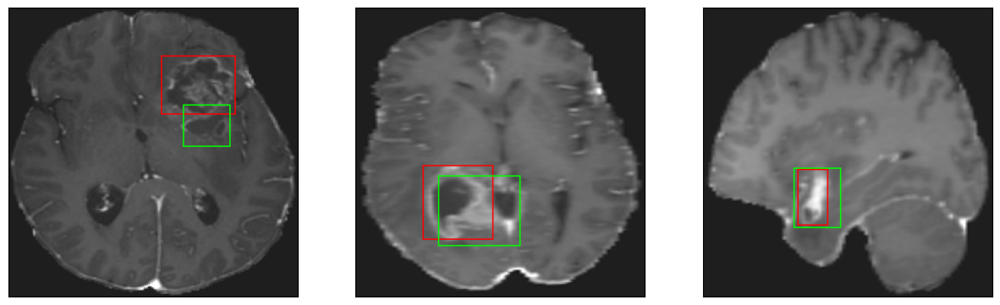

26/26 [==============================] - 3s 123ms/step - loss: 5.6043 - IoU: 0.5752 - val_loss: 10.1032 - val_IoU: 0.4859
Epoch 48/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6931 - IoU: 0.5798
Epoch 48: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


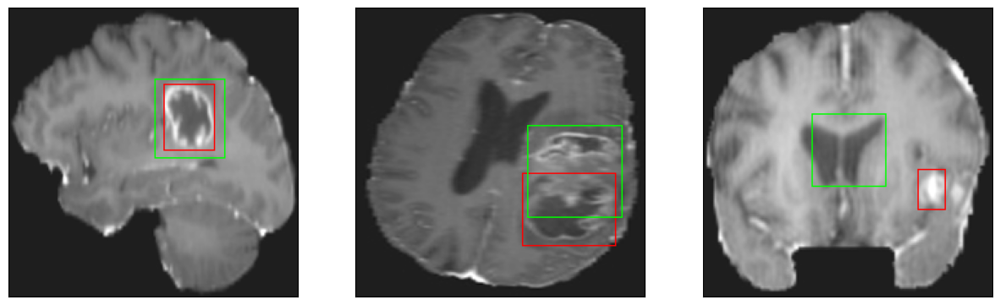

26/26 [==============================] - 3s 108ms/step - loss: 5.6710 - IoU: 0.5820 - val_loss: 11.7798 - val_IoU: 0.4521
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8092 - IoU: 0.5811
Epoch 49: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


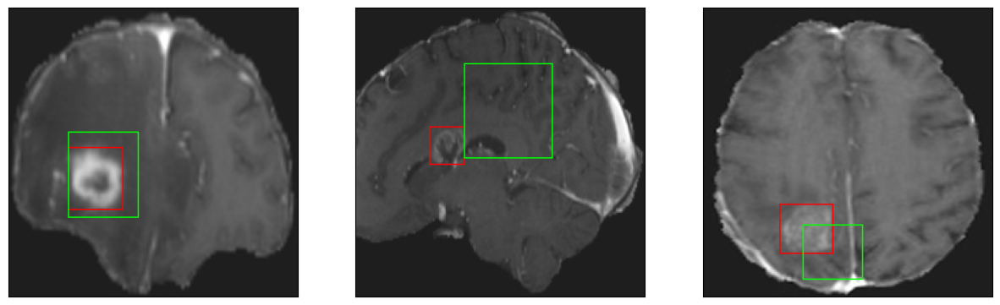

26/26 [==============================] - 3s 101ms/step - loss: 5.8409 - IoU: 0.5789 - val_loss: 13.4086 - val_IoU: 0.3475
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5885 - IoU: 0.5833
Epoch 50: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


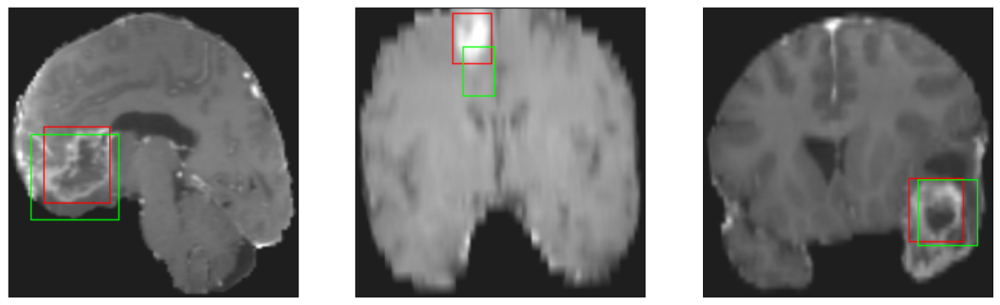

26/26 [==============================] - 3s 99ms/step - loss: 5.6121 - IoU: 0.5835 - val_loss: 12.8227 - val_IoU: 0.3278
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5996 - IoU: 0.5806
Epoch 51: val_IoU did not improve from 0.49074
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


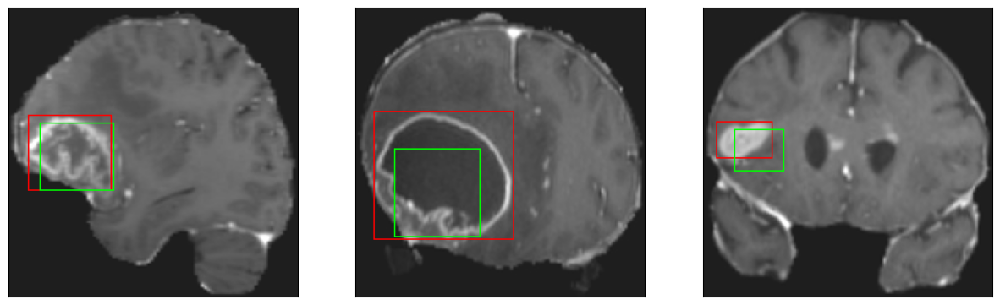

26/26 [==============================] - 4s 135ms/step - loss: 5.5565 - IoU: 0.5803 - val_loss: 10.1872 - val_IoU: 0.4802
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 5.4344 - IoU: 0.5867
Epoch 52: val_IoU improved from 0.49074 to 0.51261, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


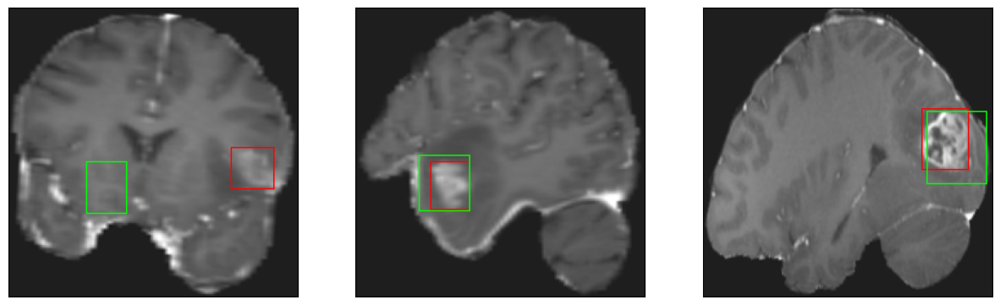

26/26 [==============================] - 4s 155ms/step - loss: 5.4344 - IoU: 0.5867 - val_loss: 9.5353 - val_IoU: 0.5126
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 5.4731 - IoU: 0.5901
Epoch 53: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


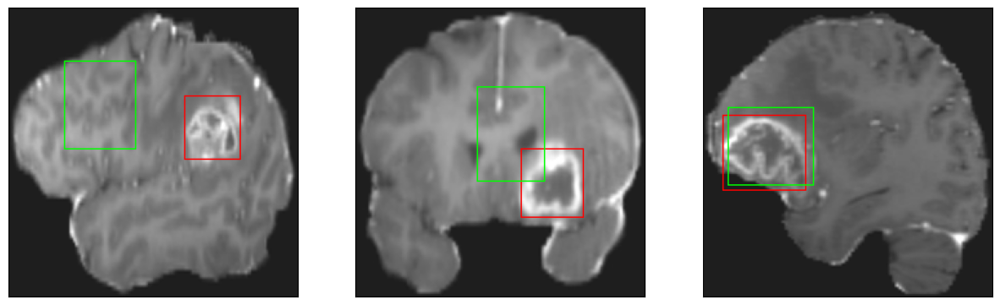

26/26 [==============================] - 3s 106ms/step - loss: 5.4731 - IoU: 0.5901 - val_loss: 17.0280 - val_IoU: 0.2656
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.6132 - IoU: 0.5849
Epoch 54: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


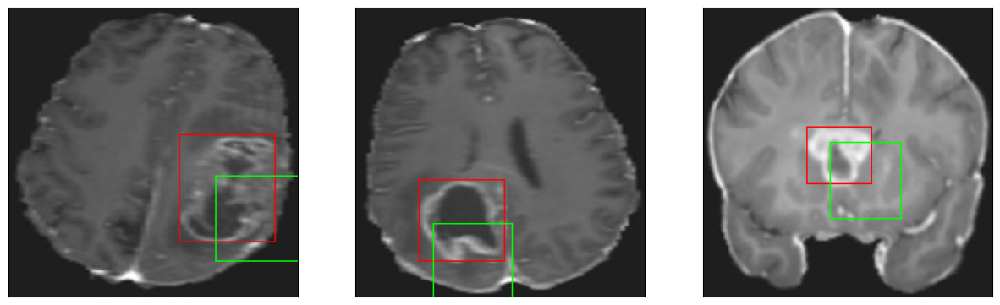

26/26 [==============================] - 3s 126ms/step - loss: 5.6132 - IoU: 0.5849 - val_loss: 13.6251 - val_IoU: 0.2954
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 5.1739 - IoU: 0.6037
Epoch 55: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


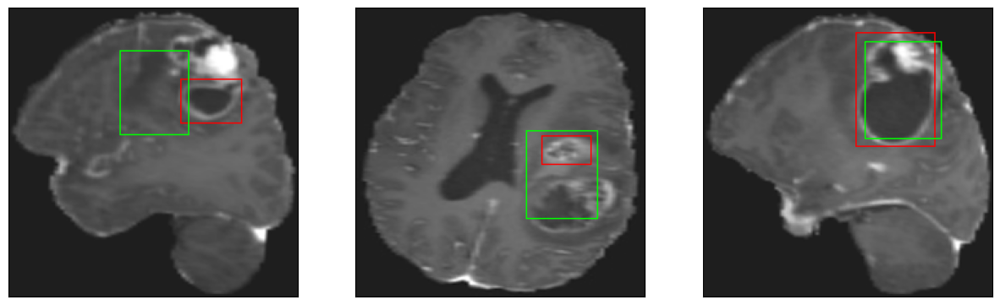

26/26 [==============================] - 3s 106ms/step - loss: 5.1739 - IoU: 0.6037 - val_loss: 12.6072 - val_IoU: 0.3786
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4241 - IoU: 0.5927
Epoch 56: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


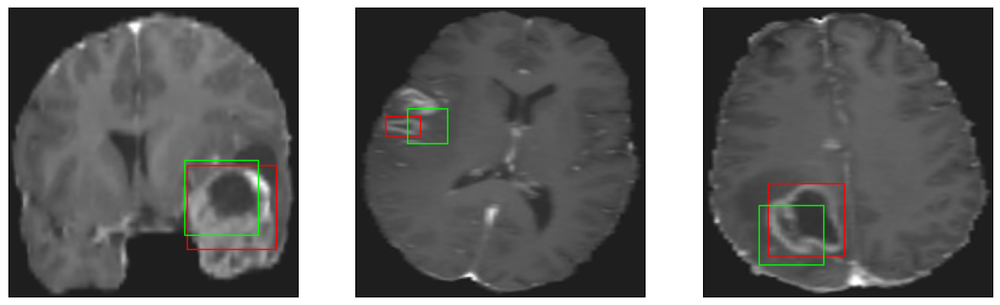

26/26 [==============================] - 3s 104ms/step - loss: 5.4471 - IoU: 0.5920 - val_loss: 9.8374 - val_IoU: 0.5046
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0686 - IoU: 0.6169
Epoch 57: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


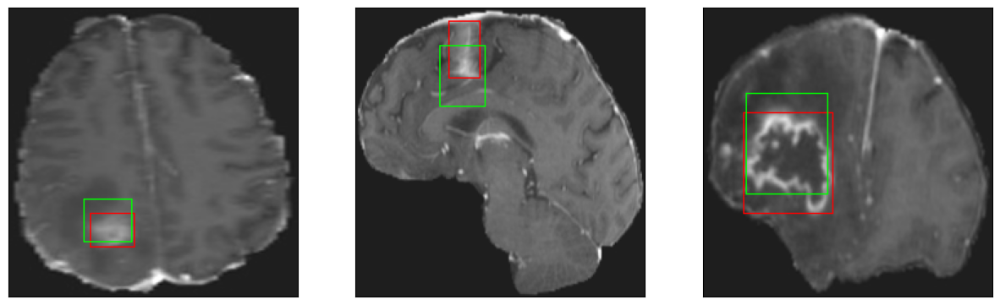

26/26 [==============================] - 3s 109ms/step - loss: 5.0975 - IoU: 0.6160 - val_loss: 12.8548 - val_IoU: 0.3877
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.1599 - IoU: 0.6100
Epoch 58: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


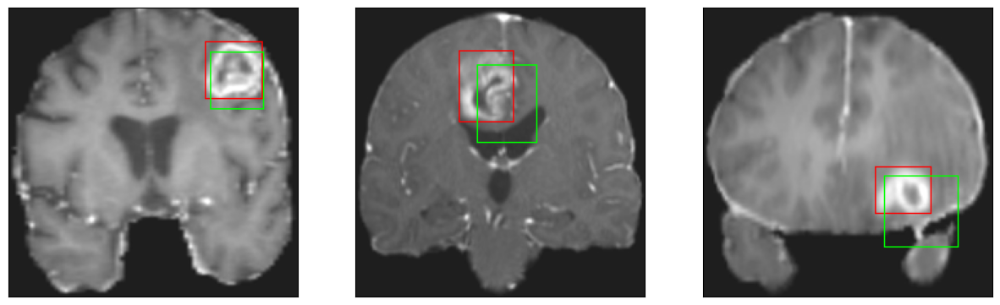

26/26 [==============================] - 3s 129ms/step - loss: 5.1599 - IoU: 0.6100 - val_loss: 14.2416 - val_IoU: 0.2941
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2329 - IoU: 0.6065
Epoch 59: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


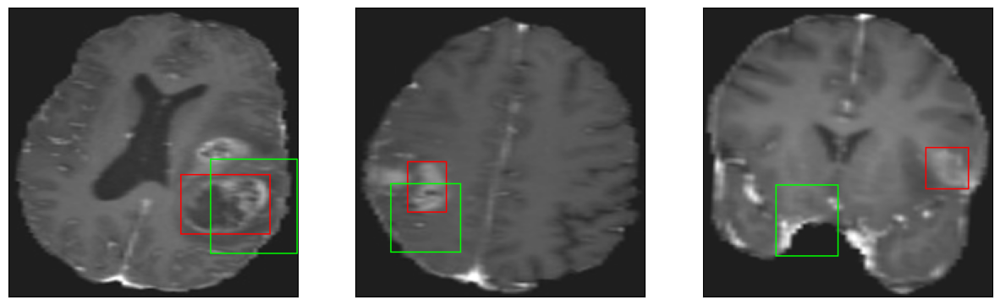

26/26 [==============================] - 3s 112ms/step - loss: 5.2553 - IoU: 0.6054 - val_loss: 14.6901 - val_IoU: 0.3243
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.4619 - IoU: 0.5900
Epoch 60: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


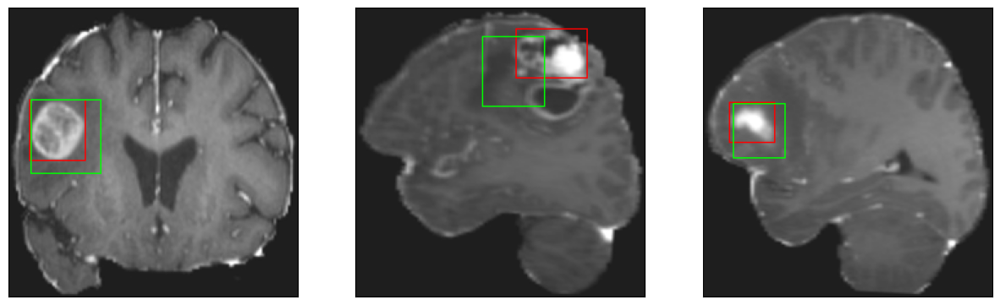

26/26 [==============================] - 3s 124ms/step - loss: 5.4619 - IoU: 0.5900 - val_loss: 11.9946 - val_IoU: 0.4501
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2834 - IoU: 0.6025
Epoch 61: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4


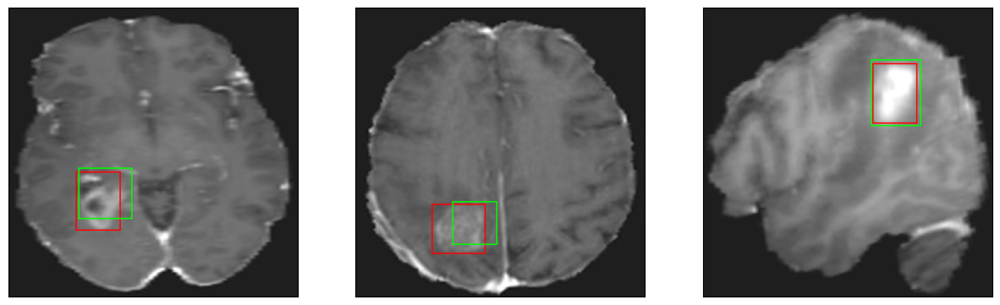

26/26 [==============================] - 3s 109ms/step - loss: 5.2388 - IoU: 0.6053 - val_loss: 9.7501 - val_IoU: 0.4870
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3209 - IoU: 0.6061
Epoch 62: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


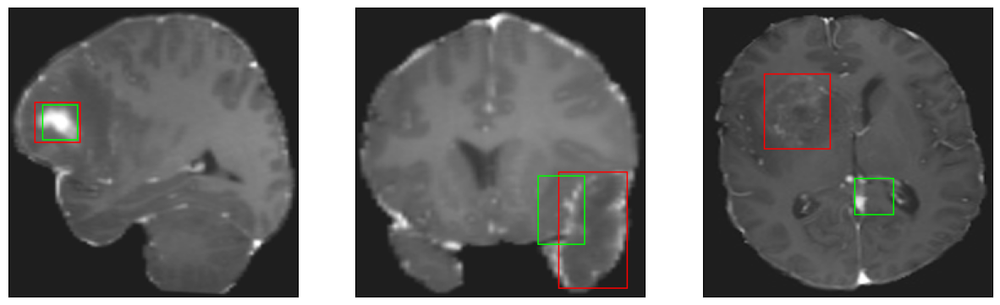

26/26 [==============================] - 3s 105ms/step - loss: 5.2830 - IoU: 0.6070 - val_loss: 9.9337 - val_IoU: 0.4943
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9621 - IoU: 0.6107
Epoch 63: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


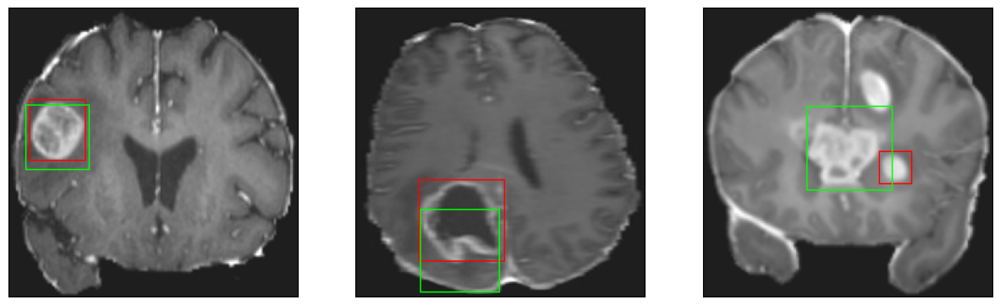

26/26 [==============================] - 3s 97ms/step - loss: 4.9125 - IoU: 0.6140 - val_loss: 10.4470 - val_IoU: 0.4857
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0128 - IoU: 0.6164
Epoch 64: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


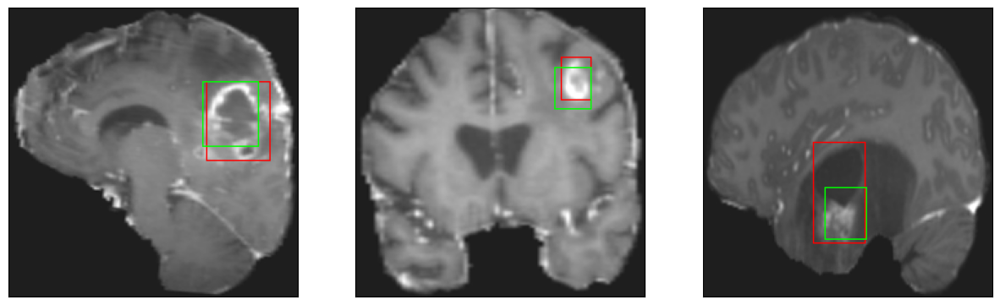

26/26 [==============================] - 2s 93ms/step - loss: 5.0095 - IoU: 0.6157 - val_loss: 11.0876 - val_IoU: 0.4454
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 5.2191 - IoU: 0.6053
Epoch 65: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


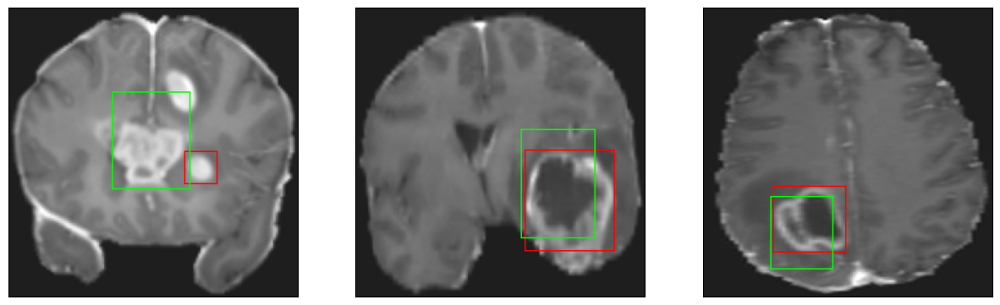

26/26 [==============================] - 3s 106ms/step - loss: 5.2191 - IoU: 0.6053 - val_loss: 11.6088 - val_IoU: 0.4354
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 4.9764 - IoU: 0.6083
Epoch 66: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


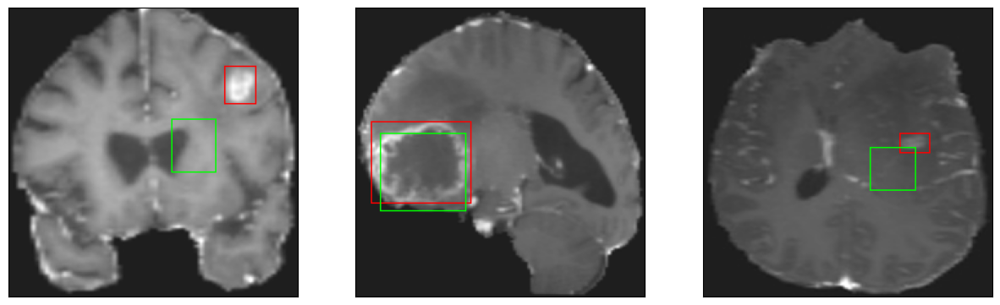

26/26 [==============================] - 3s 121ms/step - loss: 4.9764 - IoU: 0.6083 - val_loss: 11.5007 - val_IoU: 0.3895
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 4.8357 - IoU: 0.6243
Epoch 67: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


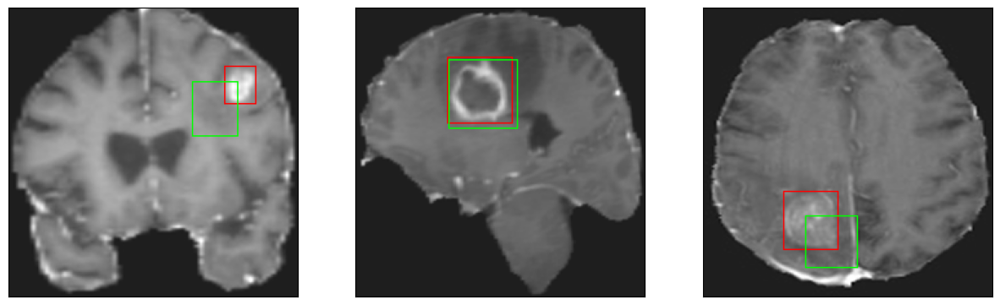

26/26 [==============================] - 3s 108ms/step - loss: 4.8357 - IoU: 0.6243 - val_loss: 11.9585 - val_IoU: 0.4104
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2534 - IoU: 0.6060
Epoch 68: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


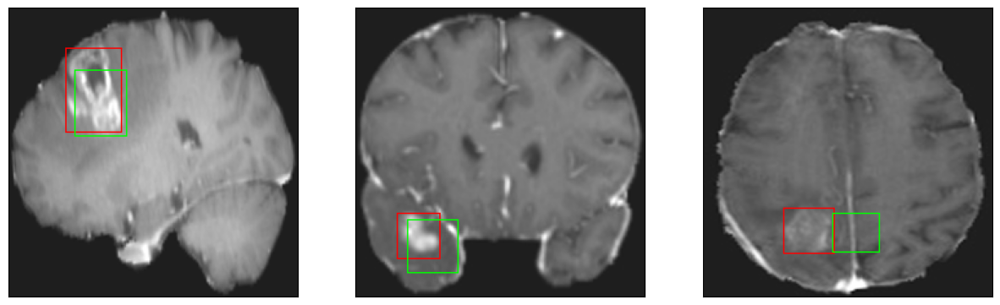

26/26 [==============================] - 3s 110ms/step - loss: 5.2211 - IoU: 0.6076 - val_loss: 12.3637 - val_IoU: 0.4079
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 5.0303 - IoU: 0.6214
Epoch 69: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


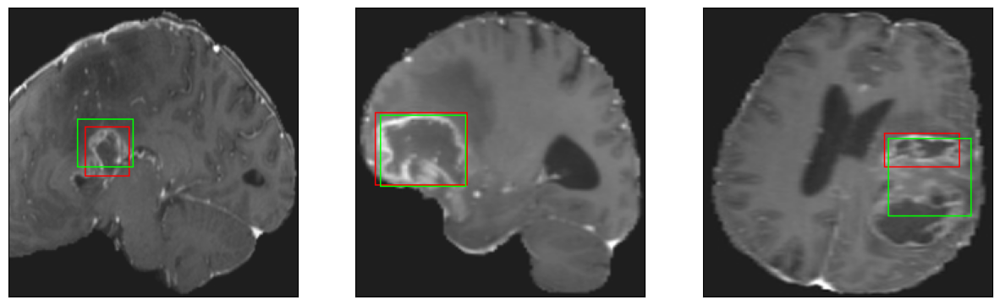

26/26 [==============================] - 3s 114ms/step - loss: 5.0303 - IoU: 0.6214 - val_loss: 9.9764 - val_IoU: 0.4786
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8952 - IoU: 0.6128
Epoch 70: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


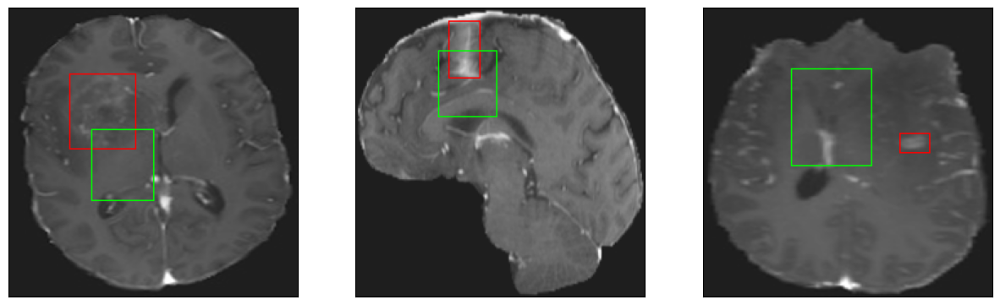

26/26 [==============================] - 3s 108ms/step - loss: 4.9064 - IoU: 0.6135 - val_loss: 10.9888 - val_IoU: 0.4764
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 5.2528 - IoU: 0.6039
Epoch 71: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


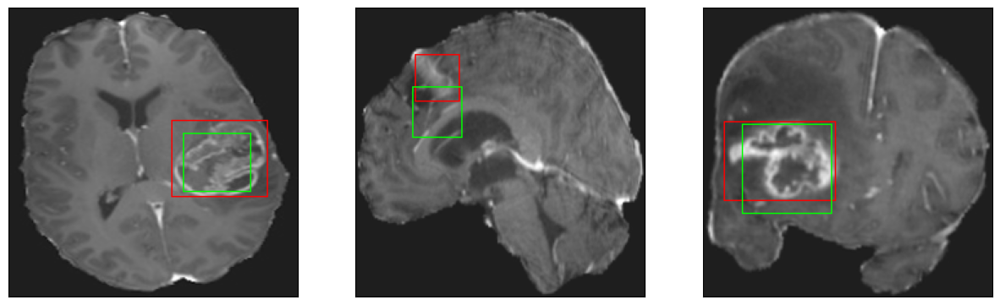

26/26 [==============================] - 3s 111ms/step - loss: 5.2528 - IoU: 0.6039 - val_loss: 9.6071 - val_IoU: 0.4983
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9098 - IoU: 0.6211
Epoch 72: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 14ms/step
4


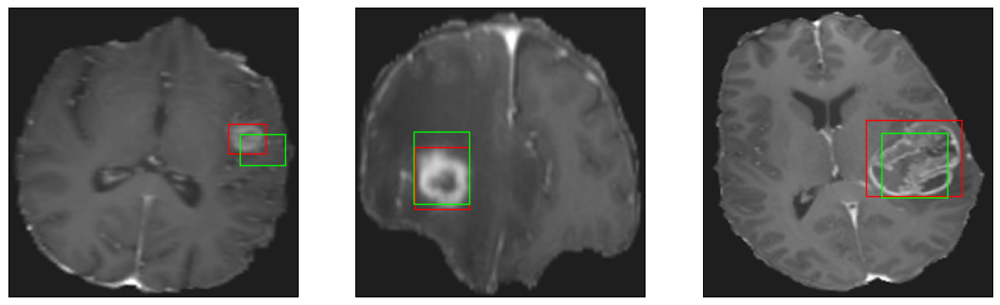

26/26 [==============================] - 3s 113ms/step - loss: 4.8882 - IoU: 0.6209 - val_loss: 9.9079 - val_IoU: 0.4758
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 5.0086 - IoU: 0.6153
Epoch 73: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


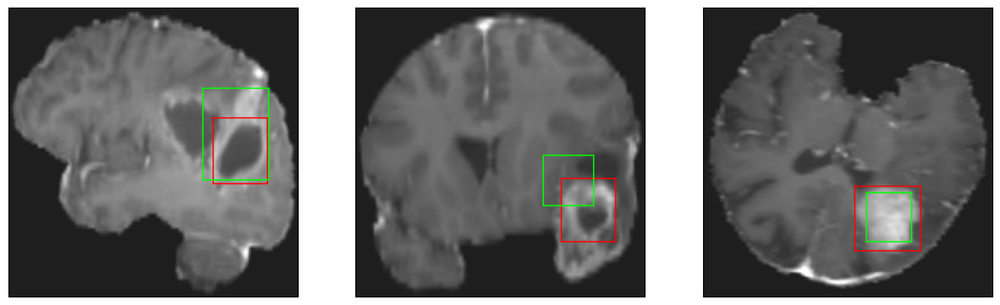

26/26 [==============================] - 3s 110ms/step - loss: 5.0086 - IoU: 0.6153 - val_loss: 9.8233 - val_IoU: 0.4999
Epoch 74/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2687 - IoU: 0.5957
Epoch 74: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


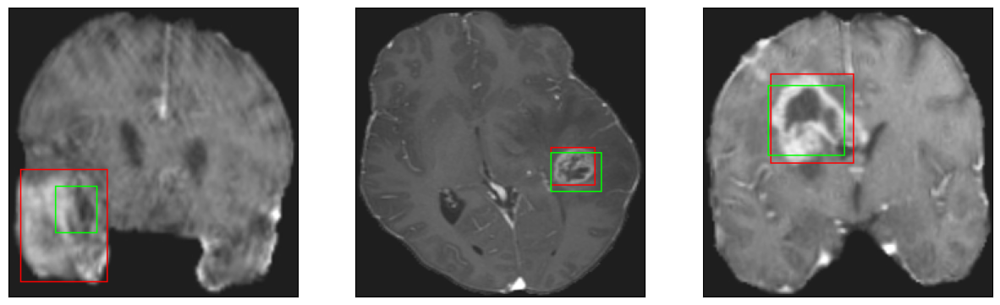

26/26 [==============================] - 3s 104ms/step - loss: 5.2691 - IoU: 0.5956 - val_loss: 10.8761 - val_IoU: 0.4720
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 4.9578 - IoU: 0.6172
Epoch 75: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


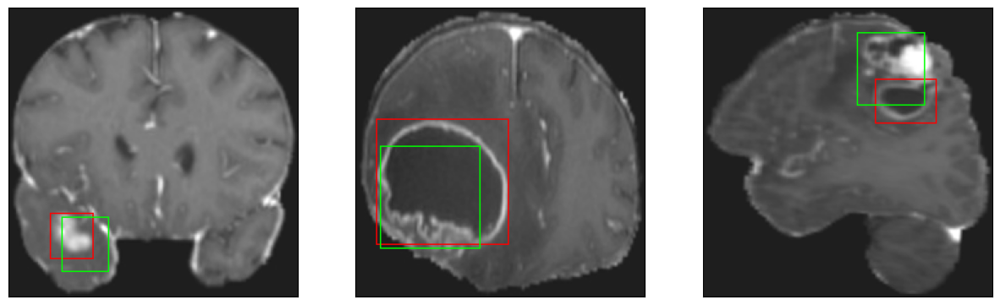

26/26 [==============================] - 3s 104ms/step - loss: 4.9578 - IoU: 0.6172 - val_loss: 10.7719 - val_IoU: 0.4597
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 4.9366 - IoU: 0.6155
Epoch 76: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


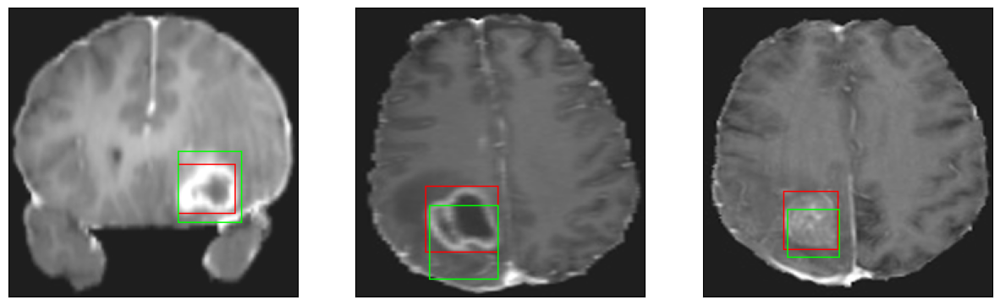

26/26 [==============================] - 3s 126ms/step - loss: 4.9366 - IoU: 0.6155 - val_loss: 9.6994 - val_IoU: 0.5016
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 4.9005 - IoU: 0.6200
Epoch 77: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


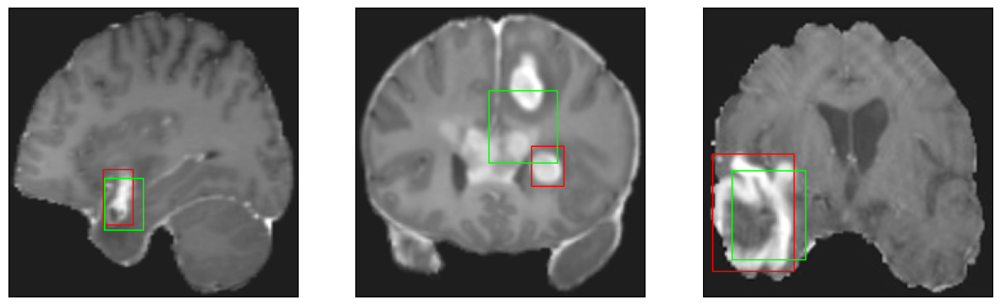

26/26 [==============================] - 3s 127ms/step - loss: 4.9005 - IoU: 0.6200 - val_loss: 10.2388 - val_IoU: 0.4654
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 4.8560 - IoU: 0.6274
Epoch 78: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


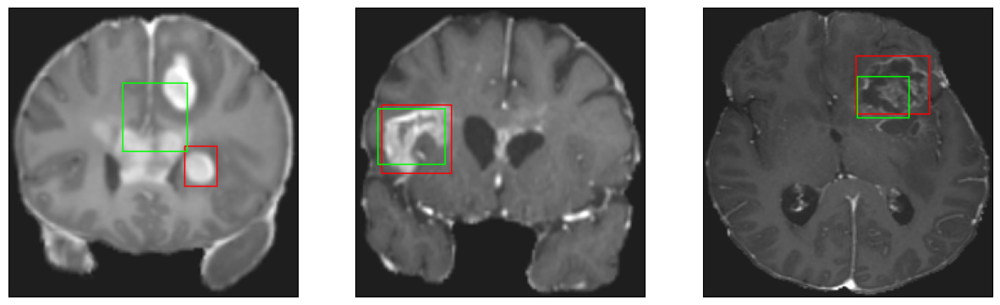

26/26 [==============================] - 3s 107ms/step - loss: 4.8560 - IoU: 0.6274 - val_loss: 10.2999 - val_IoU: 0.4671
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8996 - IoU: 0.6107
Epoch 79: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


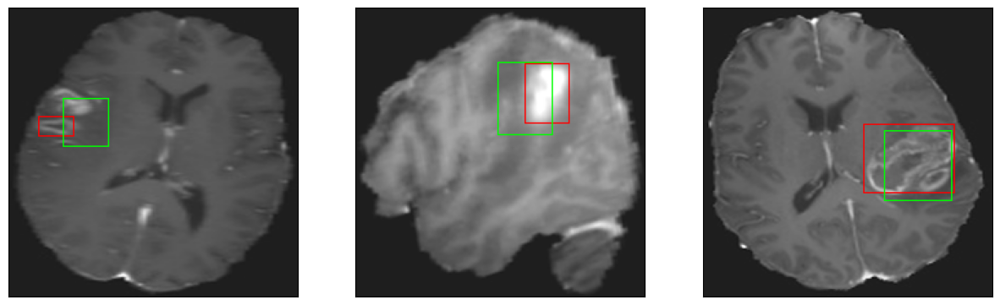

26/26 [==============================] - 3s 101ms/step - loss: 4.8950 - IoU: 0.6116 - val_loss: 10.4288 - val_IoU: 0.4714
Epoch 80/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6581 - IoU: 0.6329
Epoch 80: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


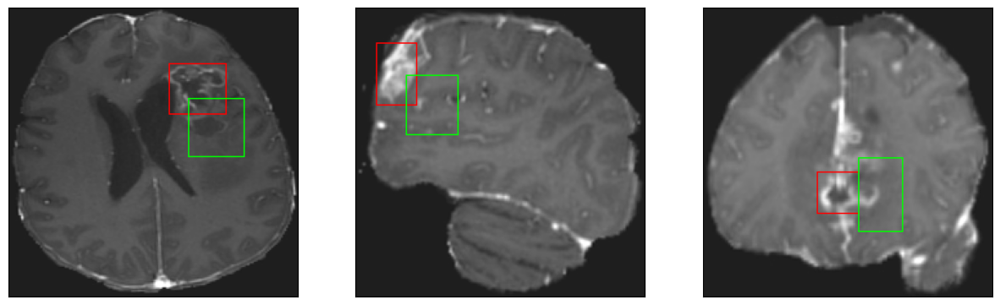

26/26 [==============================] - 3s 111ms/step - loss: 4.6794 - IoU: 0.6314 - val_loss: 13.6733 - val_IoU: 0.2955
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9444 - IoU: 0.6150
Epoch 81: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


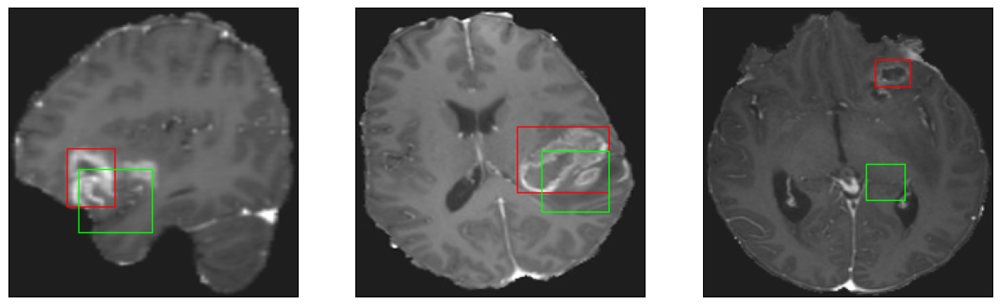

26/26 [==============================] - 3s 135ms/step - loss: 5.0027 - IoU: 0.6136 - val_loss: 10.9289 - val_IoU: 0.3923
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6887 - IoU: 0.6339
Epoch 82: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


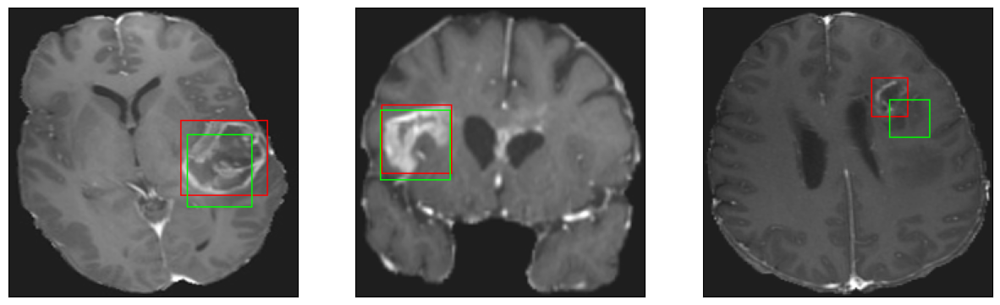

26/26 [==============================] - 3s 106ms/step - loss: 4.7199 - IoU: 0.6325 - val_loss: 9.7812 - val_IoU: 0.4751
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 5.1301 - IoU: 0.6036
Epoch 83: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


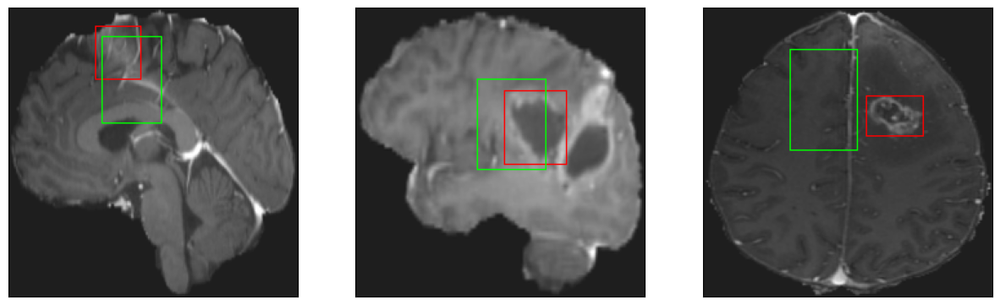

26/26 [==============================] - 3s 101ms/step - loss: 5.1301 - IoU: 0.6036 - val_loss: 20.6132 - val_IoU: 0.2414
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0877 - IoU: 0.6182
Epoch 84: val_IoU did not improve from 0.51261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


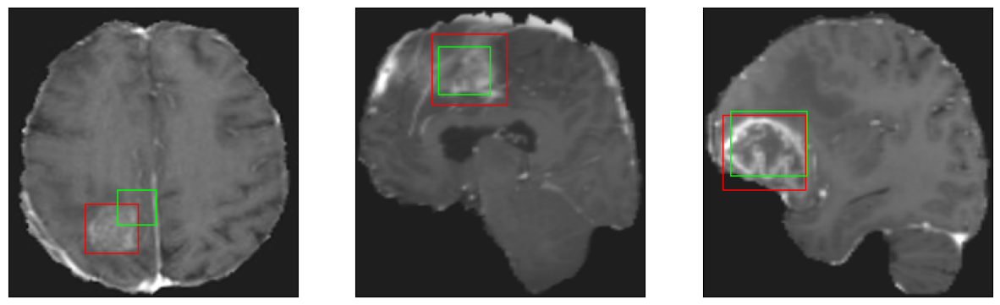

26/26 [==============================] - 2s 95ms/step - loss: 5.0456 - IoU: 0.6183 - val_loss: 11.6722 - val_IoU: 0.4105
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9636 - IoU: 0.6109
Epoch 85: val_IoU improved from 0.51261 to 0.53241, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


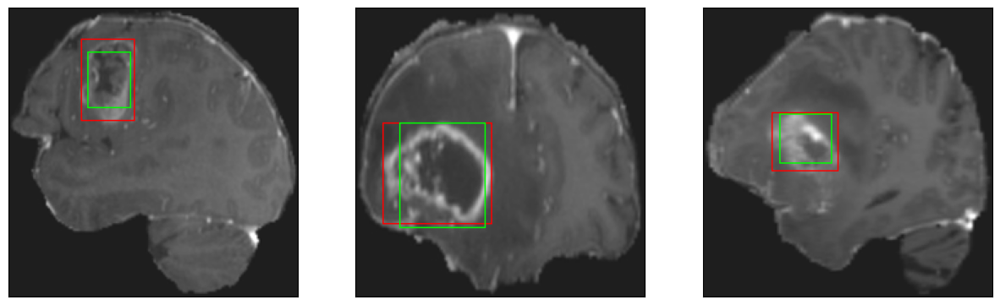

26/26 [==============================] - 4s 152ms/step - loss: 4.9515 - IoU: 0.6114 - val_loss: 8.9225 - val_IoU: 0.5324
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7854 - IoU: 0.6325
Epoch 86: val_IoU did not improve from 0.53241
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


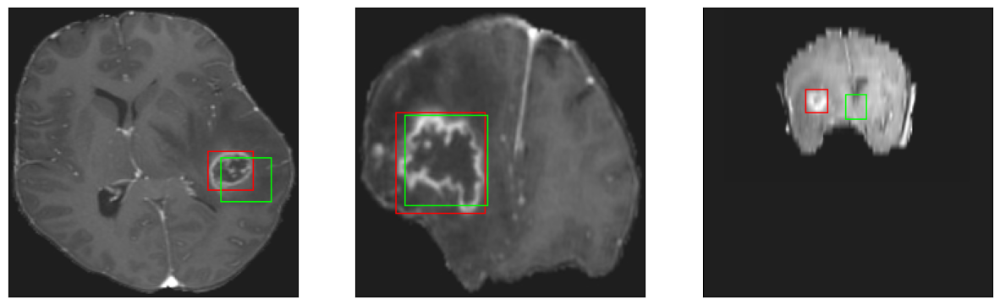

26/26 [==============================] - 3s 104ms/step - loss: 4.7608 - IoU: 0.6311 - val_loss: 10.5799 - val_IoU: 0.4508
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8113 - IoU: 0.6240
Epoch 87: val_IoU improved from 0.53241 to 0.54261, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


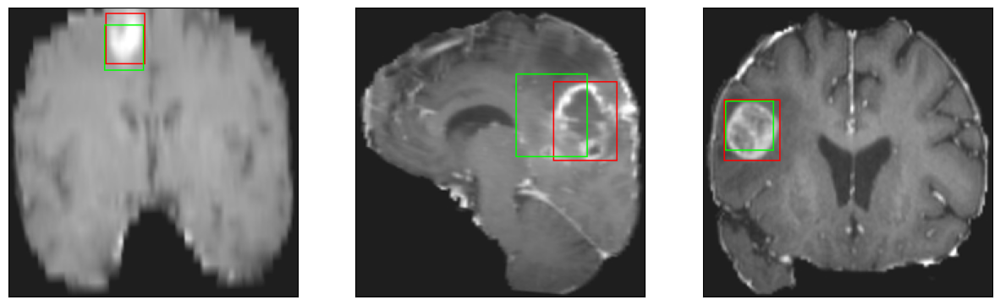

26/26 [==============================] - 3s 113ms/step - loss: 4.8074 - IoU: 0.6259 - val_loss: 9.0568 - val_IoU: 0.5426
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 5.0406 - IoU: 0.6160
Epoch 88: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


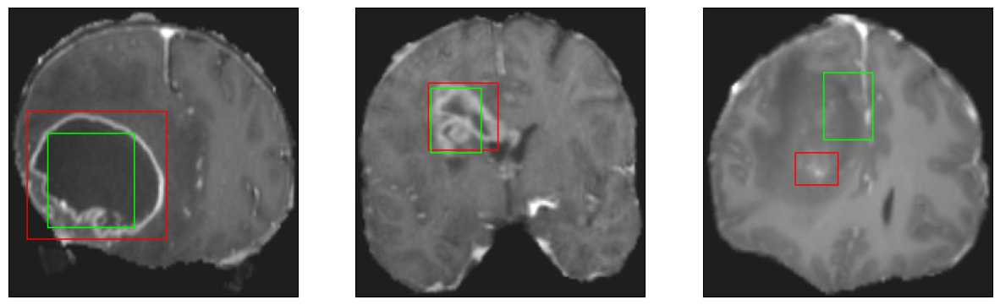

26/26 [==============================] - 3s 124ms/step - loss: 5.0406 - IoU: 0.6160 - val_loss: 9.5845 - val_IoU: 0.4982
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 5.3261 - IoU: 0.5965
Epoch 89: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


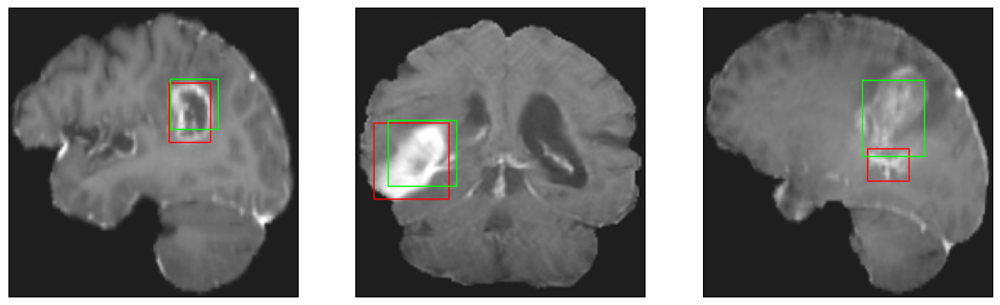

26/26 [==============================] - 3s 126ms/step - loss: 5.3261 - IoU: 0.5965 - val_loss: 9.6383 - val_IoU: 0.5247
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6374 - IoU: 0.6343
Epoch 90: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


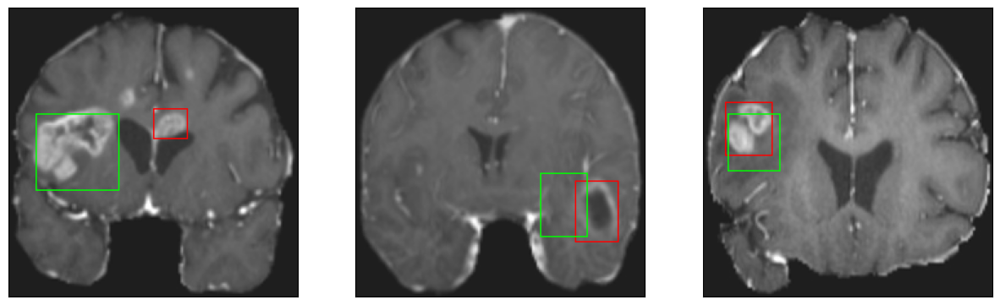

26/26 [==============================] - 3s 102ms/step - loss: 4.6820 - IoU: 0.6333 - val_loss: 11.8686 - val_IoU: 0.4151
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5238 - IoU: 0.5867
Epoch 91: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


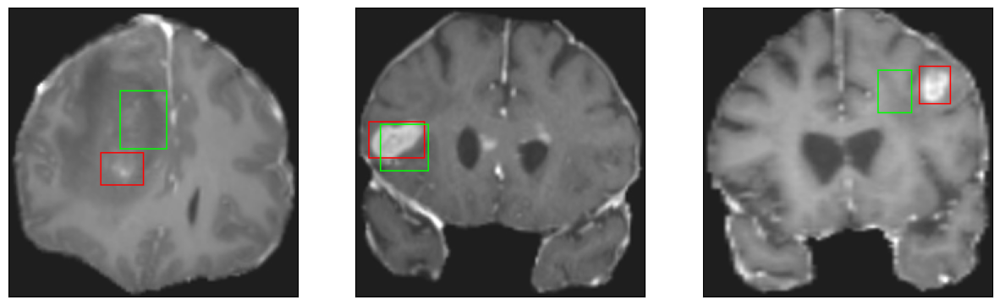

26/26 [==============================] - 3s 109ms/step - loss: 5.5219 - IoU: 0.5838 - val_loss: 9.4614 - val_IoU: 0.5009
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9600 - IoU: 0.6087
Epoch 92: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


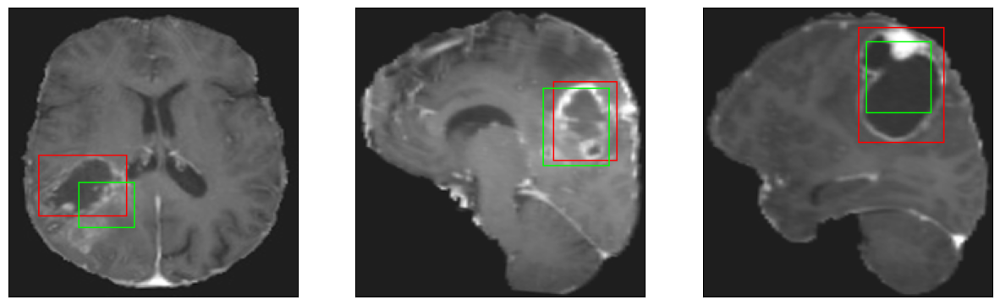

26/26 [==============================] - 3s 115ms/step - loss: 4.9180 - IoU: 0.6121 - val_loss: 11.0731 - val_IoU: 0.4222
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7093 - IoU: 0.6325
Epoch 93: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


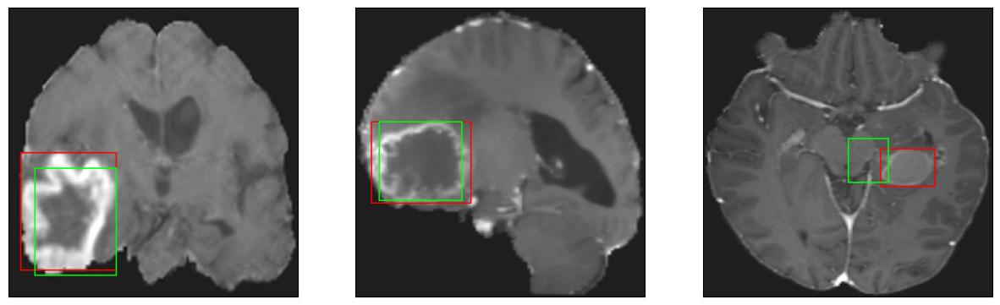

26/26 [==============================] - 3s 98ms/step - loss: 4.6890 - IoU: 0.6335 - val_loss: 11.3232 - val_IoU: 0.4082
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7712 - IoU: 0.6242
Epoch 94: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


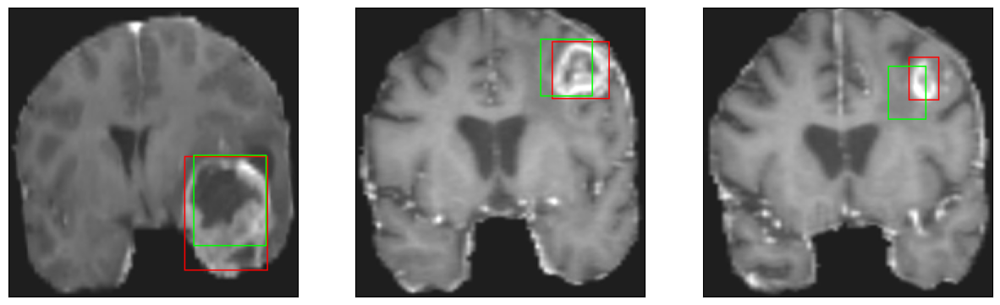

26/26 [==============================] - 2s 96ms/step - loss: 4.7457 - IoU: 0.6242 - val_loss: 9.1980 - val_IoU: 0.5284
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6788 - IoU: 0.6332
Epoch 95: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


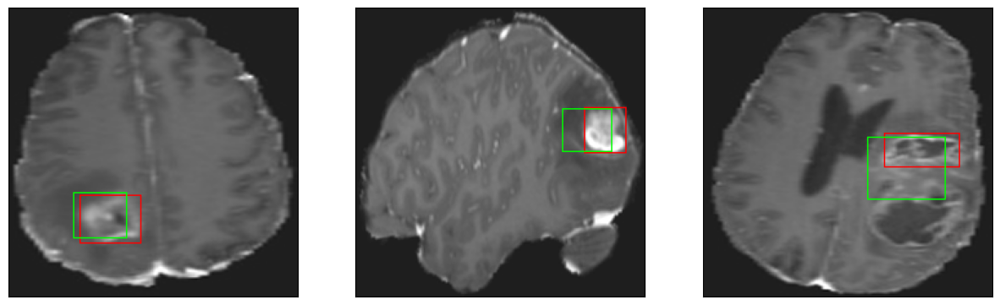

26/26 [==============================] - 3s 102ms/step - loss: 4.6738 - IoU: 0.6344 - val_loss: 11.1528 - val_IoU: 0.4461
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4638 - IoU: 0.6451
Epoch 96: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


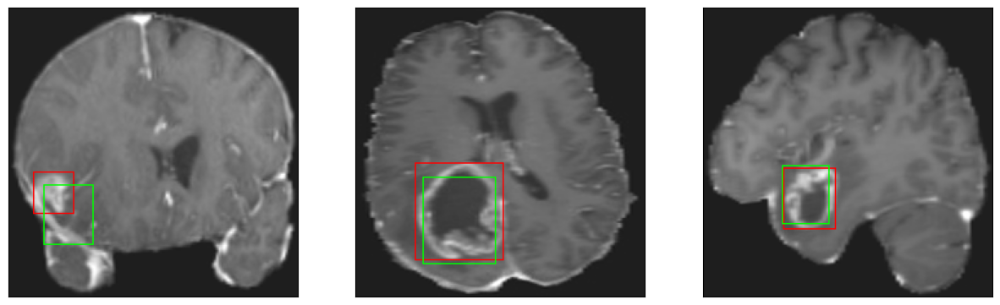

26/26 [==============================] - 3s 121ms/step - loss: 4.4919 - IoU: 0.6432 - val_loss: 9.8417 - val_IoU: 0.4973
Epoch 97/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7884 - IoU: 0.6284
Epoch 97: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


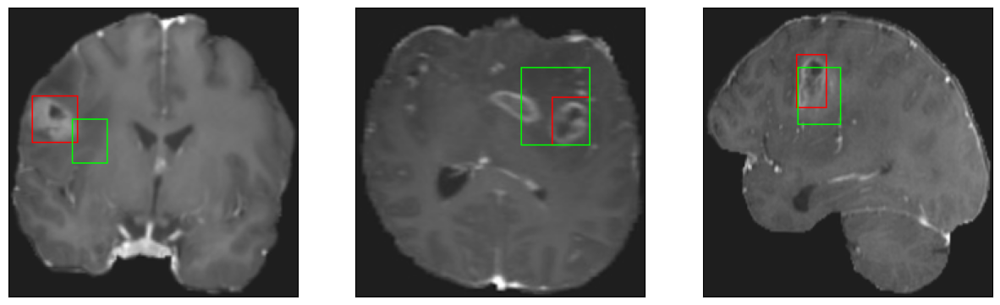

26/26 [==============================] - 3s 112ms/step - loss: 4.7703 - IoU: 0.6299 - val_loss: 10.4206 - val_IoU: 0.4564
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6925 - IoU: 0.6224
Epoch 98: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


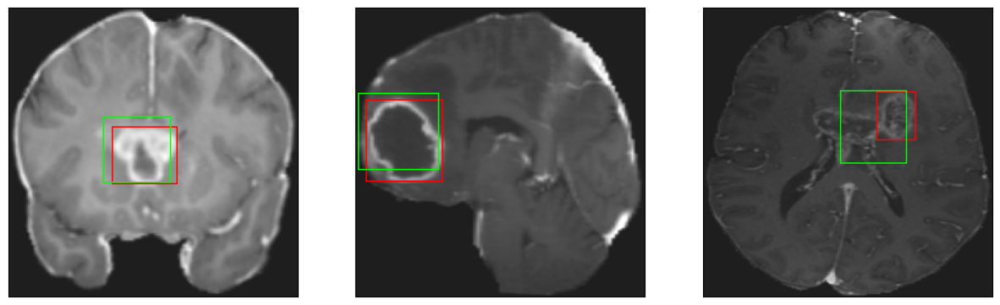

26/26 [==============================] - 3s 104ms/step - loss: 4.7189 - IoU: 0.6211 - val_loss: 9.4827 - val_IoU: 0.5170
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.8633 - IoU: 0.6103
Epoch 99: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


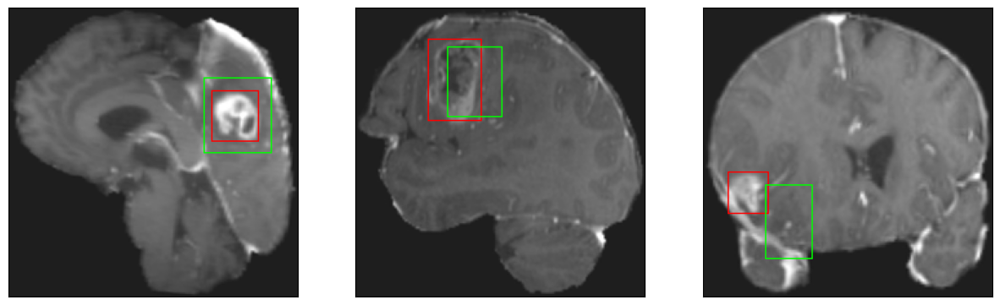

26/26 [==============================] - 3s 119ms/step - loss: 4.8633 - IoU: 0.6103 - val_loss: 12.2048 - val_IoU: 0.3770
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9152 - IoU: 0.6168
Epoch 100: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


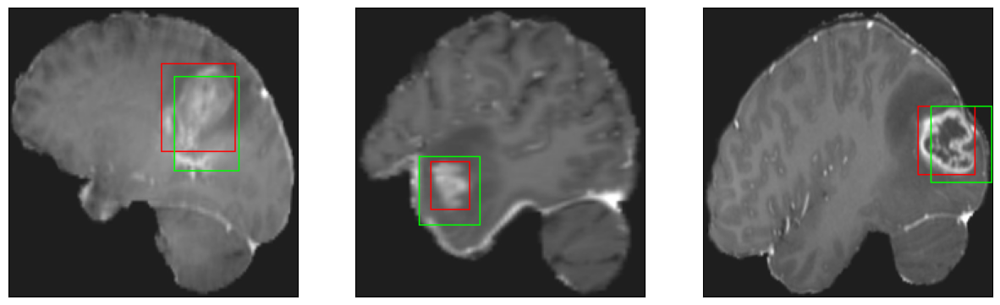

26/26 [==============================] - 3s 107ms/step - loss: 4.8924 - IoU: 0.6170 - val_loss: 10.7255 - val_IoU: 0.4933
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 4.8496 - IoU: 0.6144
Epoch 101: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


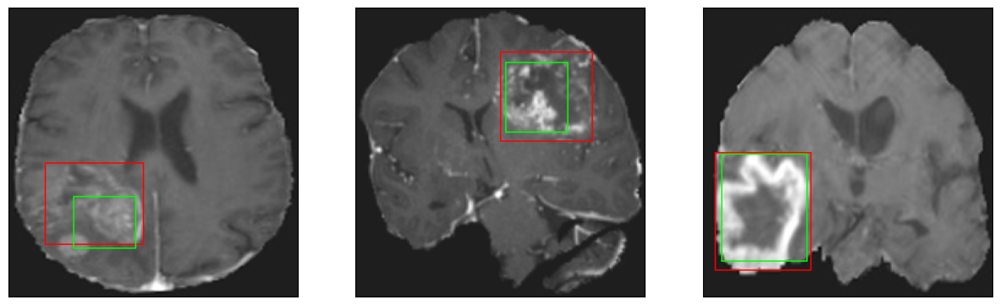

26/26 [==============================] - 3s 119ms/step - loss: 4.8496 - IoU: 0.6144 - val_loss: 10.0890 - val_IoU: 0.4968
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5381 - IoU: 0.6343
Epoch 102: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 13ms/step
4


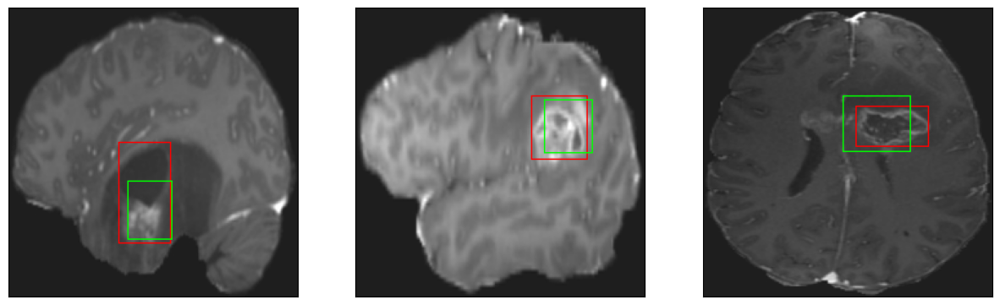

26/26 [==============================] - 3s 108ms/step - loss: 4.6008 - IoU: 0.6332 - val_loss: 10.3083 - val_IoU: 0.4732
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 4.5676 - IoU: 0.6449
Epoch 103: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


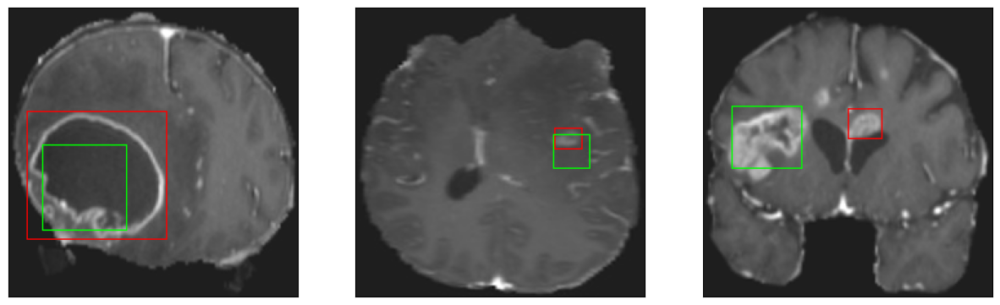

26/26 [==============================] - 3s 111ms/step - loss: 4.5676 - IoU: 0.6449 - val_loss: 11.8190 - val_IoU: 0.4317
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7842 - IoU: 0.6332
Epoch 104: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


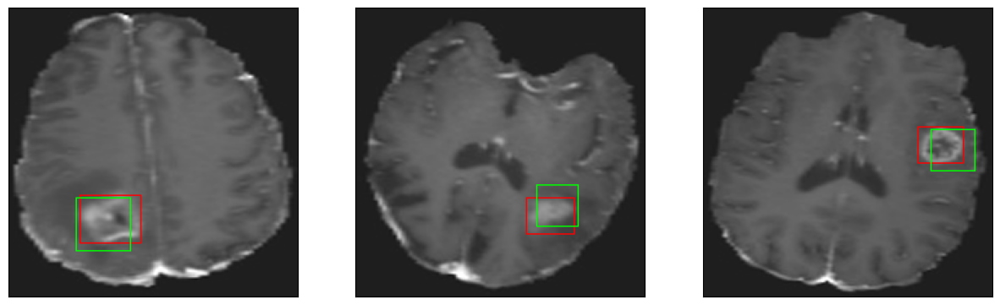

26/26 [==============================] - 3s 104ms/step - loss: 4.7513 - IoU: 0.6347 - val_loss: 9.5510 - val_IoU: 0.5260
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5914 - IoU: 0.6407
Epoch 105: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


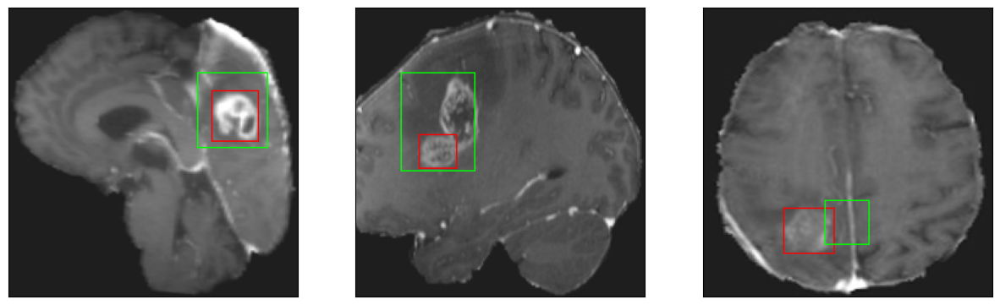

26/26 [==============================] - 3s 102ms/step - loss: 4.5715 - IoU: 0.6392 - val_loss: 13.0979 - val_IoU: 0.3957
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3458 - IoU: 0.6423
Epoch 106: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


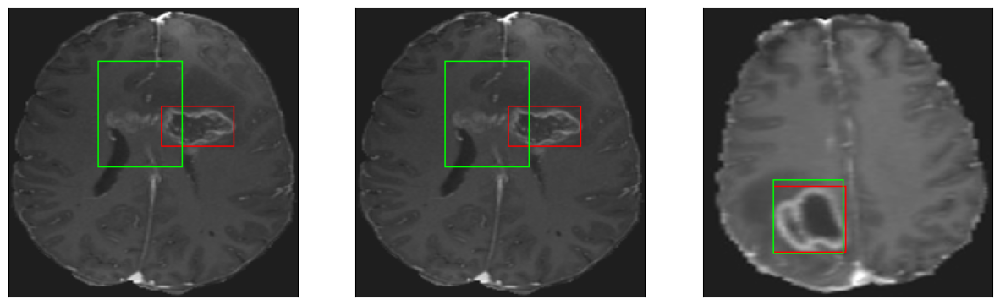

26/26 [==============================] - 3s 116ms/step - loss: 4.4080 - IoU: 0.6408 - val_loss: 15.1900 - val_IoU: 0.3576
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.6278 - IoU: 0.6320
Epoch 107: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


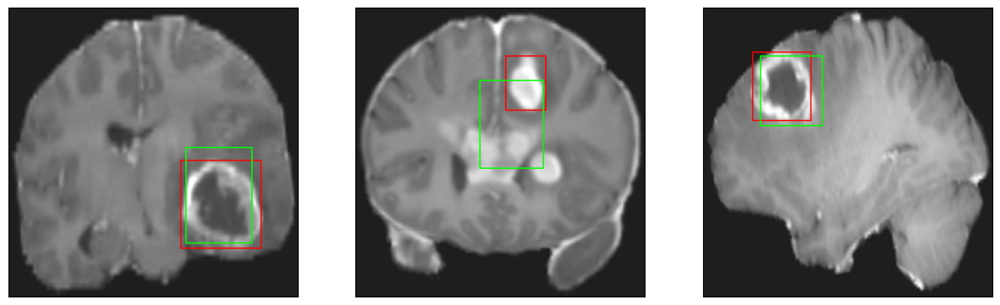

26/26 [==============================] - 3s 109ms/step - loss: 4.6278 - IoU: 0.6320 - val_loss: 9.6367 - val_IoU: 0.5045
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6877 - IoU: 0.6276
Epoch 108: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


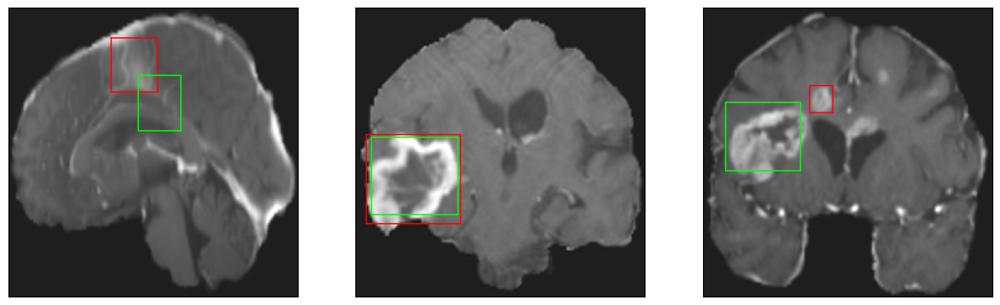

26/26 [==============================] - 3s 105ms/step - loss: 4.7378 - IoU: 0.6277 - val_loss: 9.4425 - val_IoU: 0.5110
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9409 - IoU: 0.6153
Epoch 109: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 13ms/step
4


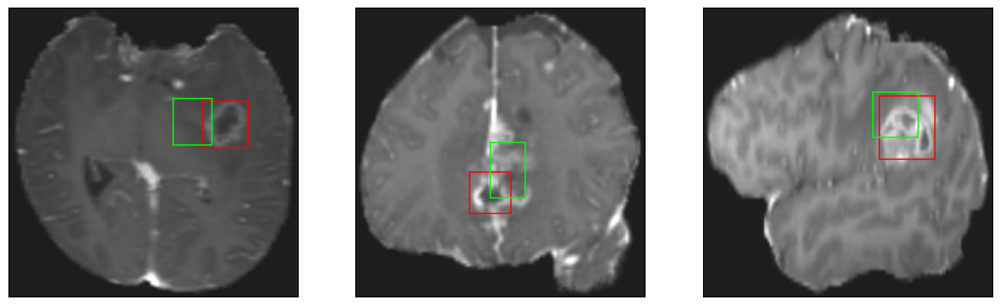

26/26 [==============================] - 3s 106ms/step - loss: 4.8993 - IoU: 0.6183 - val_loss: 9.9744 - val_IoU: 0.4928
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5676 - IoU: 0.6389
Epoch 110: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


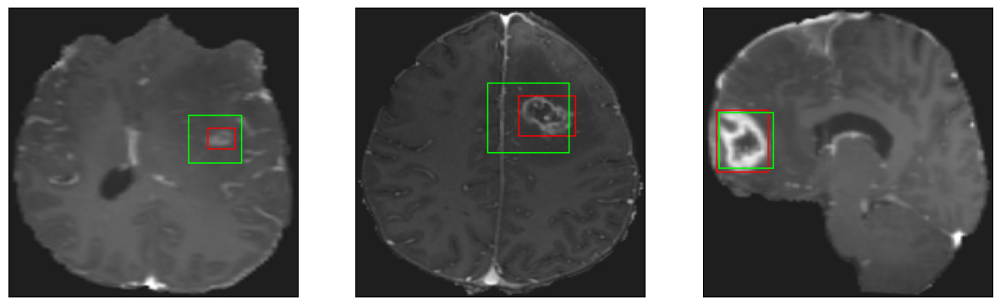

26/26 [==============================] - 3s 125ms/step - loss: 4.6002 - IoU: 0.6375 - val_loss: 10.0832 - val_IoU: 0.4916
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 4.8870 - IoU: 0.6143
Epoch 111: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


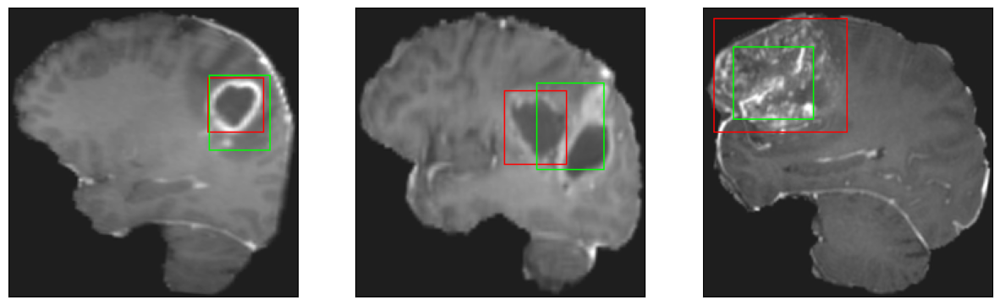

26/26 [==============================] - 3s 118ms/step - loss: 4.8870 - IoU: 0.6143 - val_loss: 9.3617 - val_IoU: 0.5154
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 4.3832 - IoU: 0.6475
Epoch 112: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


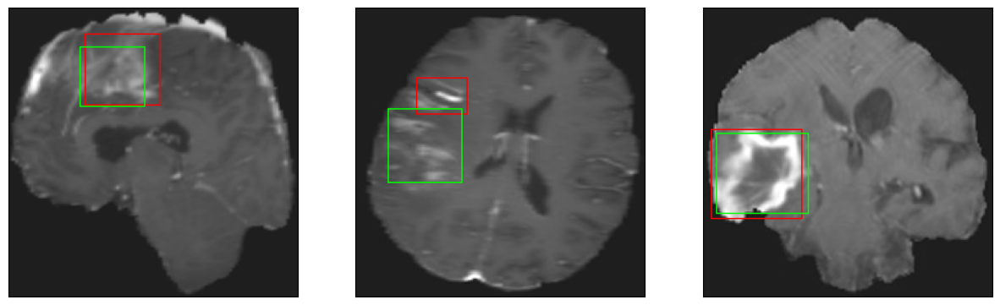

26/26 [==============================] - 3s 100ms/step - loss: 4.3832 - IoU: 0.6475 - val_loss: 9.4466 - val_IoU: 0.5263
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6062 - IoU: 0.6378
Epoch 113: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


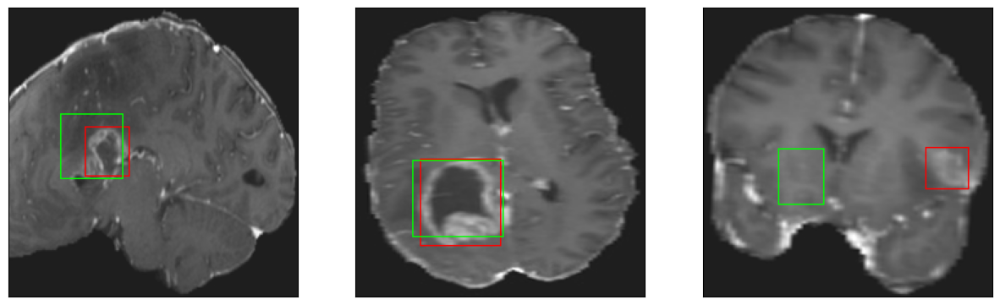

26/26 [==============================] - 3s 102ms/step - loss: 4.6261 - IoU: 0.6366 - val_loss: 10.2524 - val_IoU: 0.4547
Epoch 114/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4508 - IoU: 0.6387
Epoch 114: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


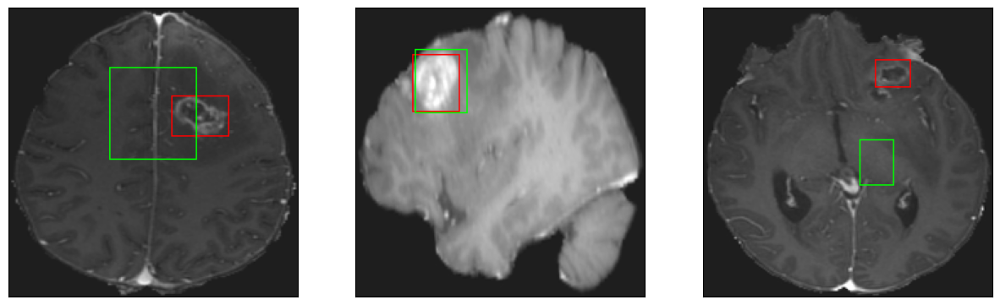

26/26 [==============================] - 3s 123ms/step - loss: 4.4364 - IoU: 0.6384 - val_loss: 10.3228 - val_IoU: 0.4889
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5481 - IoU: 0.6291
Epoch 115: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


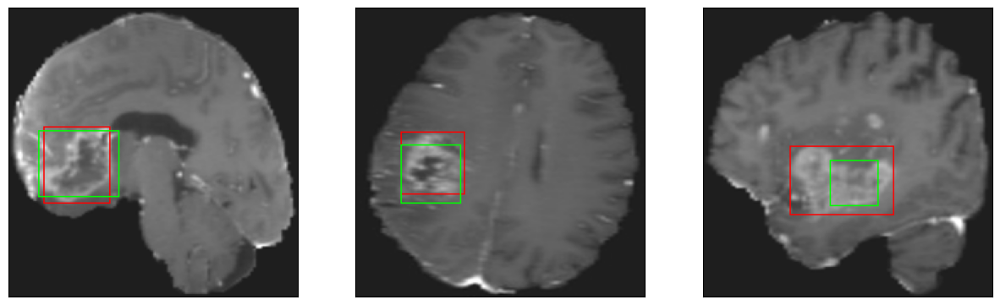

26/26 [==============================] - 3s 123ms/step - loss: 4.5477 - IoU: 0.6295 - val_loss: 10.2804 - val_IoU: 0.4727
Epoch 116/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4420 - IoU: 0.6519
Epoch 116: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


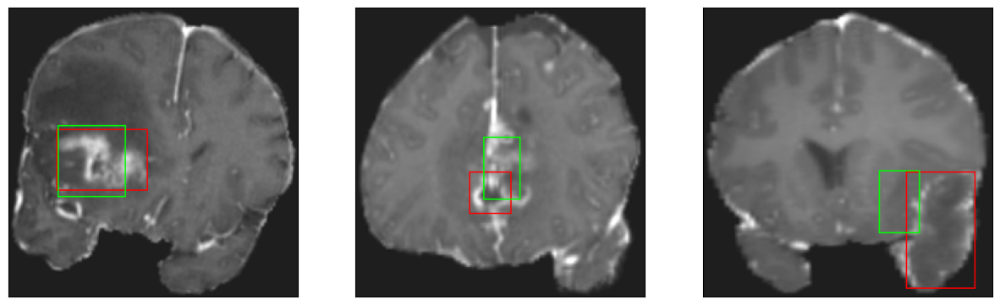

26/26 [==============================] - 3s 102ms/step - loss: 4.4402 - IoU: 0.6505 - val_loss: 9.4446 - val_IoU: 0.5176
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5980 - IoU: 0.6409
Epoch 117: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


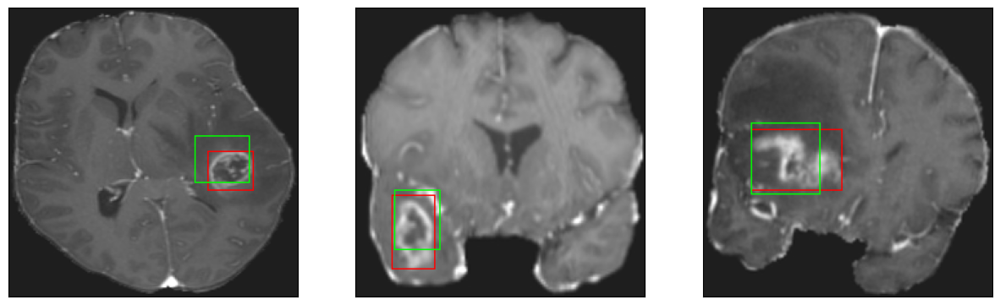

26/26 [==============================] - 3s 99ms/step - loss: 4.5755 - IoU: 0.6426 - val_loss: 10.5417 - val_IoU: 0.4375
Epoch 118/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4116 - IoU: 0.6496
Epoch 118: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


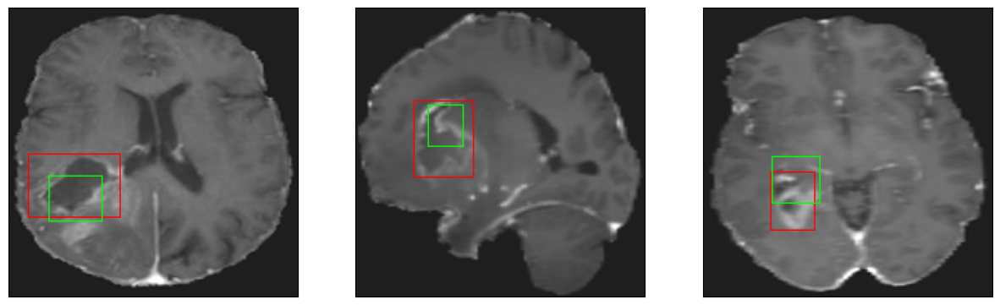

26/26 [==============================] - 3s 124ms/step - loss: 4.4097 - IoU: 0.6491 - val_loss: 11.5806 - val_IoU: 0.4098
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.4590 - IoU: 0.6438
Epoch 119: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


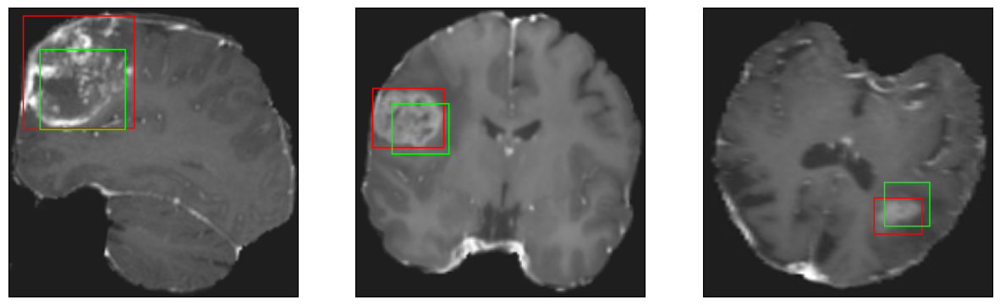

26/26 [==============================] - 3s 113ms/step - loss: 4.4590 - IoU: 0.6438 - val_loss: 10.5868 - val_IoU: 0.4647
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.5289 - IoU: 0.6527
Epoch 120: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


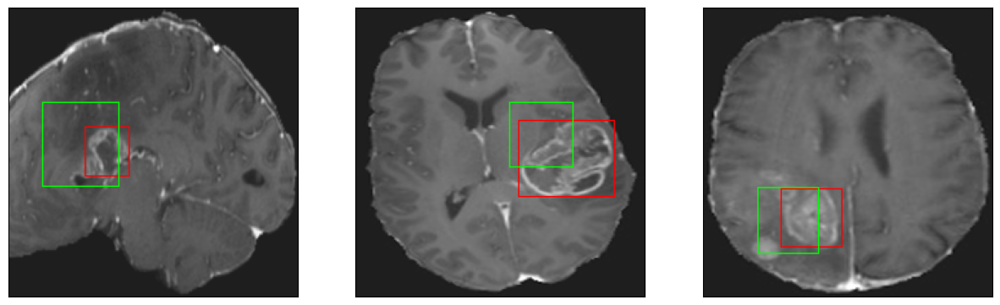

26/26 [==============================] - 3s 103ms/step - loss: 4.5289 - IoU: 0.6527 - val_loss: 12.0365 - val_IoU: 0.4280
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5276 - IoU: 0.6369
Epoch 121: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


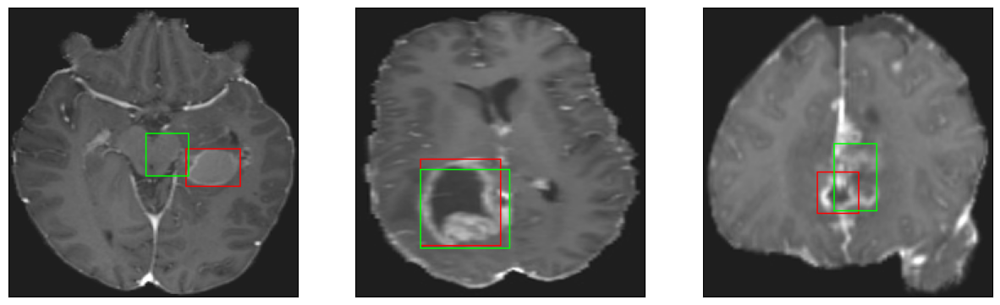

26/26 [==============================] - 3s 103ms/step - loss: 4.5111 - IoU: 0.6360 - val_loss: 9.0134 - val_IoU: 0.5273
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 4.4644 - IoU: 0.6392
Epoch 122: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


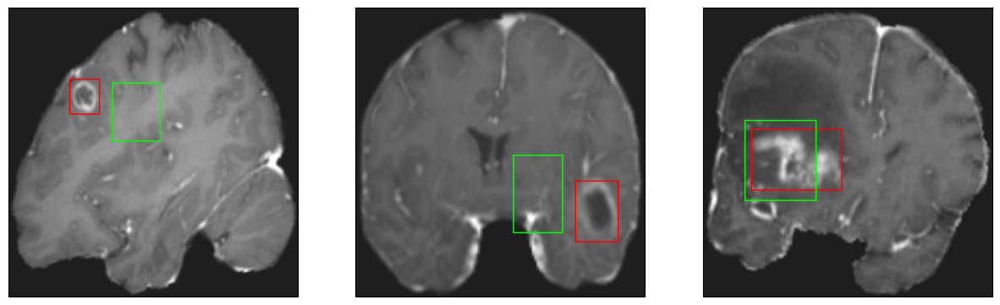

26/26 [==============================] - 4s 140ms/step - loss: 4.4644 - IoU: 0.6392 - val_loss: 13.1570 - val_IoU: 0.4182
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2195 - IoU: 0.6628
Epoch 123: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


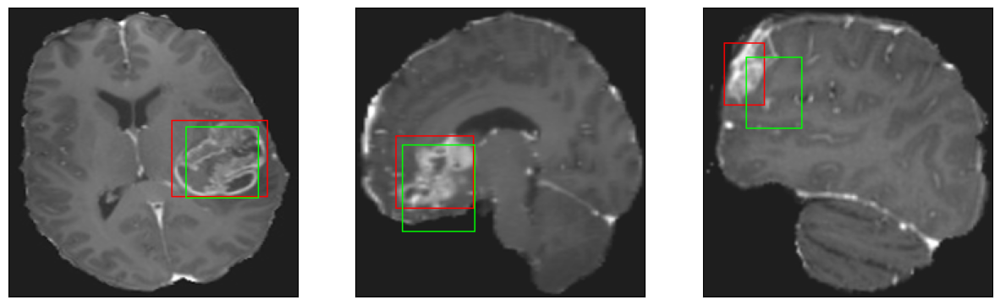

26/26 [==============================] - 3s 107ms/step - loss: 4.2704 - IoU: 0.6599 - val_loss: 11.9681 - val_IoU: 0.4147
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 4.4558 - IoU: 0.6434
Epoch 124: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


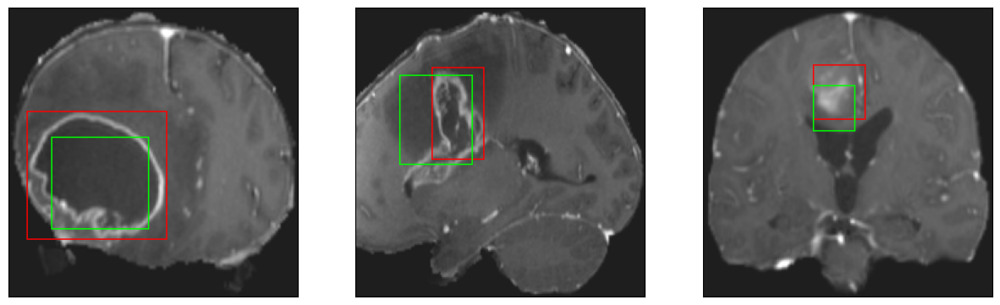

26/26 [==============================] - 3s 102ms/step - loss: 4.4558 - IoU: 0.6434 - val_loss: 9.3655 - val_IoU: 0.5289
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 4.2829 - IoU: 0.6456
Epoch 125: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


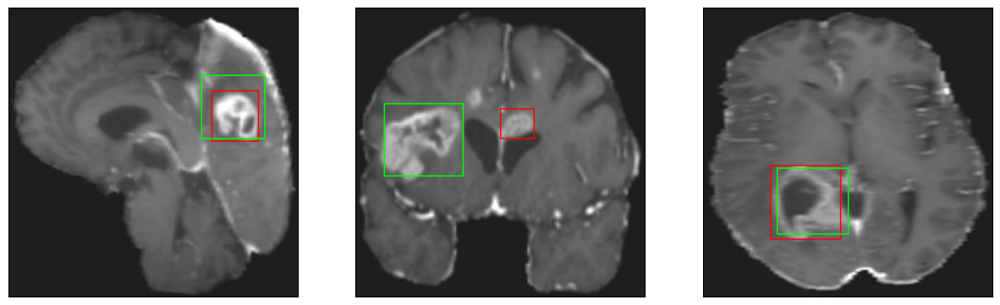

26/26 [==============================] - 3s 98ms/step - loss: 4.2829 - IoU: 0.6456 - val_loss: 9.1135 - val_IoU: 0.5301
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 4.3353 - IoU: 0.6468
Epoch 126: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


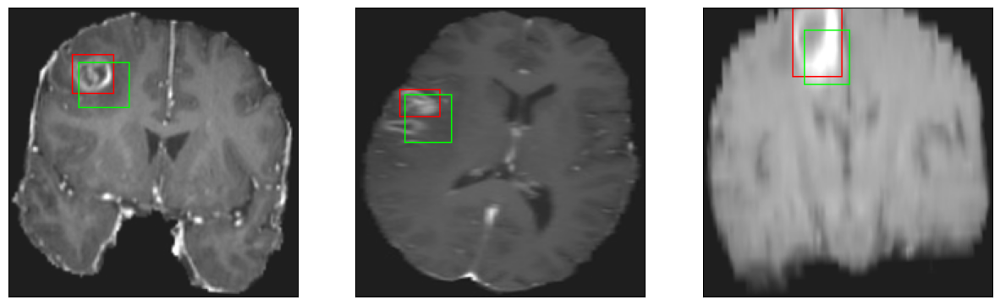

26/26 [==============================] - 3s 104ms/step - loss: 4.3353 - IoU: 0.6468 - val_loss: 10.1739 - val_IoU: 0.4547
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 4.4372 - IoU: 0.6464
Epoch 127: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


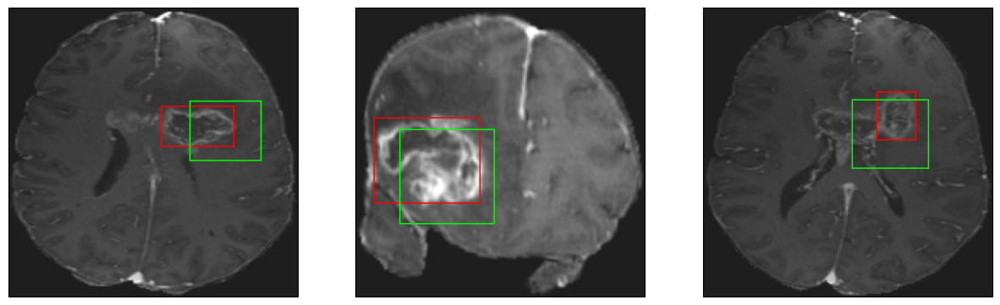

26/26 [==============================] - 3s 122ms/step - loss: 4.4372 - IoU: 0.6464 - val_loss: 11.1764 - val_IoU: 0.4204
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 4.7537 - IoU: 0.6351
Epoch 128: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


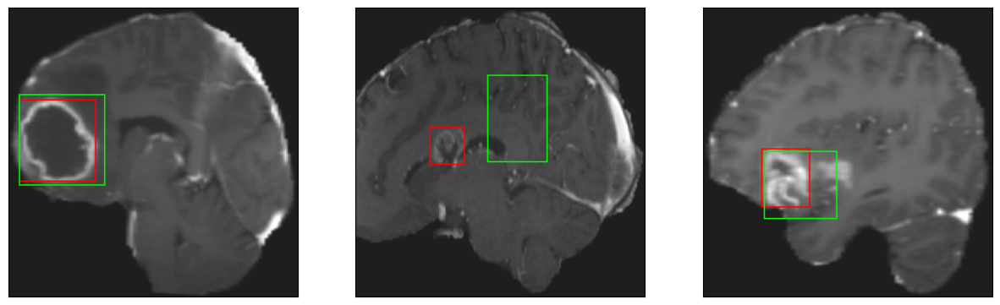

26/26 [==============================] - 3s 125ms/step - loss: 4.7537 - IoU: 0.6351 - val_loss: 11.8338 - val_IoU: 0.4344
Epoch 129/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4986 - IoU: 0.6445
Epoch 129: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


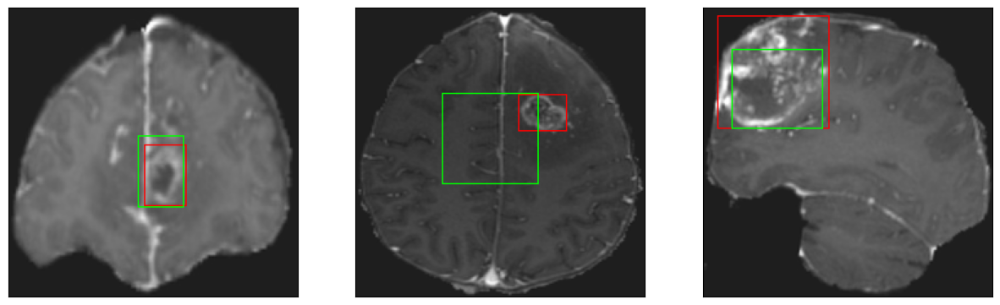

26/26 [==============================] - 3s 106ms/step - loss: 4.5391 - IoU: 0.6416 - val_loss: 10.9547 - val_IoU: 0.4232
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 4.3442 - IoU: 0.6522
Epoch 130: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


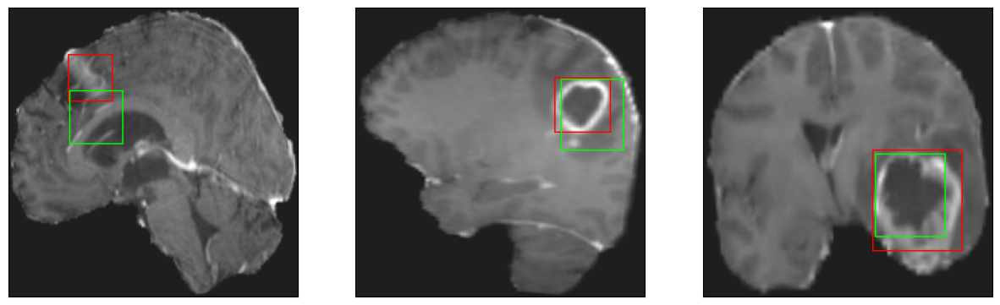

26/26 [==============================] - 3s 103ms/step - loss: 4.3442 - IoU: 0.6522 - val_loss: 9.5707 - val_IoU: 0.5098
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.3291 - IoU: 0.6612
Epoch 131: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


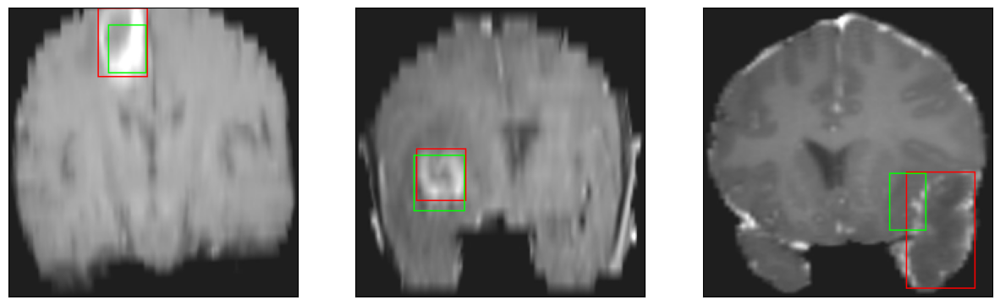

26/26 [==============================] - 3s 116ms/step - loss: 4.3291 - IoU: 0.6612 - val_loss: 9.8657 - val_IoU: 0.5028
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.5688 - IoU: 0.6359
Epoch 132: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


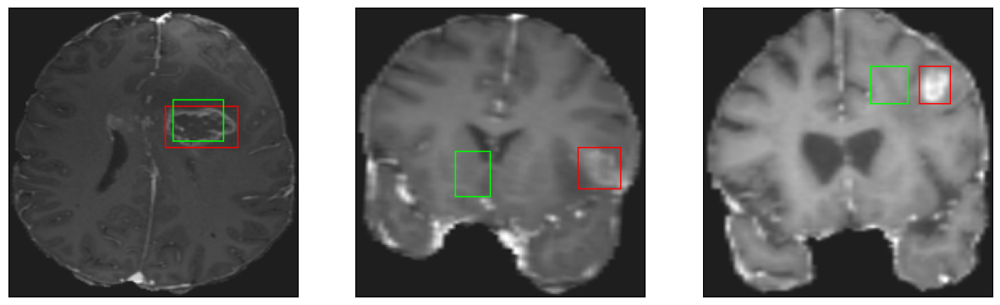

26/26 [==============================] - 3s 108ms/step - loss: 4.5688 - IoU: 0.6359 - val_loss: 10.9959 - val_IoU: 0.4356
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2294 - IoU: 0.6553
Epoch 133: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


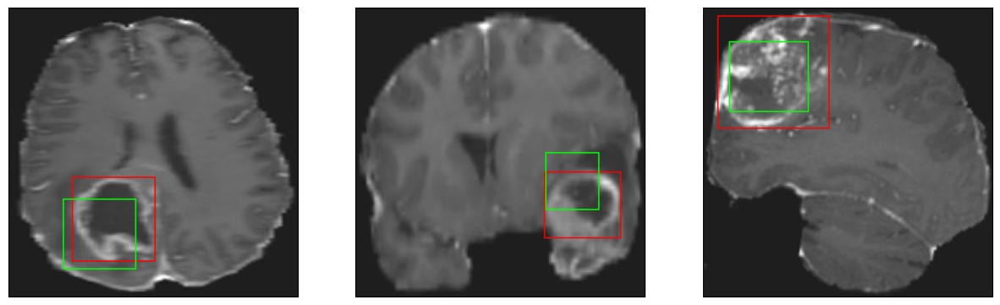

26/26 [==============================] - 3s 101ms/step - loss: 4.2397 - IoU: 0.6549 - val_loss: 9.4480 - val_IoU: 0.5132
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4459 - IoU: 0.6437
Epoch 134: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


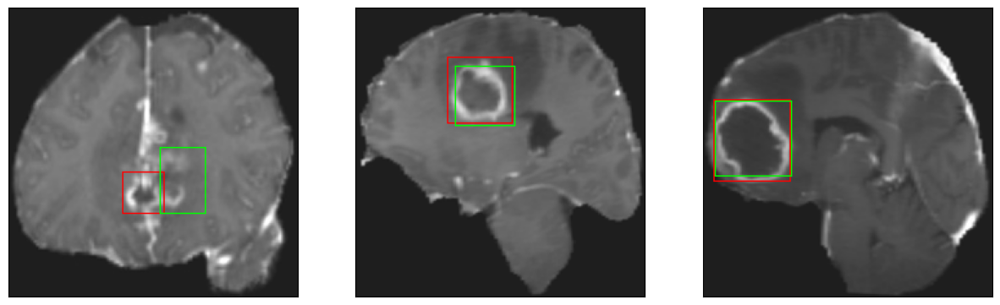

26/26 [==============================] - 3s 112ms/step - loss: 4.4293 - IoU: 0.6446 - val_loss: 10.8827 - val_IoU: 0.4288
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.1707 - IoU: 0.6561
Epoch 135: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


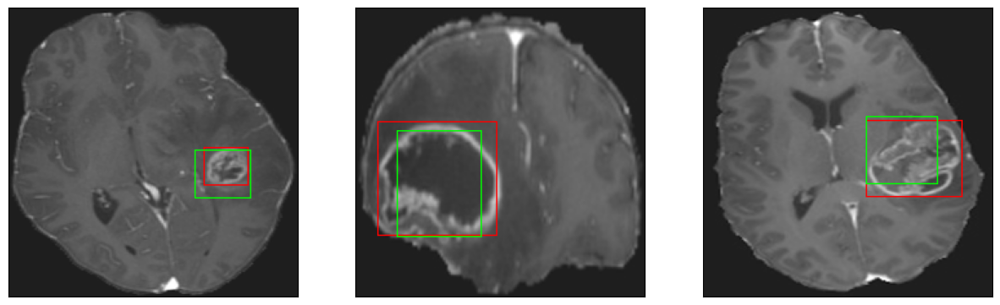

26/26 [==============================] - 3s 127ms/step - loss: 4.1707 - IoU: 0.6561 - val_loss: 9.0376 - val_IoU: 0.5332
Epoch 136/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2832 - IoU: 0.6502
Epoch 136: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


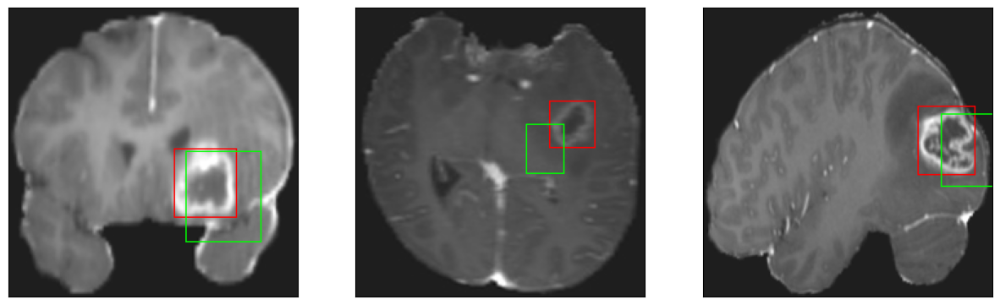

26/26 [==============================] - 3s 98ms/step - loss: 4.3441 - IoU: 0.6472 - val_loss: 10.3037 - val_IoU: 0.4497
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.1874 - IoU: 0.6608
Epoch 137: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


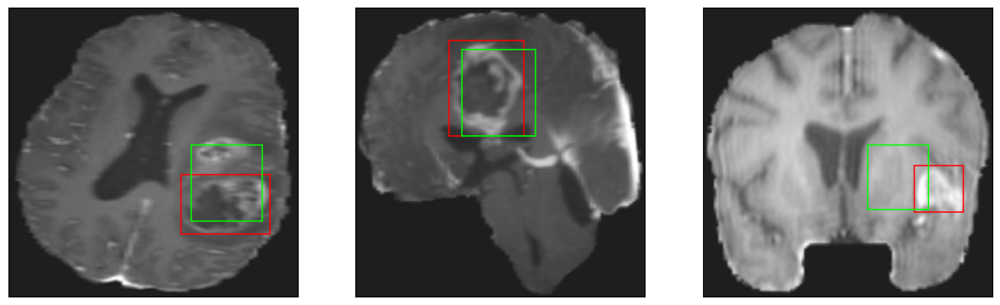

26/26 [==============================] - 3s 101ms/step - loss: 4.1874 - IoU: 0.6608 - val_loss: 9.4507 - val_IoU: 0.5142
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3220 - IoU: 0.6450
Epoch 138: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


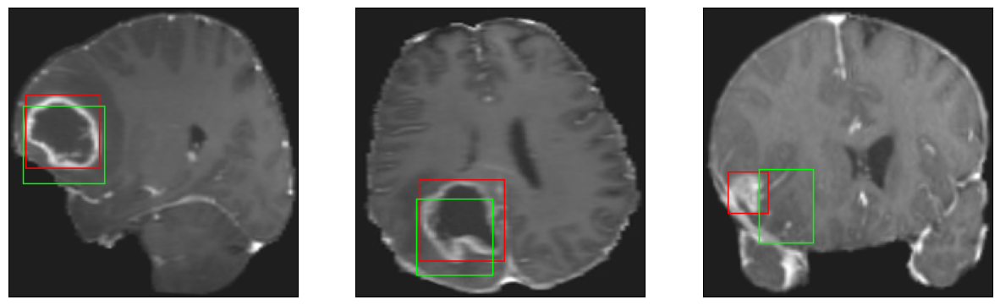

26/26 [==============================] - 3s 113ms/step - loss: 4.2977 - IoU: 0.6471 - val_loss: 10.1510 - val_IoU: 0.4945
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1330 - IoU: 0.6654
Epoch 139: val_IoU did not improve from 0.54261
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


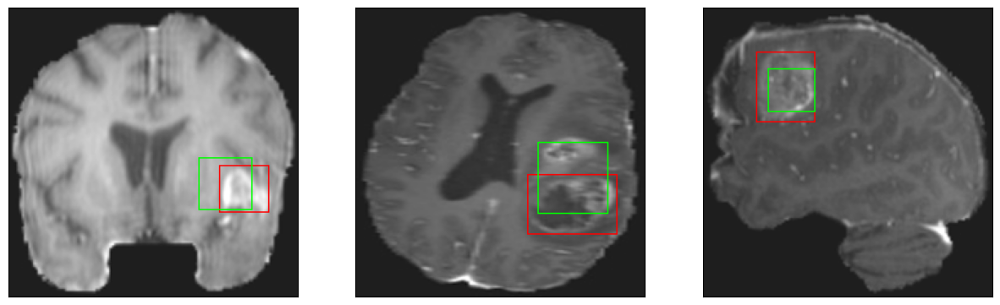

26/26 [==============================] - 3s 106ms/step - loss: 4.1546 - IoU: 0.6651 - val_loss: 9.4020 - val_IoU: 0.5233
Epoch 140/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3624 - IoU: 0.6584
Epoch 140: val_IoU improved from 0.54261 to 0.54717, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


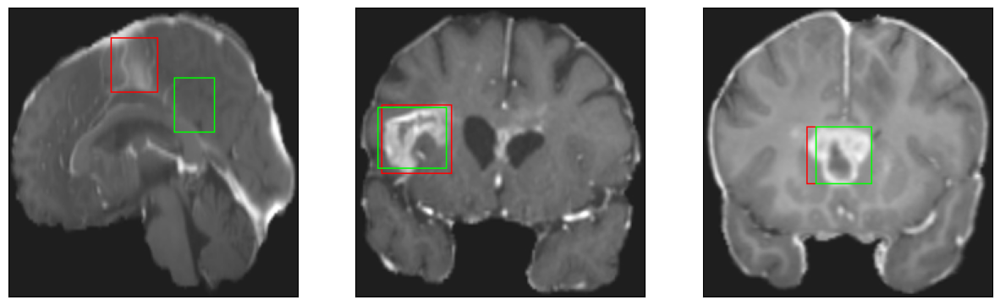

26/26 [==============================] - 4s 174ms/step - loss: 4.3376 - IoU: 0.6581 - val_loss: 9.1570 - val_IoU: 0.5472
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.4982 - IoU: 0.6452
Epoch 141: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


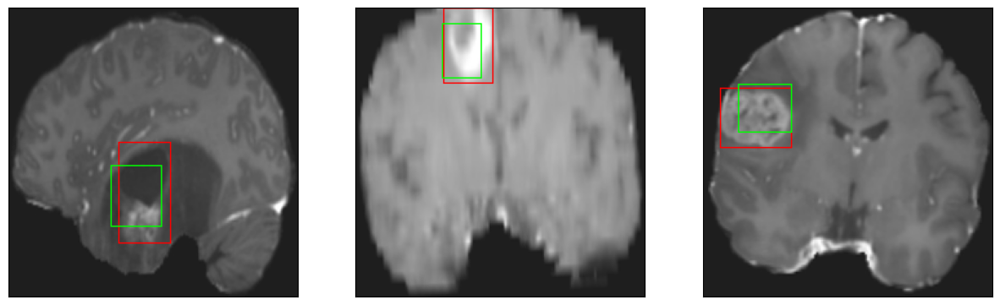

26/26 [==============================] - 3s 108ms/step - loss: 4.4982 - IoU: 0.6452 - val_loss: 9.5590 - val_IoU: 0.4915
Epoch 142/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2013 - IoU: 0.6564
Epoch 142: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


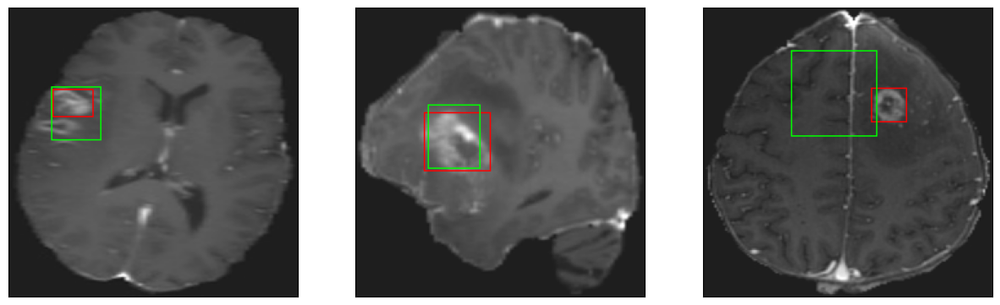

26/26 [==============================] - 3s 120ms/step - loss: 4.2235 - IoU: 0.6550 - val_loss: 10.4165 - val_IoU: 0.4711
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3146 - IoU: 0.6485
Epoch 143: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


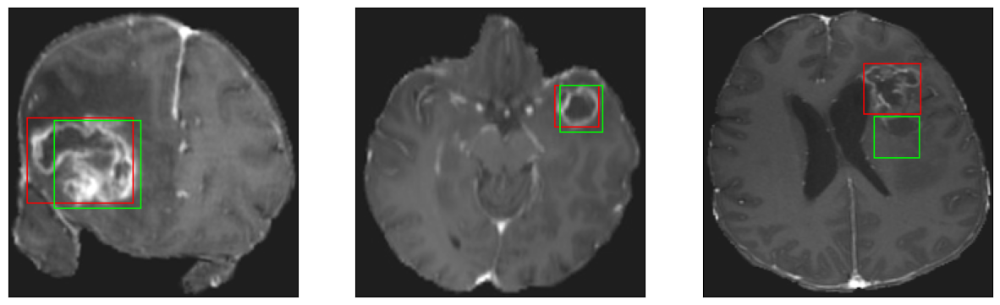

26/26 [==============================] - 3s 116ms/step - loss: 4.2722 - IoU: 0.6515 - val_loss: 9.7410 - val_IoU: 0.4980
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 4.6431 - IoU: 0.6403
Epoch 144: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


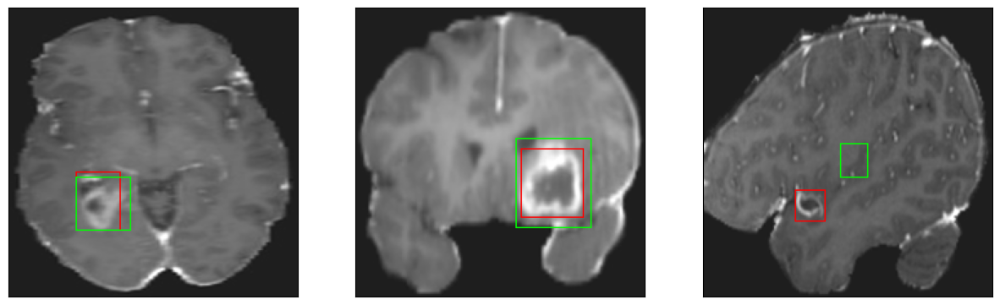

26/26 [==============================] - 4s 143ms/step - loss: 4.6431 - IoU: 0.6403 - val_loss: 9.0853 - val_IoU: 0.5418
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 4.6340 - IoU: 0.6433
Epoch 145: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


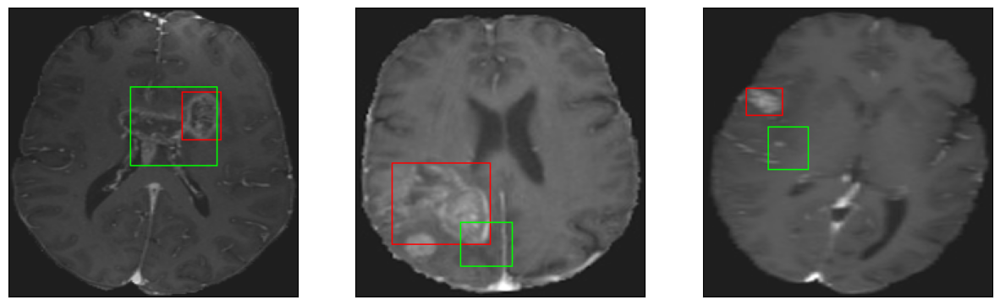

26/26 [==============================] - 3s 112ms/step - loss: 4.6340 - IoU: 0.6433 - val_loss: 12.6337 - val_IoU: 0.3518
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 4.3490 - IoU: 0.6467
Epoch 146: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


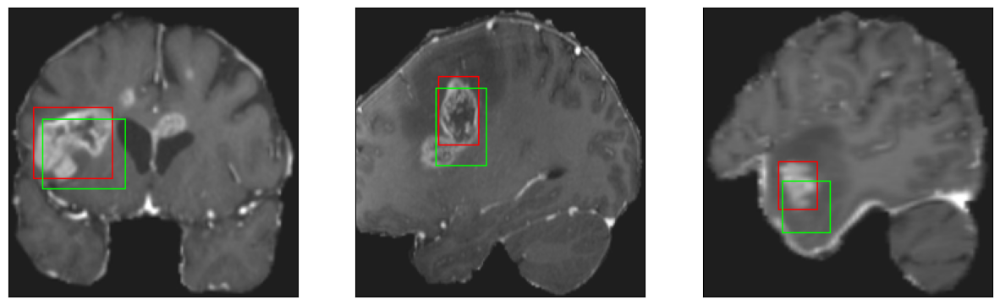

26/26 [==============================] - 3s 106ms/step - loss: 4.3490 - IoU: 0.6467 - val_loss: 12.3827 - val_IoU: 0.3347
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.2933 - IoU: 0.6538
Epoch 147: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


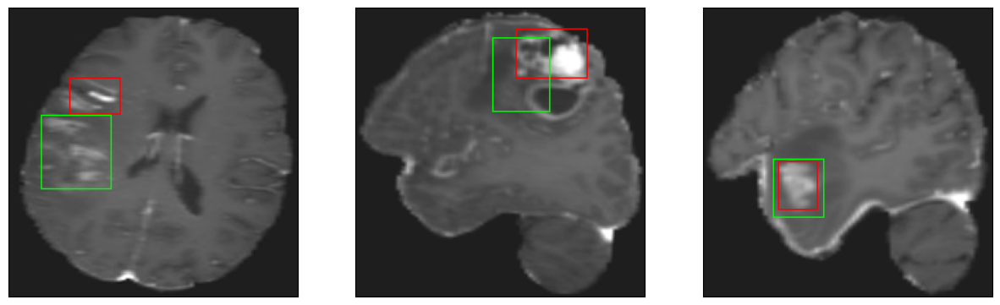

26/26 [==============================] - 3s 122ms/step - loss: 4.2933 - IoU: 0.6538 - val_loss: 9.3205 - val_IoU: 0.5064
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3379 - IoU: 0.6497
Epoch 148: val_IoU did not improve from 0.54717
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


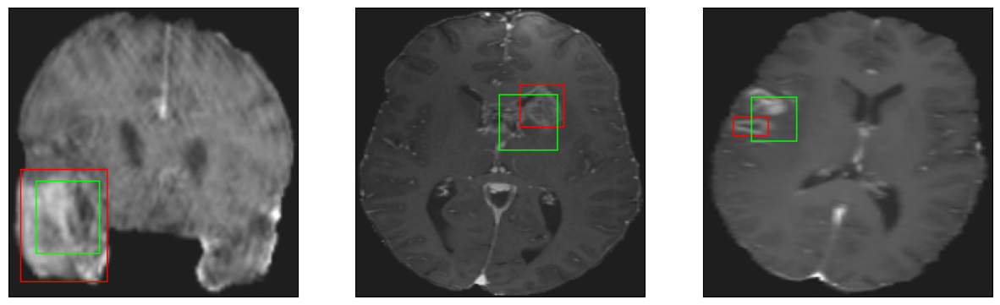

26/26 [==============================] - 3s 101ms/step - loss: 4.3406 - IoU: 0.6500 - val_loss: 9.5013 - val_IoU: 0.5164
Epoch 149/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1219 - IoU: 0.6631
Epoch 149: val_IoU improved from 0.54717 to 0.54985, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


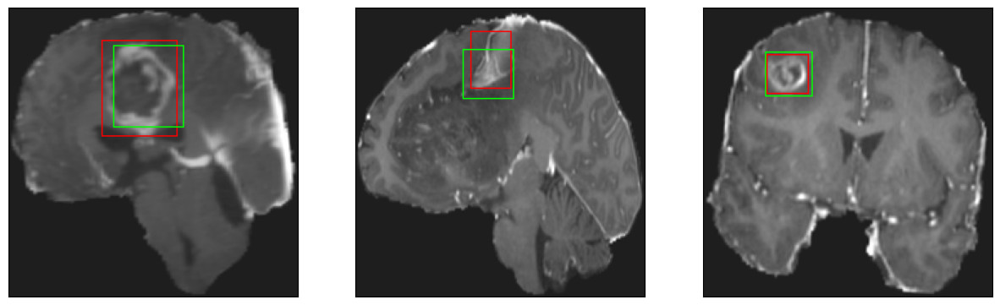

26/26 [==============================] - 5s 199ms/step - loss: 4.0907 - IoU: 0.6645 - val_loss: 8.6535 - val_IoU: 0.5499
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 4.0945 - IoU: 0.6651
Epoch 150: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


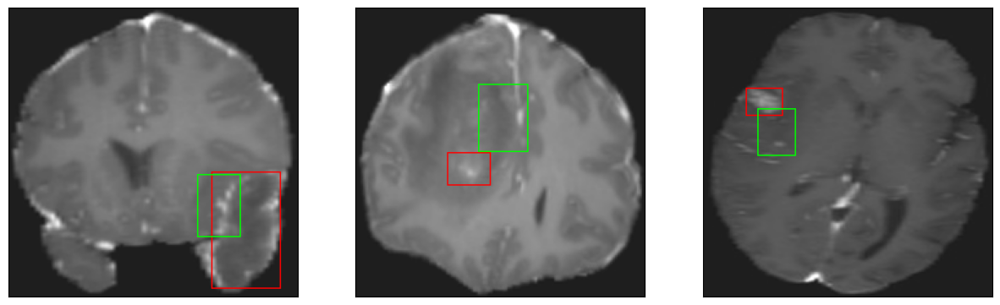

26/26 [==============================] - 3s 108ms/step - loss: 4.0945 - IoU: 0.6651 - val_loss: 9.3193 - val_IoU: 0.5217
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 4.2944 - IoU: 0.6532
Epoch 151: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


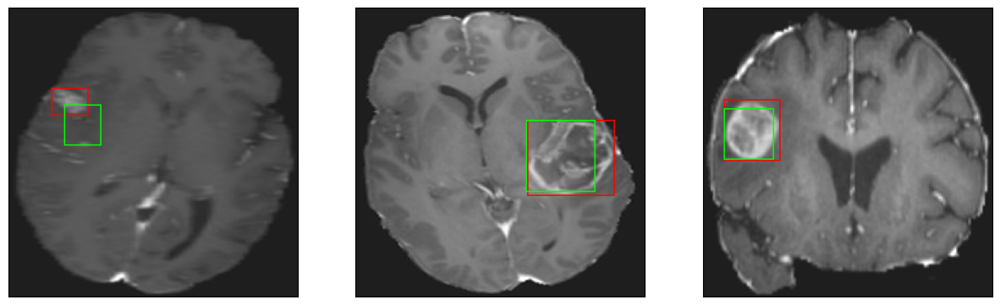

26/26 [==============================] - 3s 111ms/step - loss: 4.2944 - IoU: 0.6532 - val_loss: 9.2569 - val_IoU: 0.5333
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1505 - IoU: 0.6634
Epoch 152: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


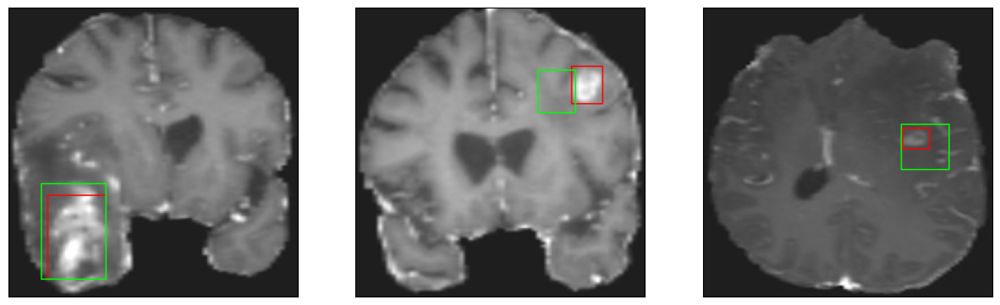

26/26 [==============================] - 3s 122ms/step - loss: 4.1599 - IoU: 0.6627 - val_loss: 9.5620 - val_IoU: 0.4975
Epoch 153/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1126 - IoU: 0.6638
Epoch 153: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


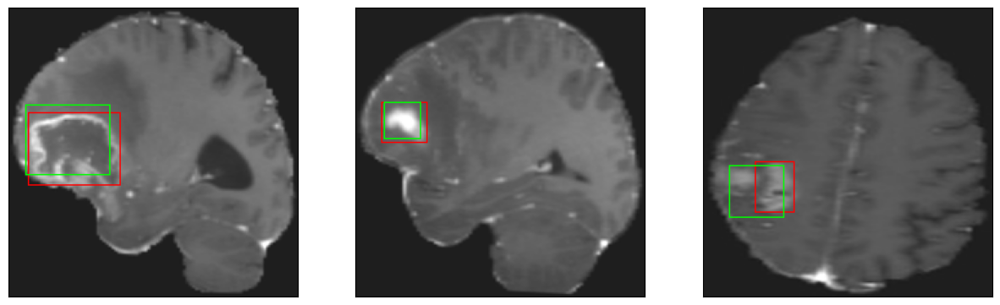

26/26 [==============================] - 3s 102ms/step - loss: 4.1018 - IoU: 0.6637 - val_loss: 10.4468 - val_IoU: 0.4400
Epoch 154/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2455 - IoU: 0.6552
Epoch 154: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


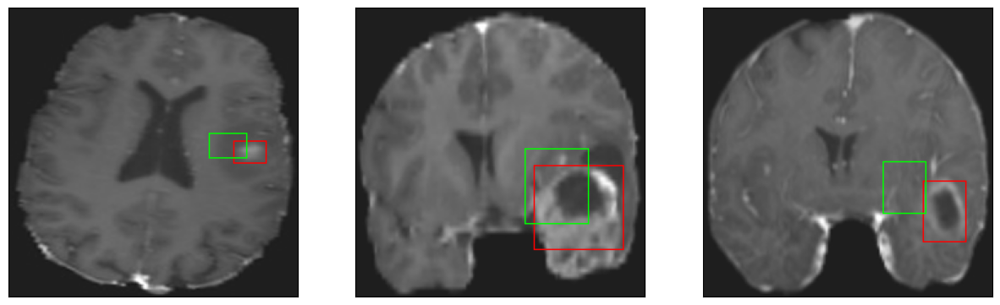

26/26 [==============================] - 3s 108ms/step - loss: 4.2387 - IoU: 0.6561 - val_loss: 11.5316 - val_IoU: 0.3870
Epoch 155/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2932 - IoU: 0.6551
Epoch 155: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


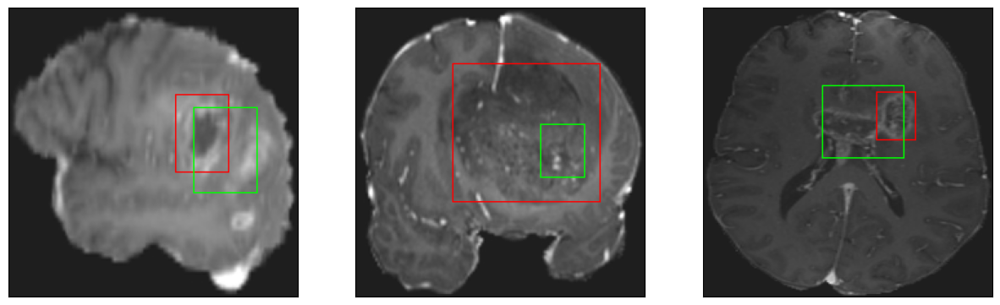

26/26 [==============================] - 3s 98ms/step - loss: 4.2903 - IoU: 0.6552 - val_loss: 10.2318 - val_IoU: 0.4592
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6016 - IoU: 0.6278
Epoch 156: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


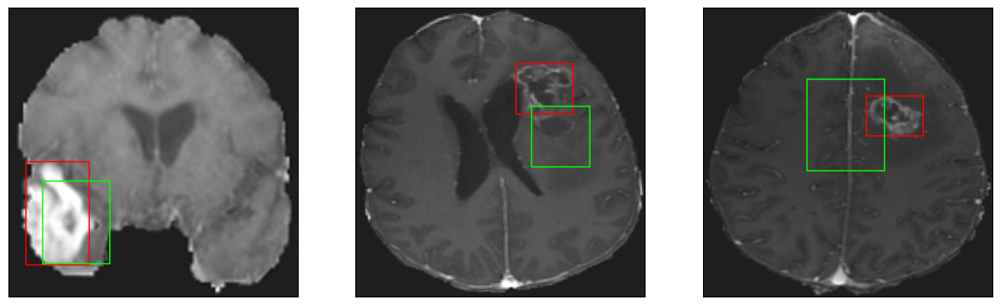

26/26 [==============================] - 3s 111ms/step - loss: 4.6082 - IoU: 0.6275 - val_loss: 12.8405 - val_IoU: 0.3389
Epoch 157/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5141 - IoU: 0.6413
Epoch 157: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


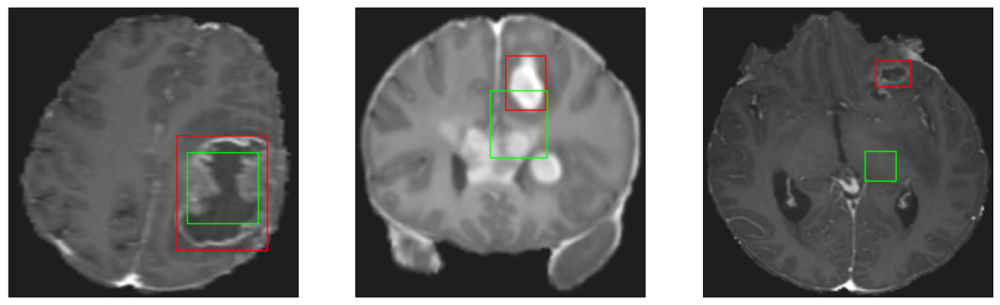

26/26 [==============================] - 3s 122ms/step - loss: 4.5364 - IoU: 0.6406 - val_loss: 9.7032 - val_IoU: 0.5075
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3908 - IoU: 0.6404
Epoch 158: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


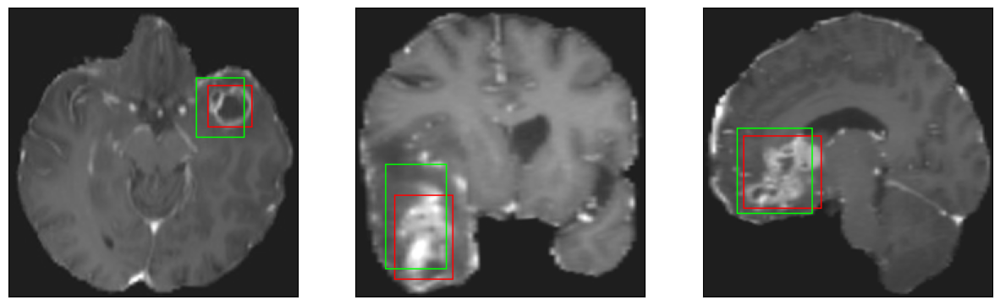

26/26 [==============================] - 3s 105ms/step - loss: 4.4257 - IoU: 0.6404 - val_loss: 9.5236 - val_IoU: 0.5259
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1878 - IoU: 0.6615
Epoch 159: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


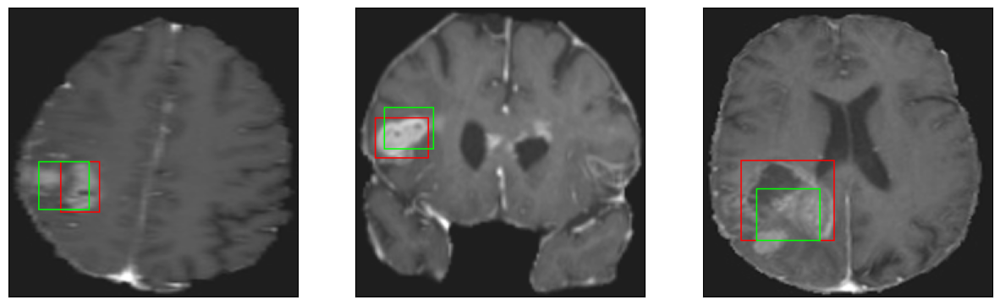

26/26 [==============================] - 3s 103ms/step - loss: 4.2316 - IoU: 0.6605 - val_loss: 10.7254 - val_IoU: 0.4506
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1675 - IoU: 0.6626
Epoch 160: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


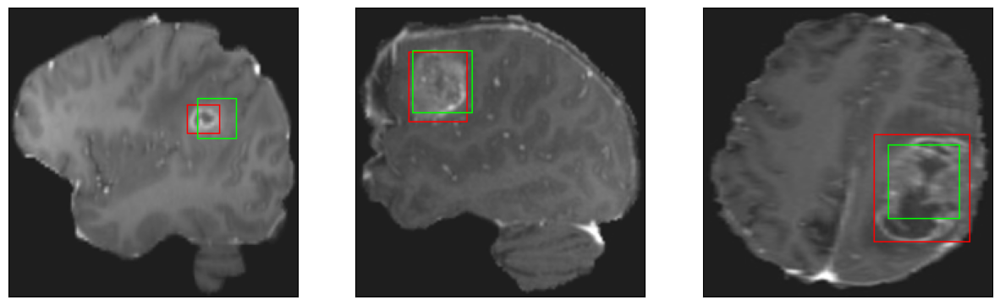

26/26 [==============================] - 2s 97ms/step - loss: 4.1562 - IoU: 0.6619 - val_loss: 9.9296 - val_IoU: 0.5016
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 4.0646 - IoU: 0.6690
Epoch 161: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


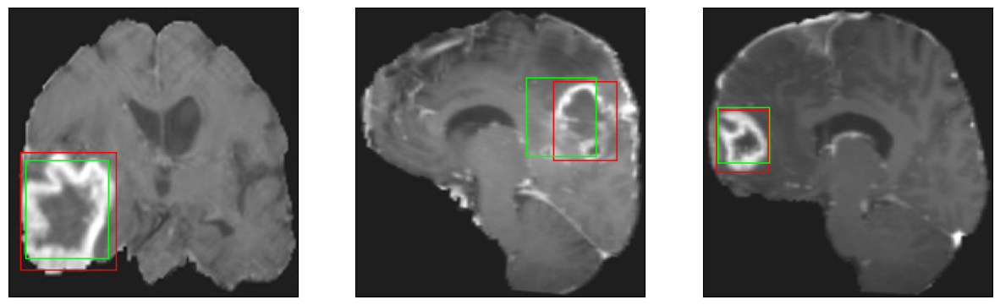

26/26 [==============================] - 3s 129ms/step - loss: 4.0646 - IoU: 0.6690 - val_loss: 9.4909 - val_IoU: 0.5164
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1329 - IoU: 0.6641
Epoch 162: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


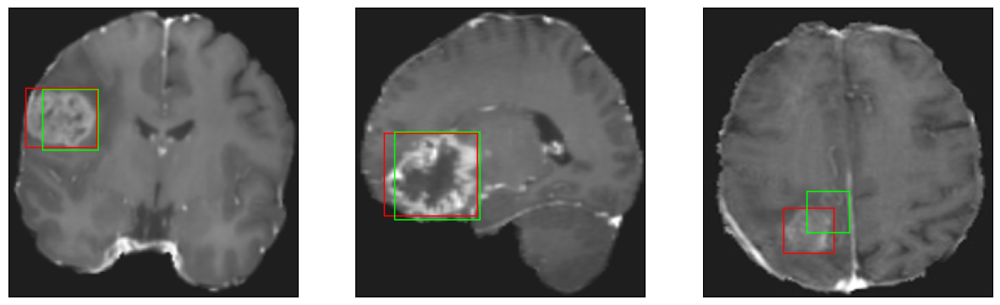

26/26 [==============================] - 3s 116ms/step - loss: 4.1347 - IoU: 0.6626 - val_loss: 10.5295 - val_IoU: 0.4772
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3837 - IoU: 0.6398
Epoch 163: val_IoU did not improve from 0.54985
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


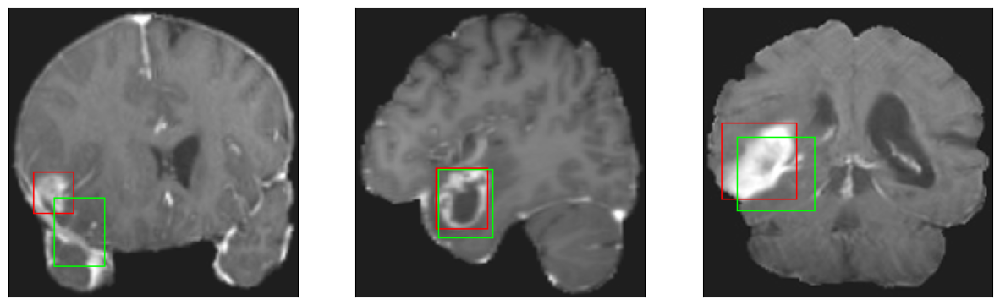

26/26 [==============================] - 3s 120ms/step - loss: 4.4093 - IoU: 0.6387 - val_loss: 11.7934 - val_IoU: 0.3951
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.5463 - IoU: 0.6436
Epoch 164: val_IoU improved from 0.54985 to 0.55118, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


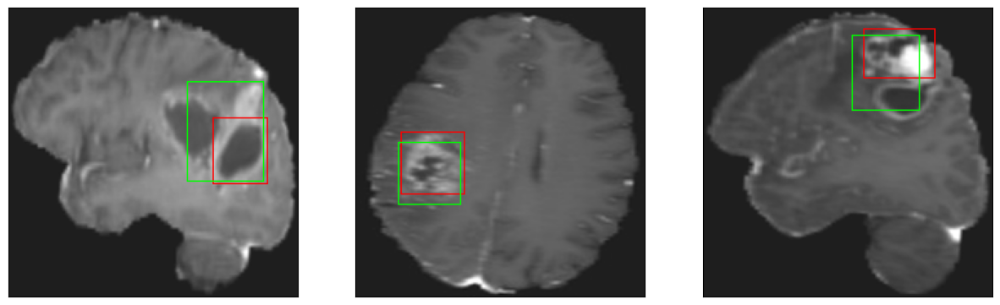

26/26 [==============================] - 4s 163ms/step - loss: 4.5463 - IoU: 0.6436 - val_loss: 8.8352 - val_IoU: 0.5512
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2070 - IoU: 0.6518
Epoch 165: val_IoU did not improve from 0.55118
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


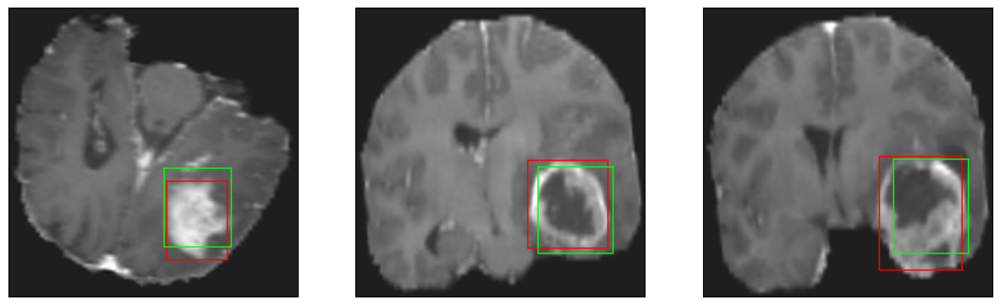

26/26 [==============================] - 3s 125ms/step - loss: 4.2224 - IoU: 0.6519 - val_loss: 9.2927 - val_IoU: 0.5279
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 4.3027 - IoU: 0.6610
Epoch 166: val_IoU did not improve from 0.55118
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


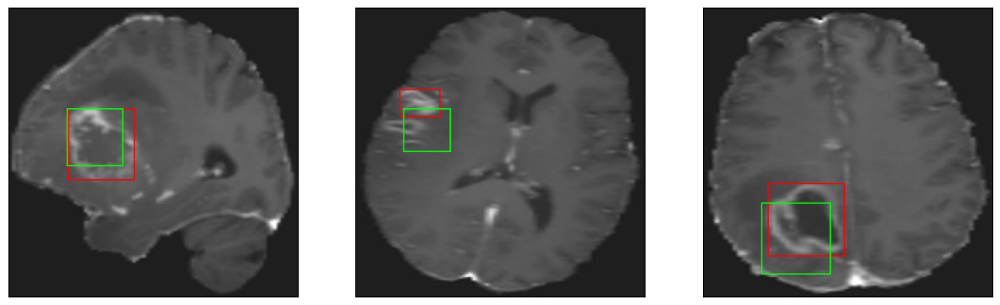

26/26 [==============================] - 3s 106ms/step - loss: 4.3027 - IoU: 0.6610 - val_loss: 9.8823 - val_IoU: 0.4831
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3828 - IoU: 0.6388
Epoch 167: val_IoU did not improve from 0.55118
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


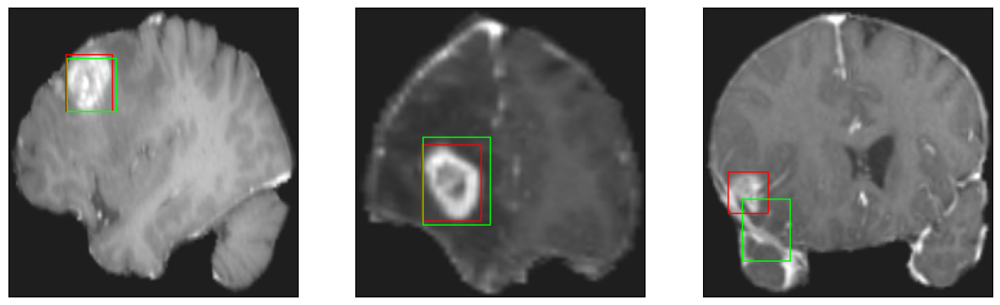

26/26 [==============================] - 3s 101ms/step - loss: 4.3980 - IoU: 0.6412 - val_loss: 10.8854 - val_IoU: 0.4209
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.3152 - IoU: 0.6495
Epoch 168: val_IoU did not improve from 0.55118
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


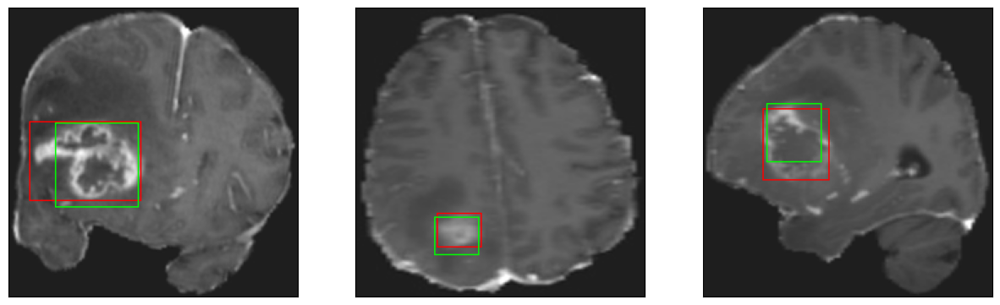

26/26 [==============================] - 3s 121ms/step - loss: 4.3152 - IoU: 0.6495 - val_loss: 9.2564 - val_IoU: 0.5298
Epoch 169/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8958 - IoU: 0.6781
Epoch 169: val_IoU did not improve from 0.55118
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


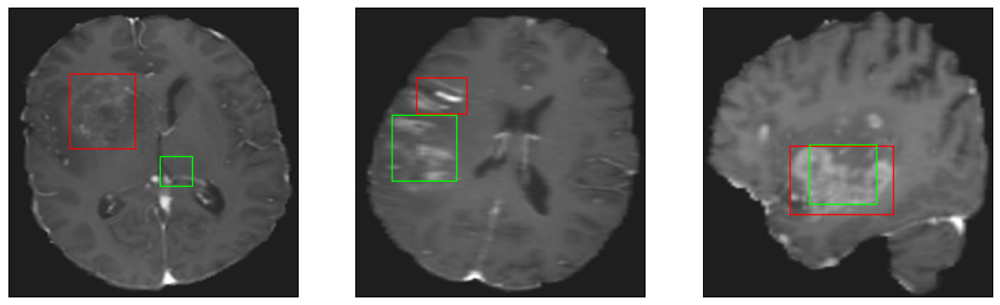

26/26 [==============================] - 3s 125ms/step - loss: 3.8904 - IoU: 0.6766 - val_loss: 10.2981 - val_IoU: 0.4825
Epoch 170/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3010 - IoU: 0.6454
Epoch 170: val_IoU did not improve from 0.55118
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


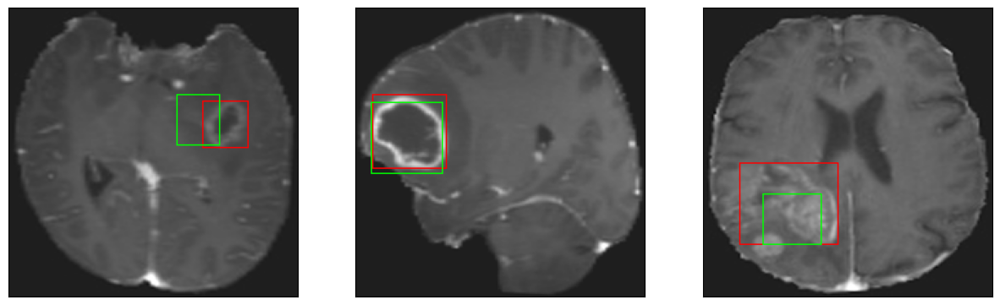

26/26 [==============================] - 3s 102ms/step - loss: 4.3815 - IoU: 0.6412 - val_loss: 10.4494 - val_IoU: 0.4691
Epoch 171/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2093 - IoU: 0.6545
Epoch 171: val_IoU did not improve from 0.55118
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


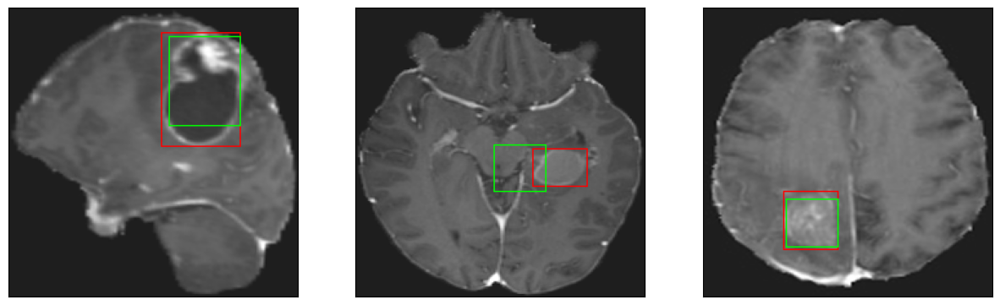

26/26 [==============================] - 3s 110ms/step - loss: 4.2036 - IoU: 0.6560 - val_loss: 9.4111 - val_IoU: 0.5226
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0280 - IoU: 0.6678
Epoch 172: val_IoU improved from 0.55118 to 0.55305, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


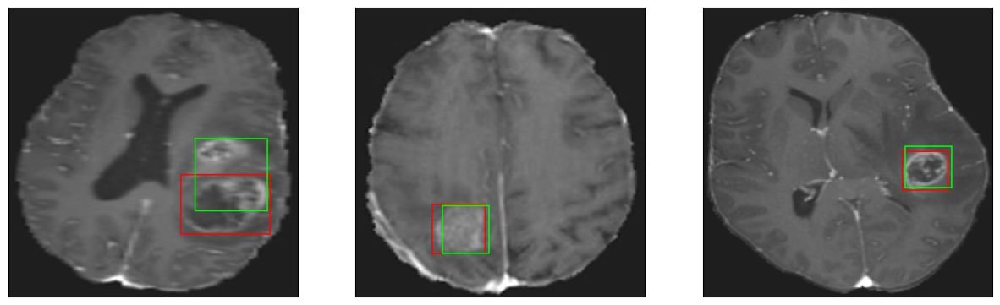

26/26 [==============================] - 4s 163ms/step - loss: 4.0898 - IoU: 0.6640 - val_loss: 8.8161 - val_IoU: 0.5531
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9555 - IoU: 0.6777
Epoch 173: val_IoU did not improve from 0.55305
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


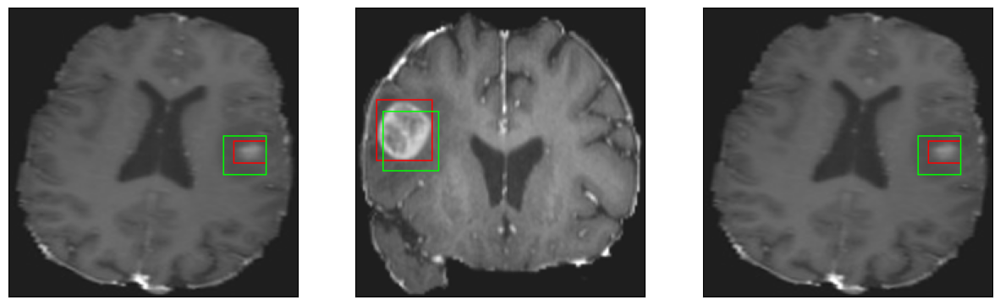

26/26 [==============================] - 3s 105ms/step - loss: 3.9478 - IoU: 0.6783 - val_loss: 9.9029 - val_IoU: 0.4899
Epoch 174/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0802 - IoU: 0.6650
Epoch 174: val_IoU did not improve from 0.55305
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


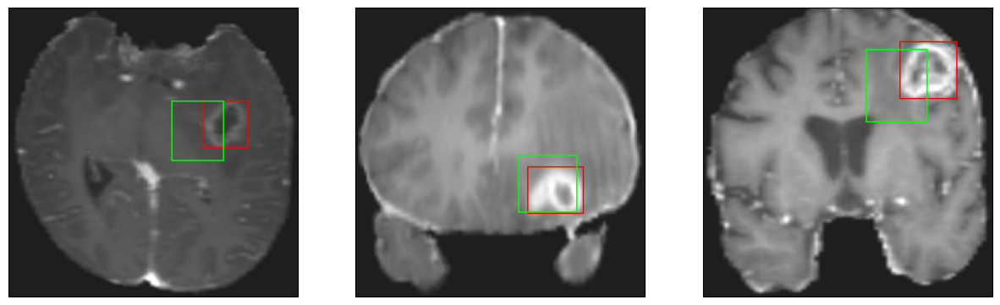

26/26 [==============================] - 3s 109ms/step - loss: 4.1224 - IoU: 0.6647 - val_loss: 9.2159 - val_IoU: 0.5480
Epoch 175/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9844 - IoU: 0.6673
Epoch 175: val_IoU did not improve from 0.55305
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4


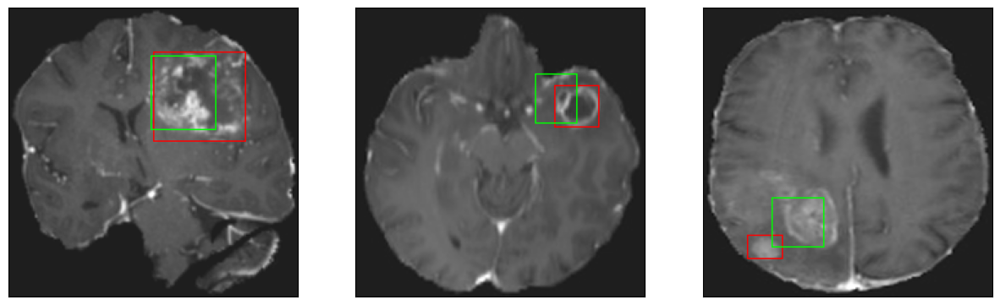

26/26 [==============================] - 3s 115ms/step - loss: 3.9750 - IoU: 0.6678 - val_loss: 10.0506 - val_IoU: 0.4785
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 4.0840 - IoU: 0.6678
Epoch 176: val_IoU did not improve from 0.55305
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


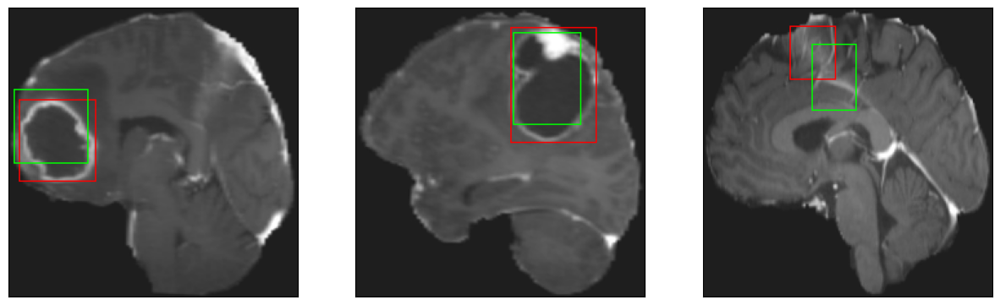

26/26 [==============================] - 3s 106ms/step - loss: 4.0840 - IoU: 0.6678 - val_loss: 10.7543 - val_IoU: 0.4548
Epoch 177/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0161 - IoU: 0.6657
Epoch 177: val_IoU did not improve from 0.55305
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


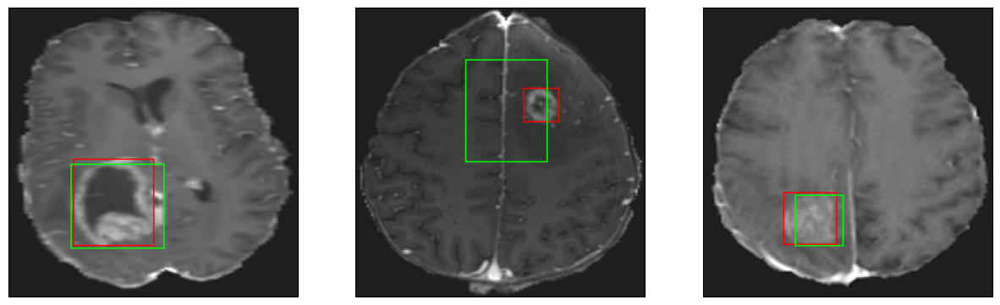

26/26 [==============================] - 3s 107ms/step - loss: 4.0044 - IoU: 0.6665 - val_loss: 10.8243 - val_IoU: 0.4764
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 4.0899 - IoU: 0.6687
Epoch 178: val_IoU did not improve from 0.55305
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


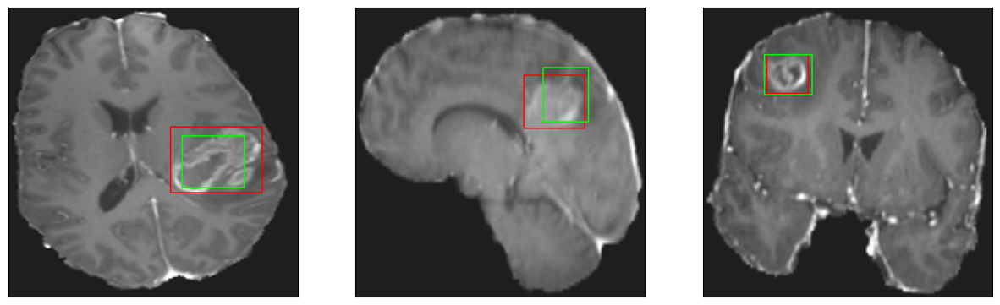

26/26 [==============================] - 3s 100ms/step - loss: 4.0899 - IoU: 0.6687 - val_loss: 8.8414 - val_IoU: 0.5493
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0184 - IoU: 0.6737
Epoch 179: val_IoU did not improve from 0.55305
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


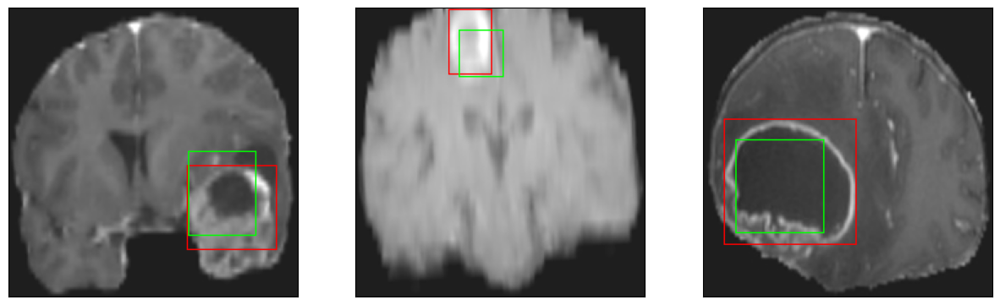

26/26 [==============================] - 3s 125ms/step - loss: 3.9935 - IoU: 0.6749 - val_loss: 8.9377 - val_IoU: 0.5333
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0630 - IoU: 0.6630
Epoch 180: val_IoU improved from 0.55305 to 0.55807, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


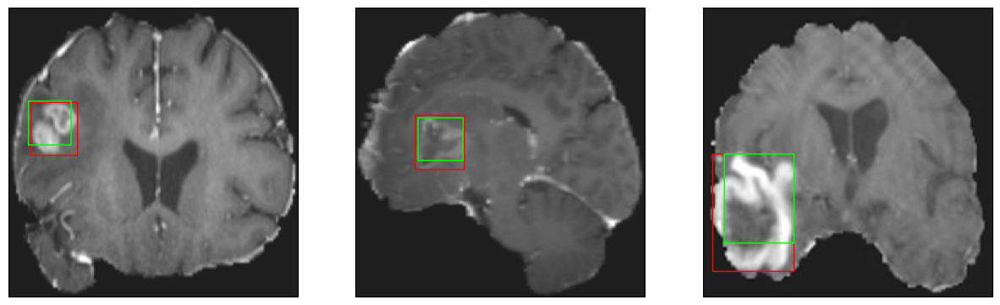

26/26 [==============================] - 4s 150ms/step - loss: 4.0780 - IoU: 0.6628 - val_loss: 8.6332 - val_IoU: 0.5581
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0501 - IoU: 0.6662
Epoch 181: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


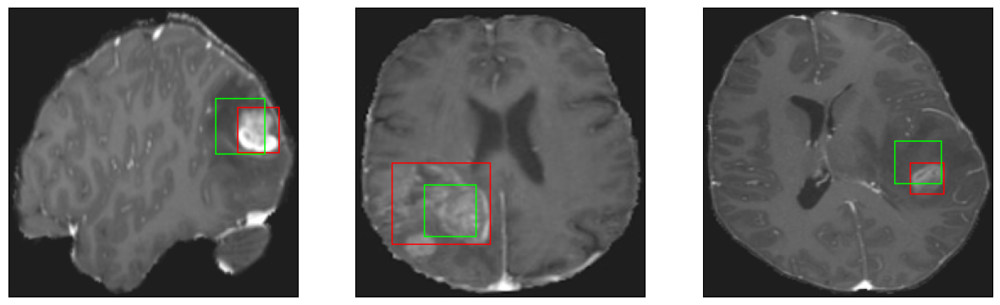

26/26 [==============================] - 3s 105ms/step - loss: 4.0353 - IoU: 0.6671 - val_loss: 9.2597 - val_IoU: 0.5326
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 3.9700 - IoU: 0.6783
Epoch 182: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


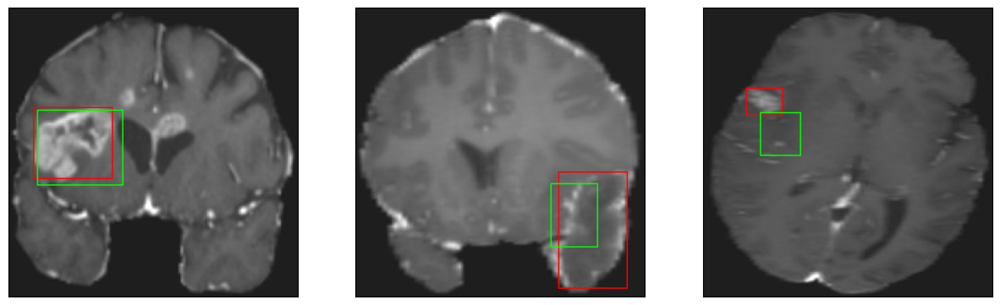

26/26 [==============================] - 3s 110ms/step - loss: 3.9700 - IoU: 0.6783 - val_loss: 10.9052 - val_IoU: 0.4325
Epoch 183/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0401 - IoU: 0.6734
Epoch 183: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


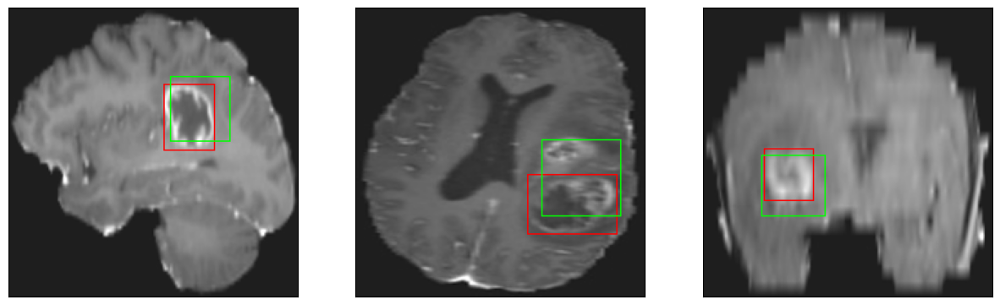

26/26 [==============================] - 3s 132ms/step - loss: 4.0923 - IoU: 0.6708 - val_loss: 9.5071 - val_IoU: 0.5093
Epoch 184/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8589 - IoU: 0.6783
Epoch 184: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


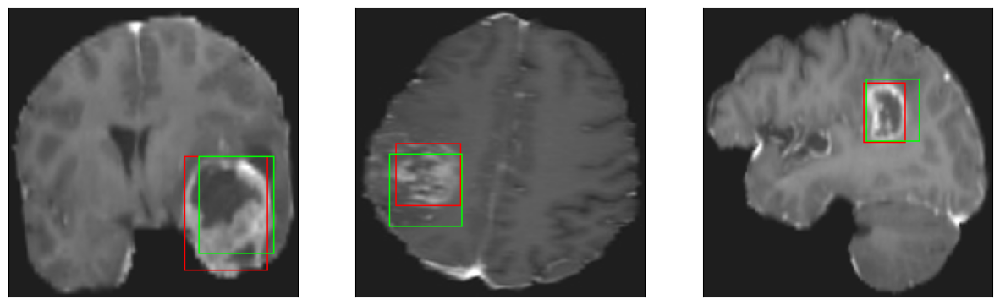

26/26 [==============================] - 3s 101ms/step - loss: 3.9704 - IoU: 0.6762 - val_loss: 9.2452 - val_IoU: 0.5256
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1934 - IoU: 0.6628
Epoch 185: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


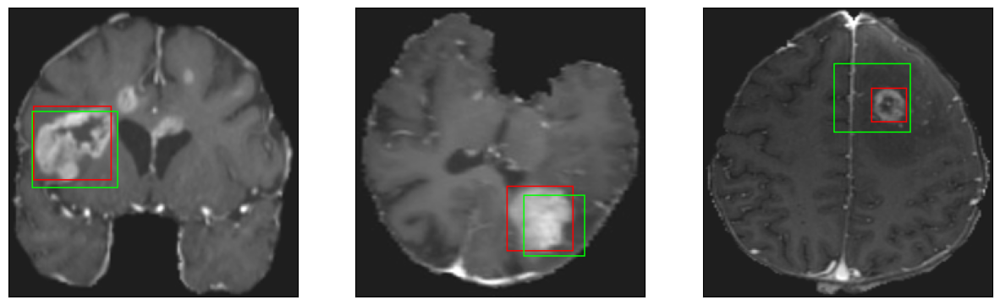

26/26 [==============================] - 3s 99ms/step - loss: 4.1622 - IoU: 0.6642 - val_loss: 9.2227 - val_IoU: 0.5092
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0674 - IoU: 0.6592
Epoch 186: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


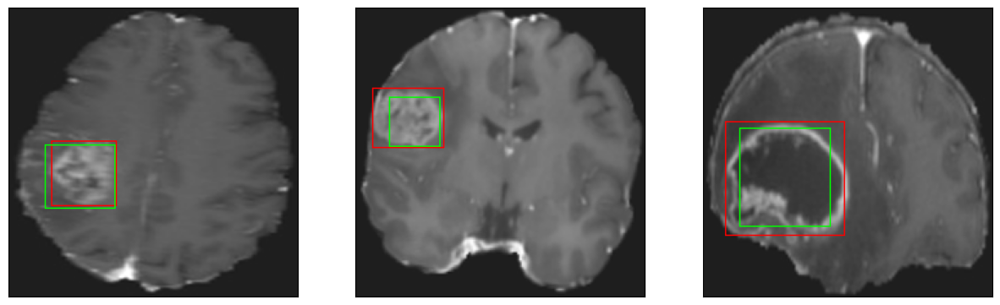

26/26 [==============================] - 3s 124ms/step - loss: 4.1400 - IoU: 0.6563 - val_loss: 9.1717 - val_IoU: 0.5301
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9419 - IoU: 0.6717
Epoch 187: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


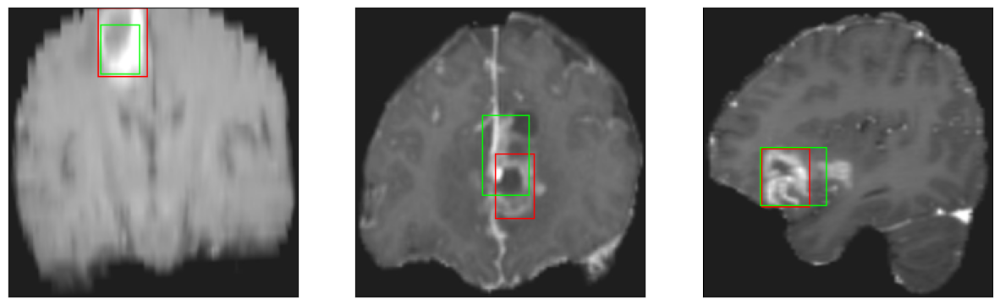

26/26 [==============================] - 3s 122ms/step - loss: 4.0079 - IoU: 0.6706 - val_loss: 10.2542 - val_IoU: 0.4814
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0923 - IoU: 0.6619
Epoch 188: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


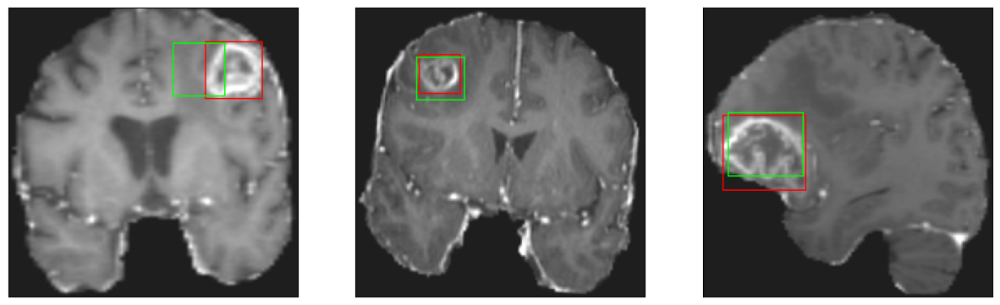

26/26 [==============================] - 3s 110ms/step - loss: 4.0664 - IoU: 0.6640 - val_loss: 10.1272 - val_IoU: 0.4880
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0095 - IoU: 0.6642
Epoch 189: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


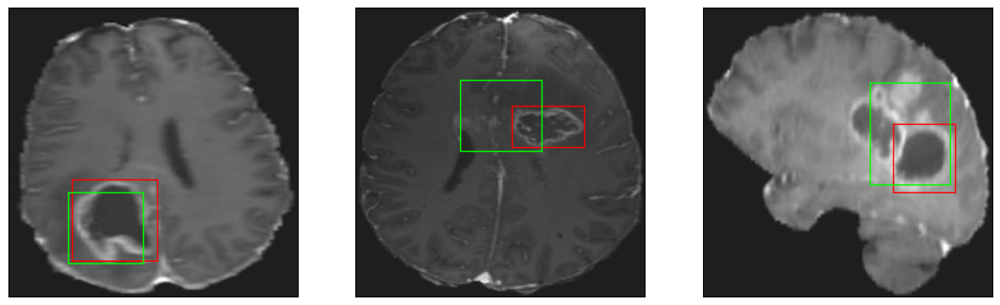

26/26 [==============================] - 3s 106ms/step - loss: 3.9920 - IoU: 0.6647 - val_loss: 9.4368 - val_IoU: 0.5295
Epoch 190/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9729 - IoU: 0.6779
Epoch 190: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


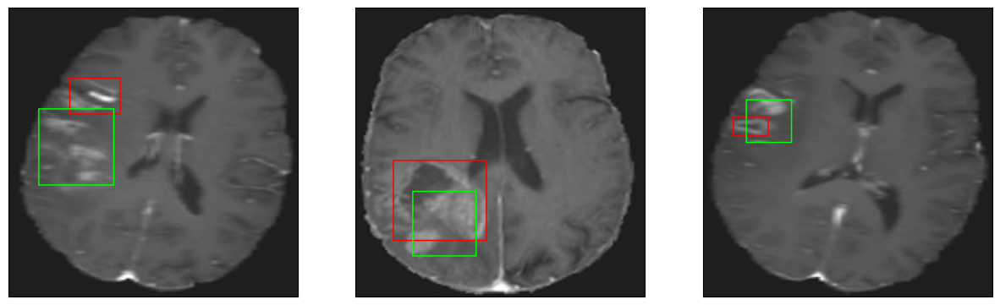

26/26 [==============================] - 3s 117ms/step - loss: 4.0252 - IoU: 0.6751 - val_loss: 8.9204 - val_IoU: 0.5456
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9683 - IoU: 0.6748
Epoch 191: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


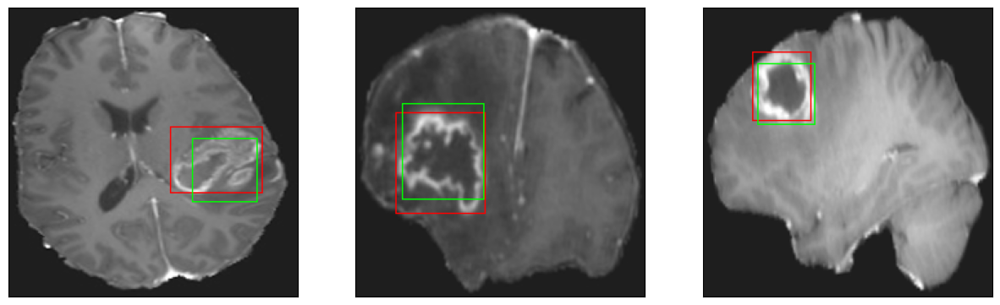

26/26 [==============================] - 3s 131ms/step - loss: 3.9772 - IoU: 0.6738 - val_loss: 9.3321 - val_IoU: 0.5125
Epoch 192/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0378 - IoU: 0.6648
Epoch 192: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


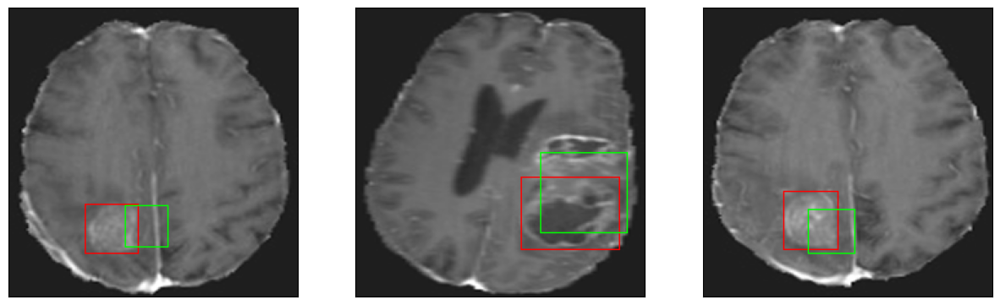

26/26 [==============================] - 3s 110ms/step - loss: 4.0310 - IoU: 0.6650 - val_loss: 10.0085 - val_IoU: 0.4613
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1812 - IoU: 0.6566
Epoch 193: val_IoU did not improve from 0.55807
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


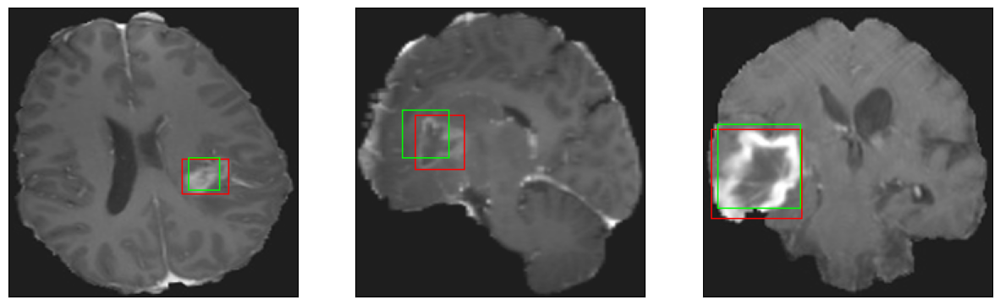

26/26 [==============================] - 3s 98ms/step - loss: 4.1968 - IoU: 0.6560 - val_loss: 10.0351 - val_IoU: 0.4933
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9804 - IoU: 0.6790
Epoch 194: val_IoU improved from 0.55807 to 0.56562, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


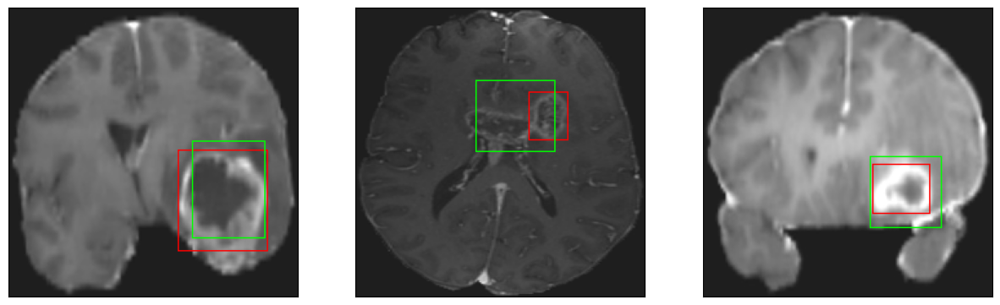

26/26 [==============================] - 4s 138ms/step - loss: 4.0013 - IoU: 0.6780 - val_loss: 8.5098 - val_IoU: 0.5656
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 3.9066 - IoU: 0.6825
Epoch 195: val_IoU did not improve from 0.56562
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


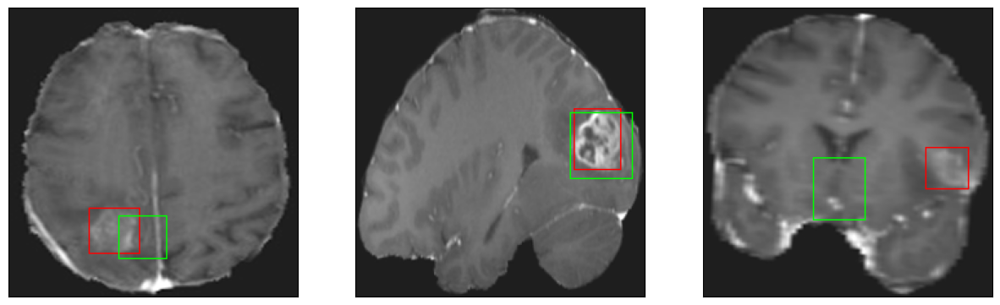

26/26 [==============================] - 3s 101ms/step - loss: 3.9101 - IoU: 0.6822 - val_loss: 9.2640 - val_IoU: 0.5269
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0308 - IoU: 0.6649
Epoch 196: val_IoU did not improve from 0.56562
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


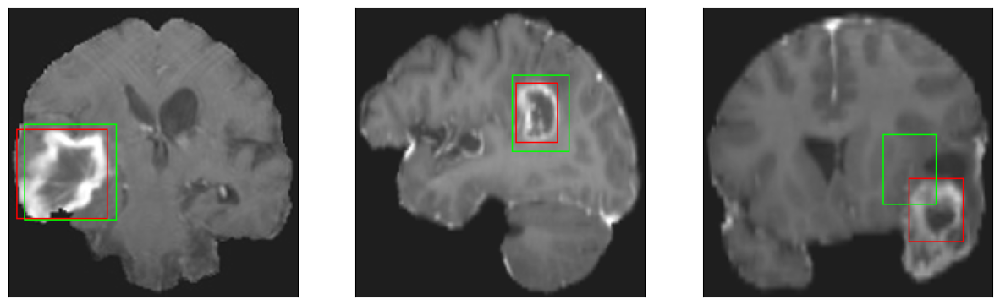

26/26 [==============================] - 3s 121ms/step - loss: 4.0268 - IoU: 0.6667 - val_loss: 12.6301 - val_IoU: 0.4324
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0848 - IoU: 0.6651
Epoch 197: val_IoU did not improve from 0.56562
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


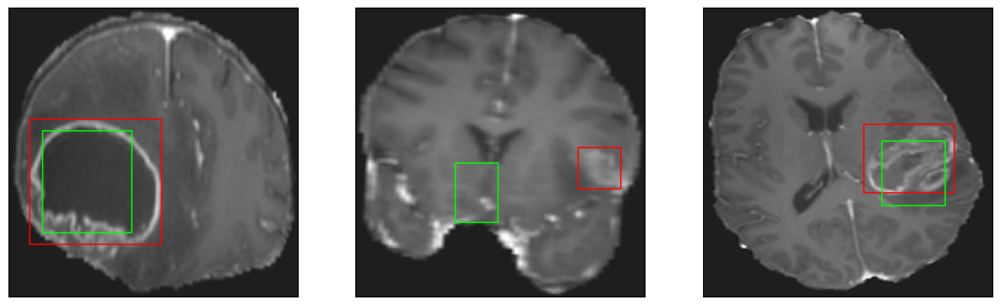

26/26 [==============================] - 3s 103ms/step - loss: 4.0531 - IoU: 0.6664 - val_loss: 9.3368 - val_IoU: 0.5329
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0147 - IoU: 0.6689
Epoch 198: val_IoU did not improve from 0.56562
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


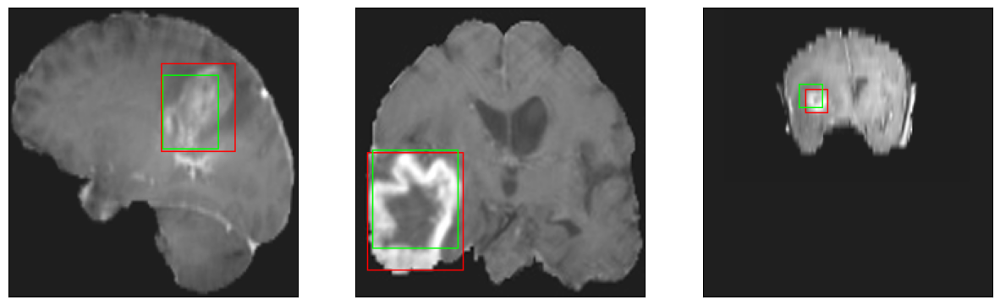

26/26 [==============================] - 3s 113ms/step - loss: 3.9823 - IoU: 0.6713 - val_loss: 9.3945 - val_IoU: 0.5320
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 3.8631 - IoU: 0.6733
Epoch 199: val_IoU did not improve from 0.56562
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


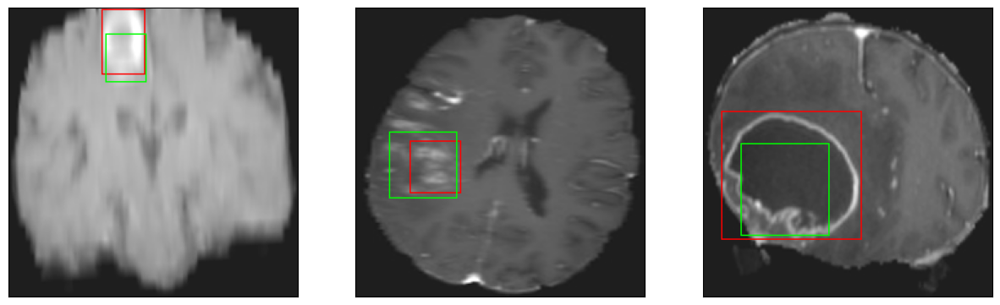

26/26 [==============================] - 3s 118ms/step - loss: 3.8631 - IoU: 0.6733 - val_loss: 9.0090 - val_IoU: 0.5419
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 3.8074 - IoU: 0.6800
Epoch 200: val_IoU did not improve from 0.56562
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


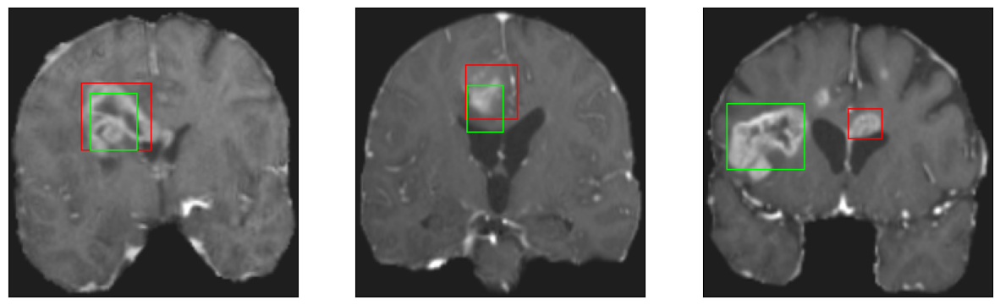

26/26 [==============================] - 3s 105ms/step - loss: 3.8689 - IoU: 0.6785 - val_loss: 9.2939 - val_IoU: 0.5411


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

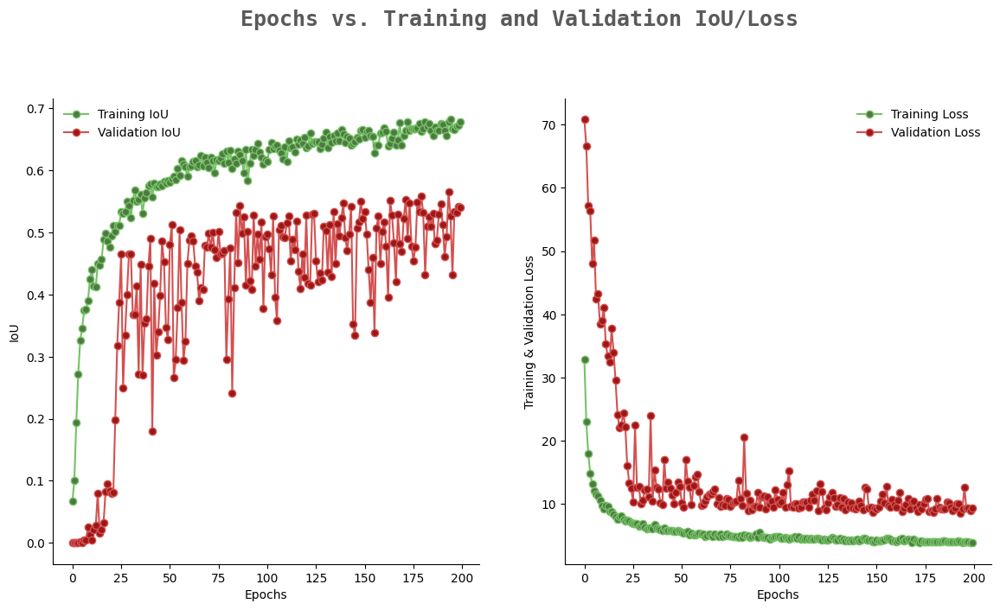

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 31ms/step - loss: 9.2731 - IoU: 0.5062


[9.27308177947998, 0.5062000751495361]